## CMS pNN
---

In [1]:
import os
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns

from script import utils, cms, hep
from script.utils import free_mem

from script.hep.data import BalancedSequence, UniformSequence
from script.models.layers import Divide, StandardScaler, Clip
from script.datasets import Benchmark

cms.plot.set_style()

In [2]:
# for debugging, comment if not needed
%load_ext autoreload
%autoreload 2

In [3]:
utils.set_random_seed(42)

Random seed 42 set.


In [4]:
# statistics
clip = hep.retrieve_clip(ranges=Benchmark.CLIP_RANGES, columns=Benchmark.FEATURES)
mean = hep.retrieve_stat(stats=Benchmark.STATS, which='mean', columns=Benchmark.FEATURES)
std = hep.retrieve_stat(stats=Benchmark.STATS, which='std', columns=Benchmark.FEATURES)

In [5]:
# preprocessing layers
preproc = dict(x=[Clip(min_value=clip[:, 0], max_value=clip[:, 1]),
                  StandardScaler(mean, std)],
               m=[Divide(value=1000.0)])

---
## Background's mA Distribution
Four Choices:
* **Different** (uniform): fixed or sampled;
* **Same**: fixed or sampled.

In [6]:
# load training data
data = Benchmark()
data.load(signal='data/benchmark/signal_bassociated_train.csv',
          bkg='data/benchmark/background_train.csv')

[signal] loading...
[background] loading...
dataset loaded.


In [7]:
# load test data
test = Benchmark()
test.load(signal='data/benchmark/signal_bassociated_test.csv',
          bkg='data/benchmark/background_test.csv')

[signal] loading...
[background] loading...
dataset loaded.


### Uniform (fixed)
* (general) without preprocessing **gradient's norm** starts to **explore!**

In [10]:
train, valid = cms.data.train_valid_split(data)

train = cms.data.SimpleEvalSequence(signal=train[0], background=train[1], batch_size=1024,
                                    features=data.columns['feature'], sample_mass=False,
                                    weight_column=None)

valid = cms.data.SimpleEvalSequence(signal=valid[0], background=valid[1], batch_size=1024,
                                    features=data.columns['feature'])

In [11]:
model, checkpoint = utils.get_compiled_pnn(data, save='benchmark/pnn-uniform-fixed', 
                                           lr=3e-4, dropout=0.25,
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [12]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 26/50
732/732 - 17s - loss: 0.5185 - binary_accuracy: 0.6747 - auc: 0.7165 - precision: 0.5965 - recall: 0.5509 - ams: 0.6621 - class-loss: 0.9645 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 3.2757 - weight-norm: 19.2166 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0367 - val_loss: 0.2755 - val_binary_accuracy: 0.8218 - val_auc: 0.9041 - val_precision: 0.7965 - val_recall: 0.7384 - val_ams: 0.7947
Epoch 27/50
732/732 - 14s - loss: 0.4387 - binary_accuracy: 0.7977 - auc: 0.8686 - precision: 0.7404 - recall: 0.7528 - ams: 0.7611 - class-loss: 0.4841 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.9438 - weight-norm: 18.8025 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0351 - val_loss: 0.2222 - val_binary_accuracy: 0.8366 - val_auc: 0.9162 - val_precision: 0.7898 - val_recall: 0.8000 - val_ams: 0.8016
Epoch 28/50
732/732 - 14s - loss: 0.4389 - binary_accuracy: 0.8322 - auc: 0.9049 - precision: 0.7798 - recall: 0.8027 - ams: 0.7952 - class-loss: 0.4223 - fool-lo

In [13]:
utils.load_from_checkpoint(model, path='benchmark/pnn-uniform-fixed')

Loaded from "weights\benchmark/pnn-uniform-fixed\weights-21-0.973"


with Preprocessing:

In [10]:
model, checkpoint = utils.get_compiled_pnn(data, save='benchmark/pnn-uniform-fixed-preproc', 
                                           lr=3e-4, dropout=0.25, preprocess=preproc,
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [15]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 26/50
732/732 - 18s - loss: 0.2277 - binary_accuracy: 0.8865 - auc: 0.9514 - precision: 0.8538 - recall: 0.8604 - ams: 0.8599 - class-loss: 0.3131 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.1815 - weight-norm: 19.2451 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0368 - val_loss: 0.1373 - val_binary_accuracy: 0.9088 - val_auc: 0.9675 - val_precision: 0.8744 - val_recall: 0.8987 - val_ams: 0.8868
Epoch 27/50
732/732 - 15s - loss: 0.2027 - binary_accuracy: 0.9142 - auc: 0.9698 - precision: 0.8841 - recall: 0.9016 - ams: 0.8939 - class-loss: 0.2449 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.2050 - weight-norm: 17.2378 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0294 - val_loss: 0.1199 - val_binary_accuracy: 0.9176 - val_auc: 0.9726 - val_precision: 0.8845 - val_recall: 0.9106 - val_ams: 0.8977
Epoch 28/50
732/732 - 14s - loss: 0.2408 - binary_accuracy: 0.9208 - auc: 0.9738 - precision: 0.8914 - recall: 0.9108 - ams: 0.9019 - class-loss: 0.2242 - fool-lo

In [12]:
utils.load_from_checkpoint(model, path='benchmark/uniform-fixed/pnn-preproc')

Loaded from "weights\benchmark/uniform-fixed/pnn-preproc\weights-50-0.982"


### Uniform (sampled)

In [8]:
train, valid = cms.data.UniformSequence.get_data(data)

In [9]:
l2_kernel = tf.keras.regularizers.l2(1e-4)
l2_bias = tf.keras.regularizers.l2(1e-5)

model, checkpoint = utils.get_compiled_pnn(data, save='benchmark/uniform-sampled/pnn',
                                           kernel_regularizer=l2_kernel,
                                           bias_regularizer=l2_bias,
                                           dropout=0.25, lr=3e-4)

In [10]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
732/732 - 18s - loss: 0.4894 - binary_accuracy: 0.6937 - auc: 0.7367 - precision: 0.6209 - recall: 0.5807 - ams: 0.6733 - class-loss: 0.9130 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 2.7177 - weight-norm: 19.0896 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0363 - val_loss: 0.2620 - val_binary_accuracy: 0.8322 - val_auc: 0.9079 - val_precision: 0.7697 - val_recall: 0.8220 - val_ams: 0.8001
Epoch 2/50
732/732 - 15s - loss: 0.4075 - binary_accuracy: 0.8032 - auc: 0.8752 - precision: 0.7478 - recall: 0.7590 - ams: 0.7679 - class-loss: 0.4725 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.9373 - weight-norm: 18.5756 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0342 - val_loss: 0.2143 - val_binary_accuracy: 0.8402 - val_auc: 0.9196 - val_precision: 0.7852 - val_recall: 0.8209 - val_ams: 0.8073
Epoch 3/50
732/732 - 15s - loss: 0.3714 - binary_accuracy: 0.8353 - auc: 0.9079 - precision: 0.7852 - recall: 0.8037 - ams: 0.7986 - class-loss: 0.4149 - fool-loss:

In [11]:
utils.load_from_checkpoint(model, path='benchmark/uniform-sampled/pnn')

Loaded from "weights\benchmark/uniform-sampled/pnn\weights-48-0.975"


with Preprocessing:

In [12]:
del train, valid, model, checkpoint
free_mem()

train, valid = cms.data.UniformSequence.get_data(data)

In [13]:
l2_kernel = tf.keras.regularizers.l2(1e-4)
l2_bias = tf.keras.regularizers.l2(1e-5)

model, checkpoint = utils.get_compiled_pnn(data, save='benchmark/uniform-sampled/pnn-preproc',
                                           kernel_regularizer=l2_kernel, lr=3e-4,
                                           bias_regularizer=l2_bias,
                                           dropout=0.25, preprocess=preproc)

In [14]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
732/732 - 17s - loss: 0.2568 - binary_accuracy: 0.8858 - auc: 0.9510 - precision: 0.8534 - recall: 0.8590 - ams: 0.8589 - class-loss: 0.3142 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.1801 - weight-norm: 19.2634 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0369 - val_loss: 0.1339 - val_binary_accuracy: 0.9078 - val_auc: 0.9671 - val_precision: 0.8698 - val_recall: 0.9022 - val_ams: 0.8858
Epoch 2/50
732/732 - 15s - loss: 0.2216 - binary_accuracy: 0.9139 - auc: 0.9696 - precision: 0.8834 - recall: 0.9014 - ams: 0.8932 - class-loss: 0.2458 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.2030 - weight-norm: 17.2513 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0294 - val_loss: 0.1166 - val_binary_accuracy: 0.9172 - val_auc: 0.9725 - val_precision: 0.8806 - val_recall: 0.9148 - val_ams: 0.8976
Epoch 3/50
732/732 - 14s - loss: 0.2102 - binary_accuracy: 0.9205 - auc: 0.9737 - precision: 0.8907 - recall: 0.9111 - ams: 0.9015 - class-loss: 0.2247 - fool-loss:

In [15]:
utils.load_from_checkpoint(model, path='benchmark/uniform-sampled/pnn-preproc')

Loaded from "weights\benchmark/uniform-sampled/pnn-preproc\weights-45-0.983"


#### Evaluation (uniform)

In [8]:
# load test data
test = Benchmark()
test.load(signal='data/benchmark/signal_bassociated_test.csv',
          bkg='data/benchmark/background_test.csv')

[signal] loading...
[background] loading...
dataset loaded.


In [17]:
# load models
fixed = utils.get_compiled_pnn(test, dropout=0.25)
utils.load_from_checkpoint(fixed, path='benchmark/uniform-fixed/pnn')

sampled = utils.get_compiled_pnn(test, dropout=0.25)
utils.load_from_checkpoint(sampled, path='benchmark/uniform-sampled/pnn')

fix_pre = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(fix_pre, path='benchmark/uniform-fixed/pnn-preproc')

sam_pre = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(sam_pre, path='benchmark/uniform-sampled/pnn-preproc')

Loaded from "weights\benchmark/uniform-fixed/pnn\weights-48-0.972"
Loaded from "weights\benchmark/uniform-sampled/pnn\weights-48-0.975"
Loaded from "weights\benchmark/uniform-fixed/pnn-preproc\weights-48-0.982"
Loaded from "weights\benchmark/uniform-sampled/pnn-preproc\weights-45-0.983"


In [18]:
models = {'fixed': fixed, 'sampled': sampled, 'fixed + preproc': fix_pre, 'sampled + preproc': sam_pre}

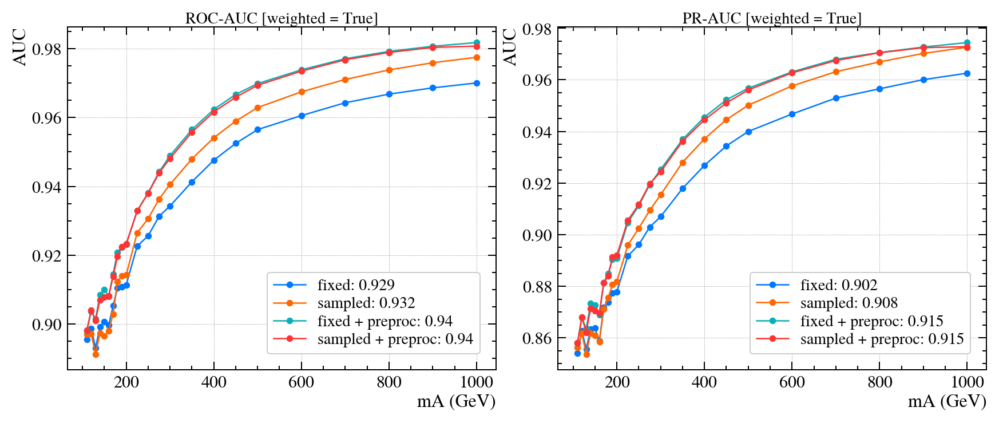

In [ ]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, intervals=test.default_intervals, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, intervals=test.default_intervals, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

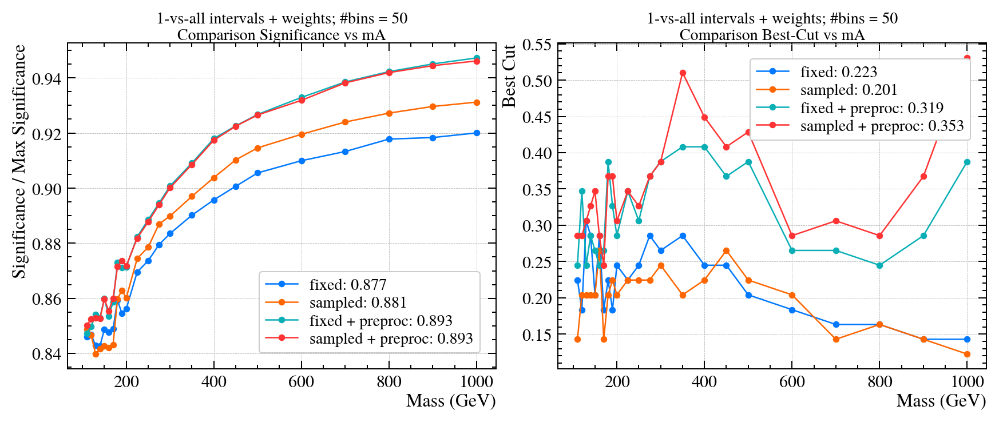

In [20]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='1-vs-all intervals + weights',
                                    intervals=test.default_intervals)

### Same (fixed)
Is nonsense, since the background's mass distribution everytime only overlaps partially with each signals.

In [131]:
# replaces the (default) uniform mA
data.background['mA'] = np.random.choice(data.unique_signal_mass, size=len(data.background))

In [132]:
train, valid = cms.data.train_valid_split(data)

train = cms.data.SimpleEvalSequence(signal=train[0], background=train[1], batch_size=1024,
                                    features=data.columns['feature'], sample_mass=False,
                                    weight_column=None)

valid = cms.data.SimpleEvalSequence(signal=valid[0], background=valid[1], batch_size=1024,
                                    features=data.columns['feature'])

In [133]:
model, checkpoint = utils.get_compiled_pnn(data, save='benchmark/pnn-same-fixed', 
                                           lr=3e-4, dropout=0.25,
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [134]:
# TODO: train more
model.fit(x=train, epochs=25, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/25
732/732 - 19s - loss: 0.4860 - binary_accuracy: 0.7394 - auc: 0.7939 - precision: 0.6580 - recall: 0.7115 - ams: 0.7178 - class-loss: 0.8703 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 3.4008 - weight-norm: 19.5725 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0381 - val_loss: 0.2364 - val_binary_accuracy: 0.8215 - val_auc: 0.8996 - val_precision: 0.7246 - val_recall: 0.8859 - val_ams: 0.8012
Epoch 2/25
732/732 - 16s - loss: 0.4406 - binary_accuracy: 0.8216 - auc: 0.8922 - precision: 0.7502 - recall: 0.8237 - ams: 0.7927 - class-loss: 0.4475 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.8079 - weight-norm: 19.0541 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0361 - val_loss: 0.1998 - val_binary_accuracy: 0.8523 - val_auc: 0.9277 - val_precision: 0.7853 - val_recall: 0.8627 - val_ams: 0.8235
Epoch 3/25
732/732 - 14s - loss: 0.3749 - binary_accuracy: 0.8488 - auc: 0.9190 - precision: 0.7882 - recall: 0.8452 - ams: 0.8178 - class-loss: 0.3966 - fool-loss:

In [135]:
utils.load_from_checkpoint(model, path='benchmark/pnn-same-fixed')

Loaded from "weights\benchmark/pnn-same-fixed\weights-24-0.980"


### Same (sampled)
Samples the background's mA from the signal's mA. Various choices:
* **1-vs-all**: every background event can be assigned each signal's mA.
* **intervals**: mA assignment is done within a mass interval, so different intervals may result in different mA assignments. So compare: (1) `disjoint_intervals`, and (2) `overlapping_intervals`.
  

1-vs-all:

In [20]:
free_mem()

train, valid = cms.data.OneVsAllSequence.get_data(data)

In [21]:
l2_kernel = tf.keras.regularizers.l2(1e-4)
l2_bias = tf.keras.regularizers.l2(1e-5)

model, checkpoint = utils.get_compiled_pnn(data, save='benchmark/same-sampled/pnn',
                                           kernel_regularizer=l2_kernel,
                                           bias_regularizer=l2_bias,
                                           dropout=0.25, lr=3e-4)

In [22]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
732/732 - 18s - loss: 0.4159 - binary_accuracy: 0.7619 - auc: 0.8196 - precision: 0.6913 - recall: 0.7200 - ams: 0.7351 - class-loss: 0.7747 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 2.5907 - weight-norm: 19.0817 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0362 - val_loss: 0.2557 - val_binary_accuracy: 0.8389 - val_auc: 0.9136 - val_precision: 0.7560 - val_recall: 0.8754 - val_ams: 0.8151
Epoch 2/50
732/732 - 14s - loss: 0.3526 - binary_accuracy: 0.8331 - auc: 0.9046 - precision: 0.7683 - recall: 0.8283 - ams: 0.8028 - class-loss: 0.4225 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.8368 - weight-norm: 18.4002 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0336 - val_loss: 0.2034 - val_binary_accuracy: 0.8566 - val_auc: 0.9323 - val_precision: 0.7959 - val_recall: 0.8578 - val_ams: 0.8283
Epoch 3/50
732/732 - 14s - loss: 0.3331 - binary_accuracy: 0.8556 - auc: 0.9265 - precision: 0.8012 - recall: 0.8447 - ams: 0.8246 - class-loss: 0.3754 - fool-loss:

In [23]:
utils.load_from_checkpoint(model, path='benchmark/same-sampled/pnn')

Loaded from "weights\benchmark/same-sampled/pnn\weights-50-0.982"


Disjoint intervals:

In [29]:
train, valid = cms.data.IntervalSequence.get_data(data, intervals=data.DISJOINT_INTERVALS)

In [25]:
model, checkpoint = utils.get_compiled_pnn(data, save='benchmark/same-sampled/pnn-interval_disjoint',
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5),
                                           dropout=0.25, lr=3e-4)

In [30]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
719/719 - 18s - loss: 0.2431 - binary_accuracy: 0.9010 - auc: 0.9539 - precision: 0.8581 - recall: 0.9041 - ams: 0.8816 - class-loss: 0.3794 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 1.6520 - weight-norm: 19.1311 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0364 - val_loss: 0.1405 - val_binary_accuracy: 0.7665 - val_auc: 0.8498 - val_precision: 0.6433 - val_recall: 0.9206 - val_ams: 0.7703
Epoch 2/50
719/719 - 14s - loss: 0.2223 - binary_accuracy: 0.9329 - auc: 0.9793 - precision: 0.9119 - recall: 0.9227 - ams: 0.9175 - class-loss: 0.2160 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.5227 - weight-norm: 18.2826 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0331 - val_loss: 0.1384 - val_binary_accuracy: 0.7844 - val_auc: 0.8590 - val_precision: 0.6705 - val_recall: 0.8950 - val_ams: 0.7776
Epoch 3/50
719/719 - 14s - loss: 0.2126 - binary_accuracy: 0.9383 - auc: 0.9822 - precision: 0.9239 - recall: 0.9231 - ams: 0.9235 - class-loss: 0.1988 - fool-loss:

In [33]:
utils.load_from_checkpoint(model, path='benchmark/same-sampled/pnn-interval_disjoint')

Loaded from "weights\benchmark/same-sampled/pnn-interval_disjoint\weights-21-0.899"


Overlapping Intervals:

In [34]:
del train, valid, model, checkpoint
free_mem()

train, valid = cms.data.IntervalSequence.get_data(data, intervals=data.INTERVALS)

In [35]:
model, checkpoint = utils.get_compiled_pnn(data, save='benchmark/same-sampled/pnn-interval_overlap',
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5),
                                           dropout=0.25, lr=3e-4)

In [36]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
1245/1245 - 27s - loss: 0.2598 - binary_accuracy: 0.8968 - auc: 0.9301 - precision: 0.7690 - recall: 0.7957 - ams: 0.7842 - class-loss: 0.4306 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 1.8195 - weight-norm: 18.9693 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0358 - val_loss: 0.2080 - val_binary_accuracy: 0.8021 - val_auc: 0.8713 - val_precision: 0.7064 - val_recall: 0.8555 - val_ams: 0.7882
Epoch 2/50
1245/1245 - 24s - loss: 0.2311 - binary_accuracy: 0.9277 - auc: 0.9682 - precision: 0.8476 - recall: 0.8408 - ams: 0.8457 - class-loss: 0.2249 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.5054 - weight-norm: 18.0760 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0322 - val_loss: 0.2083 - val_binary_accuracy: 0.8248 - val_auc: 0.8990 - val_precision: 0.7552 - val_recall: 0.8249 - val_ams: 0.7999
Epoch 3/50
1245/1245 - 23s - loss: 0.2090 - binary_accuracy: 0.9339 - auc: 0.9736 - precision: 0.8585 - recall: 0.8575 - ams: 0.8594 - class-loss: 0.2031 - fool

In [37]:
utils.load_from_checkpoint(model, path='benchmark/same-sampled/pnn-interval_overlap')

Loaded from "weights\benchmark/same-sampled/pnn-interval_overlap\weights-38-0.934"


Evaluation:

In [39]:
# load models
one_vs_all = utils.get_compiled_pnn(test, dropout=0.25)
utils.load_from_checkpoint(one_vs_all, path='benchmark/same-fixed/pnn')

disjoint = utils.get_compiled_pnn(test, dropout=0.25)
utils.load_from_checkpoint(disjoint, path='benchmark/same-sampled/pnn-interval_disjoint')

overlap = utils.get_compiled_pnn(test, dropout=0.25)
utils.load_from_checkpoint(model, path='benchmark/same-sampled/pnn-interval_overlap')

Loaded from "weights\benchmark/pnn-same-fixed\weights-24-0.980"
Loaded from "weights\benchmark/same-sampled/pnn-interval_disjoint\weights-21-0.899"
Loaded from "weights\benchmark/same-sampled/pnn-interval_overlap\weights-38-0.934"


In [40]:
models = {'1-vs-all': one_vs_all, 'i-disjoint': disjoint, 'i-overlap': overlap}

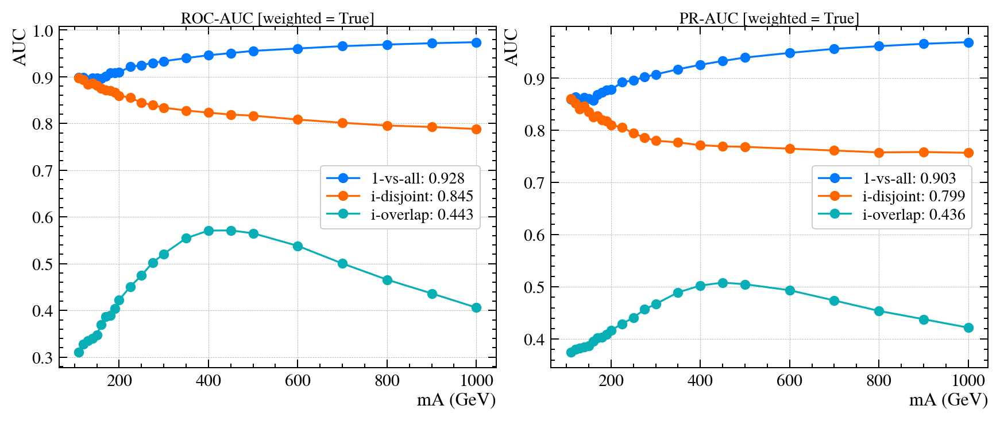

In [41]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

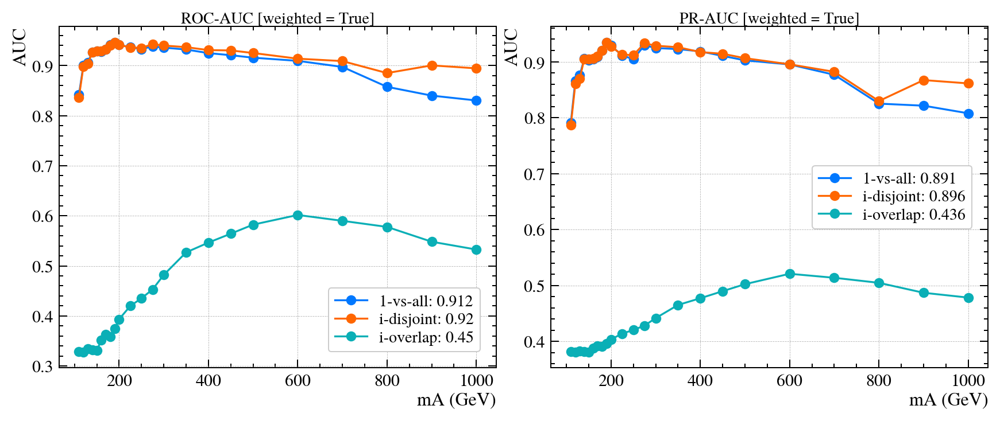

In [42]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC', intervals=test.INTERVALS)
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR', intervals=test.INTERVALS)

plt.tight_layout()
plt.show()

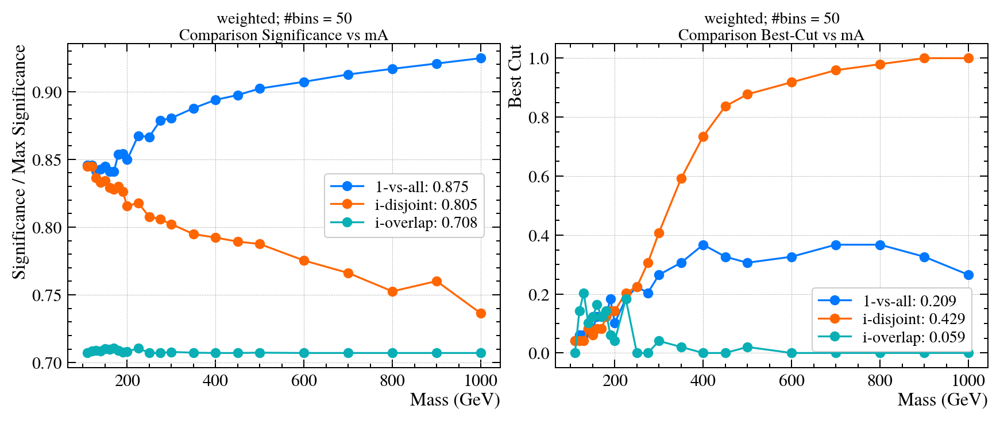

In [43]:
cms.plot.significance_ratio_vs_mass(test, models, title='weighted')

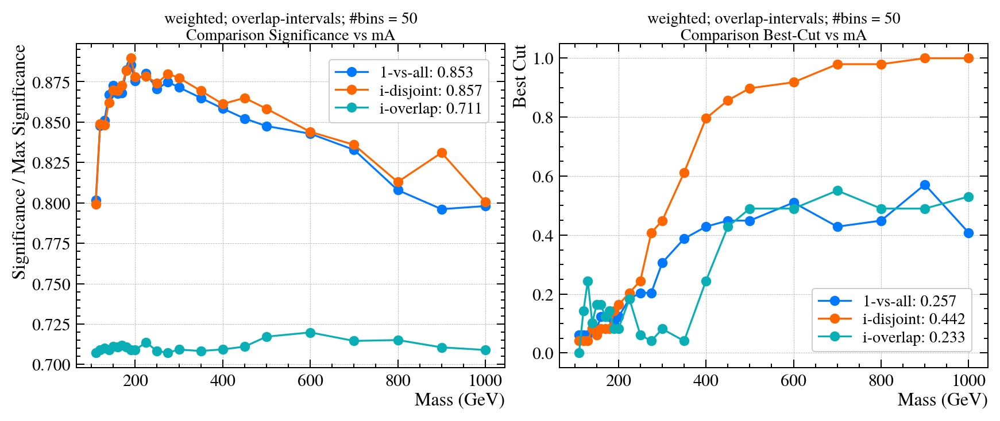

In [44]:
cms.plot.significance_ratio_vs_mass(test, models, intervals=test.INTERVALS, 
                                    title='weighted; overlap-intervals')

---
## Balaced Training
* **Class balance:** i.e. batches contain 50% signal and 50% background, regardless of both mA and process.
* **mA balance:** balanced batches + each batch contains all mA in equal quantity of examples, per-class.
* **Bkg balance:** balanced batched + each batch contains all background processes in equal number of examples.
* **Full balance:** class + mA + bkg batch-balancing.

In [137]:
# load training data
data = Benchmark()
data.load(signal='data/benchmark/signal_bassociated_train.csv',
          bkg='data/benchmark/background_train.csv')

[signal] loading...
[background] loading...
dataset loaded.


In [7]:
# load test data
test = Benchmark()
test.load(signal='data/benchmark/signal_bassociated_test.csv',
          bkg='data/benchmark/background_test.csv')

[signal] loading...
[background] loading...
dataset loaded.


### Uniform
* Can only *balance signal mA* or *bkg* processes.

#### Class (batch) balancing
Fixed:

In [45]:
del train, valid, model, models, checkpoint
free_mem()

train, valid = cms.data.BalancedUniformSequence.get_data(data, balance_signal=False, 
                                                         balance_bkg=False)

In [46]:
model, checkpoint = utils.get_compiled_pnn(data, save='benchmark/uniform-fixed/pnn-class_balance', 
                                           lr=3e-4, dropout=0.25,
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [47]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
976/976 - 16s - loss: 0.4739 - binary_accuracy: 0.7013 - auc: 0.7456 - precision: 0.6243 - recall: 0.6357 - ams: 0.6822 - class-loss: 0.8943 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 3.0905 - weight-norm: 19.0129 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0359 - val_loss: 0.2298 - val_binary_accuracy: 0.8327 - val_auc: 0.9066 - val_precision: 0.7418 - val_recall: 0.8857 - val_ams: 0.8106
Epoch 2/50
976/976 - 14s - loss: 0.4133 - binary_accuracy: 0.8096 - auc: 0.8821 - precision: 0.7547 - recall: 0.7764 - ams: 0.7752 - class-loss: 0.4612 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 1.1300 - weight-norm: 18.5816 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0341 - val_loss: 0.1861 - val_binary_accuracy: 0.8445 - val_auc: 0.9228 - val_precision: 0.7748 - val_recall: 0.8562 - val_ams: 0.8149
Epoch 3/50
976/976 - 14s - loss: 0.3535 - binary_accuracy: 0.8401 - auc: 0.9117 - precision: 0.7987 - recall: 0.8026 - ams: 0.8056 - class-loss: 0.4067 - fool-loss:

In [48]:
utils.load_from_checkpoint(model, path='benchmark/uniform-fixed/pnn-class_balance')

Loaded from "weights\benchmark/uniform-fixed/pnn-class_balance\weights-36-0.972"


Sampled:

In [49]:
train, valid = cms.data.BalancedUniformSequence.get_data(data, balance_signal=False,
                                                         balance_bkg=False, sample_mass=True)

In [50]:
model, checkpoint = utils.get_compiled_pnn(data, save='benchmark/uniform-sampled/pnn-class_balance', 
                                           lr=3e-4, dropout=0.25,
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [51]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
976/976 - 16s - loss: 0.4754 - binary_accuracy: 0.7075 - auc: 0.7554 - precision: 0.6451 - recall: 0.5974 - ams: 0.6866 - class-loss: 0.8671 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 2.8929 - weight-norm: 19.1850 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0366 - val_loss: 0.2419 - val_binary_accuracy: 0.8382 - val_auc: 0.9126 - val_precision: 0.7899 - val_recall: 0.8053 - val_ams: 0.8054
Epoch 2/50
976/976 - 14s - loss: 0.4191 - binary_accuracy: 0.8149 - auc: 0.8865 - precision: 0.7620 - recall: 0.7814 - ams: 0.7807 - class-loss: 0.4566 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 1.1360 - weight-norm: 18.8746 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0353 - val_loss: 0.1936 - val_binary_accuracy: 0.8498 - val_auc: 0.9291 - val_precision: 0.7893 - val_recall: 0.8466 - val_ams: 0.8181
Epoch 3/50
976/976 - 15s - loss: 0.3790 - binary_accuracy: 0.8446 - auc: 0.9153 - precision: 0.7976 - recall: 0.8196 - ams: 0.8107 - class-loss: 0.4026 - fool-loss:

In [52]:
utils.load_from_checkpoint(model, path='benchmark/uniform-sampled/pnn-class_balance')

Loaded from "weights\benchmark/uniform-sampled/pnn-class_balance\weights-48-0.976"


#### Signal balancing
Fixed:

In [53]:
del train, valid, model, checkpoint
free_mem()

train, valid = cms.data.BalancedUniformSequence.get_data(data, balance_bkg=False)

In [54]:
model, checkpoint = utils.get_compiled_pnn(data, save='benchmark/uniform-fixed/pnn-signal_balance', 
                                           lr=3e-4, dropout=0.25,
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [55]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
988/988 - 21s - loss: 0.4203 - binary_accuracy: 0.7309 - auc: 0.7881 - precision: 0.7812 - recall: 0.7354 - ams: 0.7990 - class-loss: 0.7597 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 2.2321 - weight-norm: 19.1843 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0365 - val_loss: 0.2143 - val_binary_accuracy: 0.8010 - val_auc: 0.8670 - val_precision: 0.7070 - val_recall: 0.8494 - val_ams: 0.7760
Epoch 2/50
988/988 - 19s - loss: 0.3869 - binary_accuracy: 0.8533 - auc: 0.9256 - precision: 0.8612 - recall: 0.8862 - ams: 0.8747 - class-loss: 0.3814 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 1.0701 - weight-norm: 18.7414 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0346 - val_loss: 0.1946 - val_binary_accuracy: 0.8047 - val_auc: 0.8775 - val_precision: 0.7140 - val_recall: 0.8453 - val_ams: 0.7792
Epoch 3/50
988/988 - 20s - loss: 0.3467 - binary_accuracy: 0.8709 - auc: 0.9389 - precision: 0.8767 - recall: 0.9010 - ams: 0.8891 - class-loss: 0.3470 - fool-loss:

In [56]:
utils.load_from_checkpoint(model, path='benchmark/uniform-fixed/pnn-signal_balance')

Loaded from "weights\benchmark/uniform-fixed/pnn-signal_balance\weights-36-0.949"


Sampled:

In [57]:
del train, valid, model, checkpoint
free_mem()

train, valid = cms.data.BalancedUniformSequence.get_data(data, balance_bkg=False,
                                                         sample_mass=True)

In [58]:
model, checkpoint = utils.get_compiled_pnn(data, save='benchmark/uniform-sampled/pnn-signal_balance', 
                                           lr=3e-4, dropout=0.25,
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [59]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
988/988 - 21s - loss: 0.3913 - binary_accuracy: 0.7249 - auc: 0.7768 - precision: 0.7683 - recall: 0.7428 - ams: 0.7944 - class-loss: 0.7547 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 2.3611 - weight-norm: 19.1884 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0365 - val_loss: 0.1669 - val_binary_accuracy: 0.7915 - val_auc: 0.8692 - val_precision: 0.6813 - val_recall: 0.8894 - val_ams: 0.7807
Epoch 2/50
988/988 - 18s - loss: 0.3411 - binary_accuracy: 0.8532 - auc: 0.9254 - precision: 0.8630 - recall: 0.8834 - ams: 0.8746 - class-loss: 0.3818 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 1.1375 - weight-norm: 18.8317 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0349 - val_loss: 0.1568 - val_binary_accuracy: 0.8017 - val_auc: 0.8813 - val_precision: 0.6995 - val_recall: 0.8748 - val_ams: 0.7823
Epoch 3/50
988/988 - 17s - loss: 0.3592 - binary_accuracy: 0.8709 - auc: 0.9392 - precision: 0.8800 - recall: 0.8965 - ams: 0.8892 - class-loss: 0.3462 - fool-loss:

In [60]:
utils.load_from_checkpoint(model, path='benchmark/uniform-sampled/pnn-signal_balance')

Loaded from "weights\benchmark/uniform-sampled/pnn-signal_balance\weights-18-0.946"


#### Bkg-only balancing
Fixed:

In [61]:
del train, valid, model, checkpoint
free_mem()

train, valid = cms.data.BalancedUniformSequence.get_data(data, balance_signal=False)

In [62]:
model, checkpoint = utils.get_compiled_pnn(data, save='benchmark/uniform-fixed/pnn-bkg_balance', 
                                           lr=3e-4, dropout=0.25,
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [63]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
976/976 - 14s - loss: 0.6889 - binary_accuracy: 0.6240 - auc: 0.6537 - precision: 0.6179 - recall: 0.6499 - ams: 0.7105 - class-loss: 0.9630 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 2.9987 - weight-norm: 19.1280 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0364 - val_loss: 0.2676 - val_binary_accuracy: 0.8210 - val_auc: 0.8930 - val_precision: 0.7640 - val_recall: 0.7925 - val_ams: 0.7953
Epoch 2/50
976/976 - 11s - loss: 0.6016 - binary_accuracy: 0.7180 - auc: 0.7801 - precision: 0.6921 - recall: 0.7856 - ams: 0.7566 - class-loss: 0.5978 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.9434 - weight-norm: 18.5383 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0341 - val_loss: 0.2380 - val_binary_accuracy: 0.8328 - val_auc: 0.9090 - val_precision: 0.7744 - val_recall: 0.8149 - val_ams: 0.8042
Epoch 3/50
976/976 - 11s - loss: 0.5534 - binary_accuracy: 0.7465 - auc: 0.8182 - precision: 0.7177 - recall: 0.8127 - ams: 0.7728 - class-loss: 0.5572 - fool-loss:

In [64]:
utils.load_from_checkpoint(model, path='benchmark/uniform-fixed/pnn-bkg_balance')

Loaded from "weights\benchmark/uniform-fixed/pnn-bkg_balance\weights-35-0.971"


Sampled:

In [65]:
del train, valid, model, checkpoint
free_mem()

train, valid = cms.data.BalancedUniformSequence.get_data(data, balance_signal=False, 
                                                         sample_mass=True)

In [66]:
model, checkpoint = utils.get_compiled_pnn(data, save='benchmark/uniform-sampled/pnn-bkg_balance', 
                                           lr=3e-4, dropout=0.25,
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [67]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
976/976 - 14s - loss: 0.6182 - binary_accuracy: 0.6101 - auc: 0.6339 - precision: 0.6021 - recall: 0.6490 - ams: 0.7071 - class-loss: 0.9990 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 3.3855 - weight-norm: 18.8782 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0355 - val_loss: 0.2411 - val_binary_accuracy: 0.7847 - val_auc: 0.8895 - val_precision: 0.6610 - val_recall: 0.9362 - val_ams: 0.7977
Epoch 2/50
976/976 - 11s - loss: 0.5766 - binary_accuracy: 0.7067 - auc: 0.7707 - precision: 0.6755 - recall: 0.7955 - ams: 0.7522 - class-loss: 0.6061 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.9846 - weight-norm: 18.2291 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0329 - val_loss: 0.2109 - val_binary_accuracy: 0.8323 - val_auc: 0.9141 - val_precision: 0.7416 - val_recall: 0.8845 - val_ams: 0.8099
Epoch 3/50
976/976 - 11s - loss: 0.5631 - binary_accuracy: 0.7420 - auc: 0.8131 - precision: 0.7191 - recall: 0.7943 - ams: 0.7703 - class-loss: 0.5609 - fool-loss:

In [68]:
utils.load_from_checkpoint(model, path='benchmark/uniform-sampled/pnn-bkg_balance')

Loaded from "weights\benchmark/uniform-sampled/pnn-bkg_balance\weights-22-0.974"


#### Full balancing
Fixed:

In [69]:
del valid, train, model, checkpoint
free_mem()

train, valid = cms.data.BalancedUniformSequence.get_data(data)

In [70]:
model, checkpoint = utils.get_compiled_pnn(data, save='benchmark/uniform-fixed/pnn-full_balance', 
                                           lr=3e-4, dropout=0.25,
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [71]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
989/989 - 16s - loss: 0.4710 - binary_accuracy: 0.7105 - auc: 0.7130 - precision: 0.7688 - recall: 0.8099 - ams: 0.8198 - class-loss: 0.7658 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 2.0898 - weight-norm: 19.2222 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0367 - val_loss: 0.2130 - val_binary_accuracy: 0.7598 - val_auc: 0.8300 - val_precision: 0.6462 - val_recall: 0.8691 - val_ams: 0.7503
Epoch 2/50
989/989 - 14s - loss: 0.4746 - binary_accuracy: 0.8012 - auc: 0.8606 - precision: 0.8220 - recall: 0.8963 - ams: 0.8606 - class-loss: 0.4686 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.9348 - weight-norm: 18.6369 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0342 - val_loss: 0.1905 - val_binary_accuracy: 0.7785 - val_auc: 0.8491 - val_precision: 0.6679 - val_recall: 0.8763 - val_ams: 0.7650
Epoch 3/50
989/989 - 14s - loss: 0.4445 - binary_accuracy: 0.8184 - auc: 0.8774 - precision: 0.8338 - recall: 0.9092 - ams: 0.8716 - class-loss: 0.4400 - fool-loss:

In [72]:
utils.load_from_checkpoint(model, path='benchmark/uniform-fixed/pnn-full_balance')

Loaded from "weights\benchmark/uniform-fixed/pnn-full_balance\weights-11-0.919"


Sampled:

In [73]:
del valid, train, model, checkpoint
free_mem()

train, valid = cms.data.BalancedUniformSequence.get_data(data, sample_mass=True)

In [74]:
model, checkpoint = utils.get_compiled_pnn(data, save='benchmark/uniform-sampled/pnn-full_balance', 
                                           lr=3e-4, dropout=0.25,
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [75]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
989/989 - 17s - loss: 0.5007 - binary_accuracy: 0.6971 - auc: 0.6749 - precision: 0.7507 - recall: 0.8179 - ams: 0.8170 - class-loss: 0.8564 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 2.3442 - weight-norm: 19.2038 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0366 - val_loss: 0.1890 - val_binary_accuracy: 0.7637 - val_auc: 0.8447 - val_precision: 0.6421 - val_recall: 0.9106 - val_ams: 0.7659
Epoch 2/50
989/989 - 14s - loss: 0.4628 - binary_accuracy: 0.7936 - auc: 0.8497 - precision: 0.8171 - recall: 0.8901 - ams: 0.8568 - class-loss: 0.4828 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.8743 - weight-norm: 18.9076 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0350 - val_loss: 0.1849 - val_binary_accuracy: 0.7634 - val_auc: 0.8326 - val_precision: 0.6514 - val_recall: 0.8651 - val_ams: 0.7517
Epoch 3/50
989/989 - 14s - loss: 0.4400 - binary_accuracy: 0.8130 - auc: 0.8705 - precision: 0.8337 - recall: 0.8993 - ams: 0.8680 - class-loss: 0.4510 - fool-loss:

In [76]:
utils.load_from_checkpoint(model, path='benchmark/uniform-sampled/pnn-full_balance')

Loaded from "weights\benchmark/uniform-sampled/pnn-full_balance\weights-22-0.929"


Comparison for **uniform (fixed)**: class vs signal vs background vs full balance.

In [22]:
models = {}

for b in [None, 'class', 'bkg', 'signal', 'full']:
    model = utils.get_compiled_pnn(test, dropout=0.25)
    
    if b is None:
        utils.load_from_checkpoint(model, path=f'benchmark/uniform-fixed/pnn')
        models[f'uniform-fixed (none)'] = model
    else:
        utils.load_from_checkpoint(model, path=f'benchmark/uniform-fixed/pnn-{b}_balance')
        models[f'uniform-fixed ({b})'] = model

Loaded from "weights\benchmark/uniform-fixed/pnn\weights-48-0.972"
Loaded from "weights\benchmark/uniform-fixed/pnn-class_balance\weights-36-0.972"
Loaded from "weights\benchmark/uniform-fixed/pnn-bkg_balance\weights-35-0.971"
Loaded from "weights\benchmark/uniform-fixed/pnn-signal_balance\weights-36-0.949"
Loaded from "weights\benchmark/uniform-fixed/pnn-full_balance\weights-11-0.919"


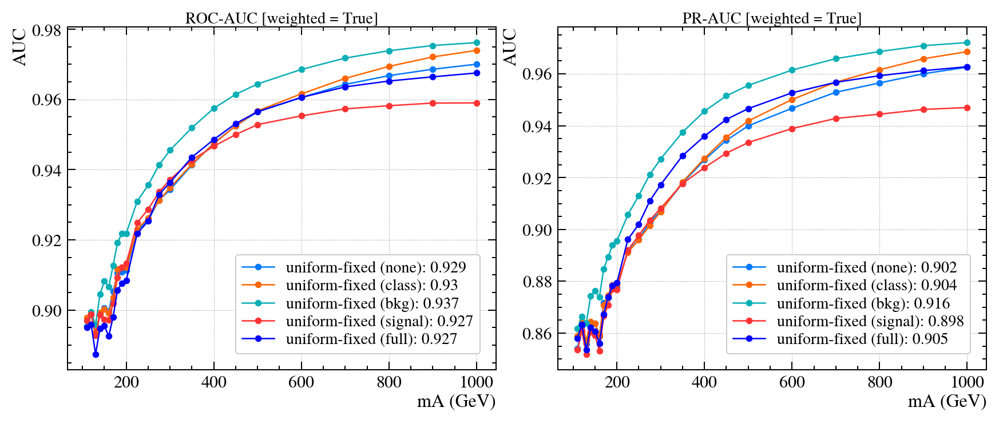

In [23]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

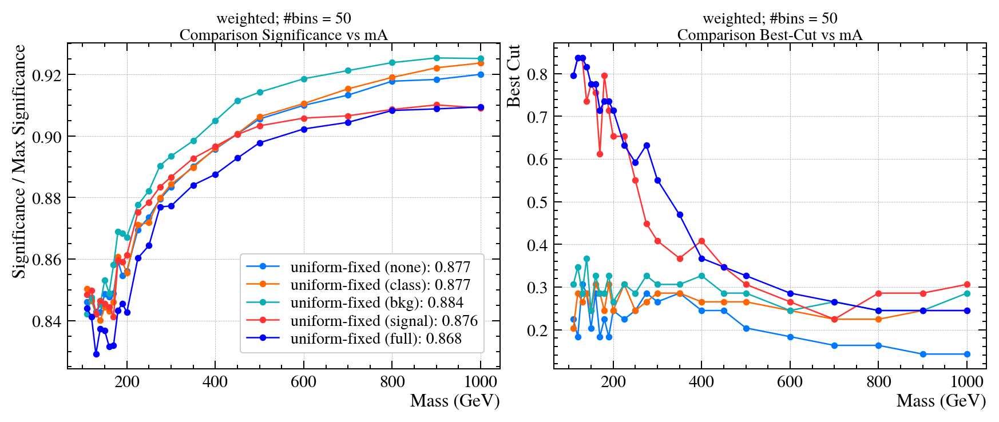

In [24]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

Comparison for **uniform (sampled)**: class vs signal vs background vs full balance.

In [25]:
models = {}

for b in [None, 'class', 'bkg', 'signal', 'full']:
    model = utils.get_compiled_pnn(test, dropout=0.25)
    
    if b is None:
        utils.load_from_checkpoint(model, path=f'benchmark/uniform-sampled/pnn')
        models[f'uniform-sampled (none)'] = model
    else:
        utils.load_from_checkpoint(model, path=f'benchmark/uniform-sampled/pnn-{b}_balance')
        models[f'uniform-sampled ({b})'] = model

Loaded from "weights\benchmark/uniform-sampled/pnn\weights-48-0.975"
Loaded from "weights\benchmark/uniform-sampled/pnn-class_balance\weights-48-0.976"
Loaded from "weights\benchmark/uniform-sampled/pnn-bkg_balance\weights-22-0.974"
Loaded from "weights\benchmark/uniform-sampled/pnn-signal_balance\weights-18-0.946"
Loaded from "weights\benchmark/uniform-sampled/pnn-full_balance\weights-22-0.929"


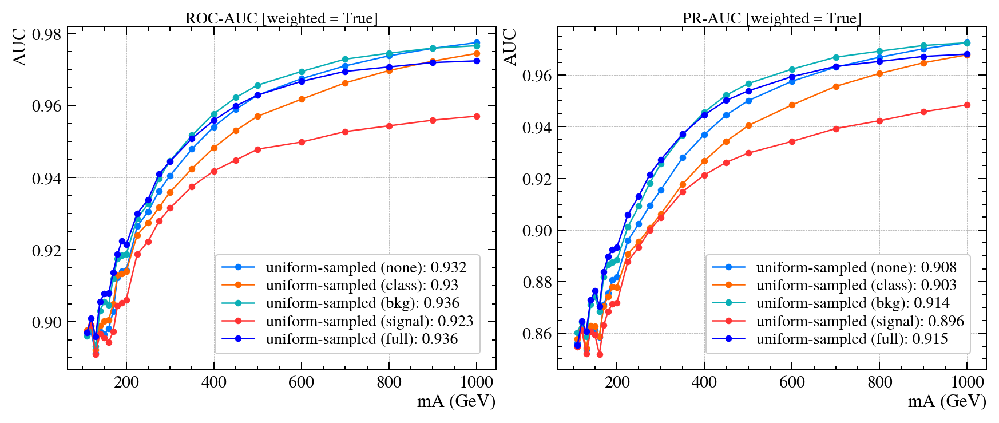

In [26]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

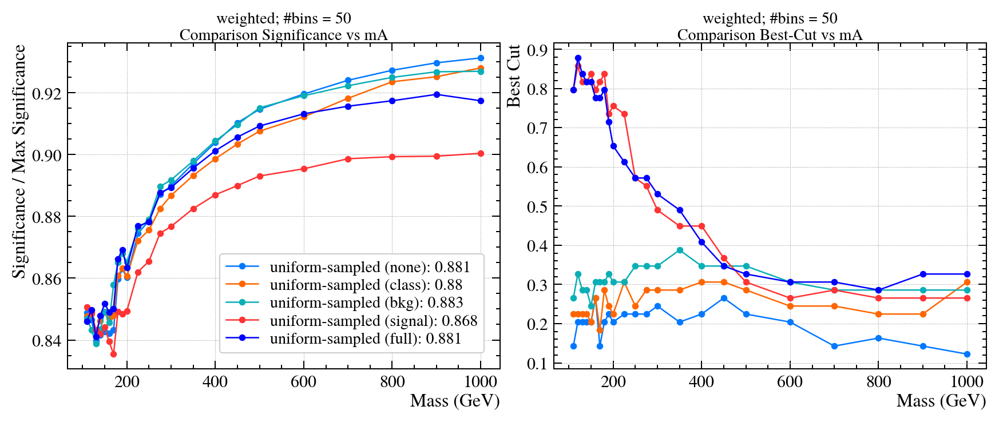

In [27]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

### Same

#### Full balancing
Fixed:

In [85]:
del train, valid, model, checkpoint
free_mem()

train, valid = cms.data.FullBalancedSequence.get_data(data, intervals=data.default_intervals, 
                                                      sample_mass=False)

In [86]:
model, checkpoint = utils.get_compiled_pnn(data, save='benchmark/same-fixed/pnn-full_balance',
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5),
                                           dropout=0.25, lr=3e-4)

In [87]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
732/732 - 30s - loss: 0.6117 - binary_accuracy: 0.6533 - auc: 0.6803 - precision: 0.6579 - recall: 0.7045 - ams: 0.7377 - class-loss: 0.9480 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 2.5391 - weight-norm: 19.3294 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0372 - val_loss: 0.2246 - val_binary_accuracy: 0.7373 - val_auc: 0.8553 - val_precision: 0.6128 - val_recall: 0.9138 - val_ams: 0.7539
Epoch 2/50
732/732 - 27s - loss: 0.5474 - binary_accuracy: 0.7375 - auc: 0.8003 - precision: 0.7201 - recall: 0.8161 - ams: 0.7806 - class-loss: 0.5759 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.7381 - weight-norm: 18.7187 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0347 - val_loss: 0.2174 - val_binary_accuracy: 0.8214 - val_auc: 0.9009 - val_precision: 0.7413 - val_recall: 0.8431 - val_ams: 0.7905
Epoch 3/50
732/732 - 28s - loss: 0.5235 - binary_accuracy: 0.7592 - auc: 0.8262 - precision: 0.7391 - recall: 0.8352 - ams: 0.7937 - class-loss: 0.5423 - fool-loss:

In [88]:
utils.load_from_checkpoint(model, path='benchmark/same-fixed/pnn-full_balance')

Loaded from "weights\benchmark/same-fixed/pnn-full_balance\weights-31-0.972"


Sampled:

In [89]:
train, valid = cms.data.FullBalancedSequence.get_data(data, intervals=data.default_intervals, 
                                                      sample_mass=True)

In [90]:
model, checkpoint = utils.get_compiled_pnn(data, save='benchmark/same-sampled/pnn-full_balance',
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5),
                                           dropout=0.25, lr=3e-4)

In [91]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
732/732 - 30s - loss: 0.6146 - binary_accuracy: 0.6746 - auc: 0.7053 - precision: 0.6732 - recall: 0.7363 - ams: 0.7508 - class-loss: 0.7774 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 1.6371 - weight-norm: 19.2602 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0370 - val_loss: 0.2243 - val_binary_accuracy: 0.8164 - val_auc: 0.8890 - val_precision: 0.7115 - val_recall: 0.9020 - val_ams: 0.8011
Epoch 2/50
732/732 - 28s - loss: 0.5352 - binary_accuracy: 0.7477 - auc: 0.8110 - precision: 0.7297 - recall: 0.8233 - ams: 0.7870 - class-loss: 0.5615 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.6225 - weight-norm: 18.5579 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0342 - val_loss: 0.2107 - val_binary_accuracy: 0.8391 - val_auc: 0.9116 - val_precision: 0.7604 - val_recall: 0.8666 - val_ams: 0.8118
Epoch 3/50
732/732 - 27s - loss: 0.5393 - binary_accuracy: 0.7661 - auc: 0.8343 - precision: 0.7431 - recall: 0.8460 - ams: 0.7988 - class-loss: 0.5315 - fool-loss:

In [92]:
utils.load_from_checkpoint(model, path='benchmark/same-sampled/pnn-full_balance')

Loaded from "weights\benchmark/same-sampled/pnn-full_balance\weights-22-0.970"


In [93]:
models = {}

for b in ['fixed', 'sampled']:
    model = utils.get_compiled_pnn(test, dropout=0.25)
    utils.load_from_checkpoint(model, path=f'benchmark/same-{b}/pnn-full_balance')
    
    models[f'same-{b} (full)'] = model

Loaded from "weights\benchmark/same-fixed/pnn-full_balance\weights-31-0.972"
Loaded from "weights\benchmark/same-sampled/pnn-full_balance\weights-22-0.970"


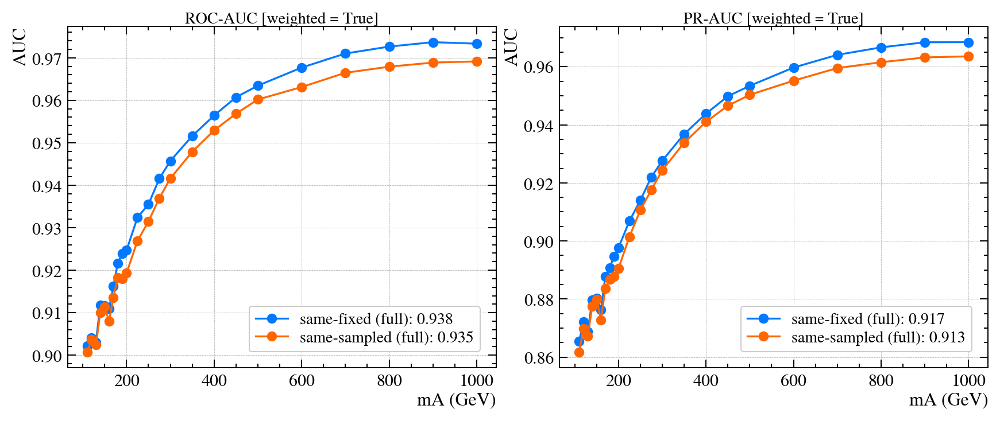

In [94]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

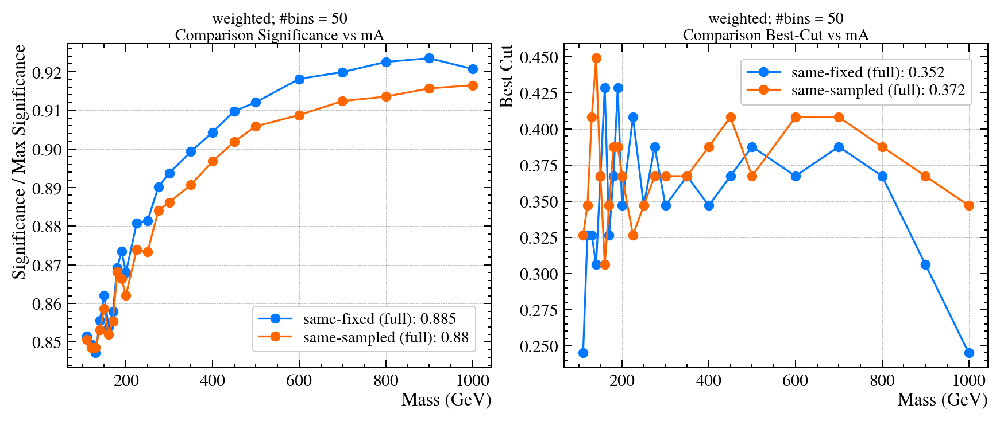

In [95]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

---
---

## + Preprocessing

### Uniform
* Can only *balance signal mA* or *bkg* processes.

#### Class (batch) balancing
Fixed:

In [99]:
train, valid = cms.data.BalancedUniformSequence.get_data(data, balance_signal=False, 
                                                         balance_bkg=False)

In [100]:
model, checkpoint = utils.get_compiled_pnn(data, dropout=0.25, preprocess=preproc,
                                           save='benchmark/uniform-fixed/pnn-class_balance-preproc', 
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [101]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
976/976 - 16s - loss: 0.2077 - binary_accuracy: 0.9076 - auc: 0.9657 - precision: 0.8778 - recall: 0.8934 - ams: 0.8874 - class-loss: 0.2597 - fool-loss: 0.0000e+00 - lr: 0.0010 - grad-norm: 0.2345 - weight-norm: 17.0067 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0289 - val_loss: 0.1012 - val_binary_accuracy: 0.9232 - val_auc: 0.9757 - val_precision: 0.8875 - val_recall: 0.9229 - val_ams: 0.9051
Epoch 2/50
976/976 - 13s - loss: 0.1969 - binary_accuracy: 0.9243 - auc: 0.9758 - precision: 0.8965 - recall: 0.9167 - ams: 0.9075 - class-loss: 0.2093 - fool-loss: 0.0000e+00 - lr: 0.0010 - grad-norm: 0.2848 - weight-norm: 13.4415 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0174 - val_loss: 0.0883 - val_binary_accuracy: 0.9272 - val_auc: 0.9788 - val_precision: 0.8890 - val_recall: 0.9324 - val_ams: 0.9107
Epoch 3/50
976/976 - 13s - loss: 0.1774 - binary_accuracy: 0.9275 - auc: 0.9776 - precision: 0.8995 - recall: 0.9217 - ams: 0.9113 - class-loss: 0.1981 - fool-loss: 0.0000e

In [102]:
utils.load_from_checkpoint(model, path='benchmark/uniform-fixed/pnn-class_balance-preproc')

Loaded from "weights\benchmark/uniform-fixed/pnn-class_balance-preproc\weights-23-0.982"


In [103]:
f = utils.get_compiled_pnn(test, dropout=0.25)
utils.load_from_checkpoint(f, path='benchmark/uniform-fixed/pnn-class_balance')

g = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(g, path='benchmark/uniform-fixed/pnn-class_balance-preproc')

models = {'class-balance': f, '+ preprocess': g}

Loaded from "weights\benchmark/uniform-fixed/pnn-class_balance\weights-36-0.972"
Loaded from "weights\benchmark/uniform-fixed/pnn-class_balance-preproc\weights-23-0.982"


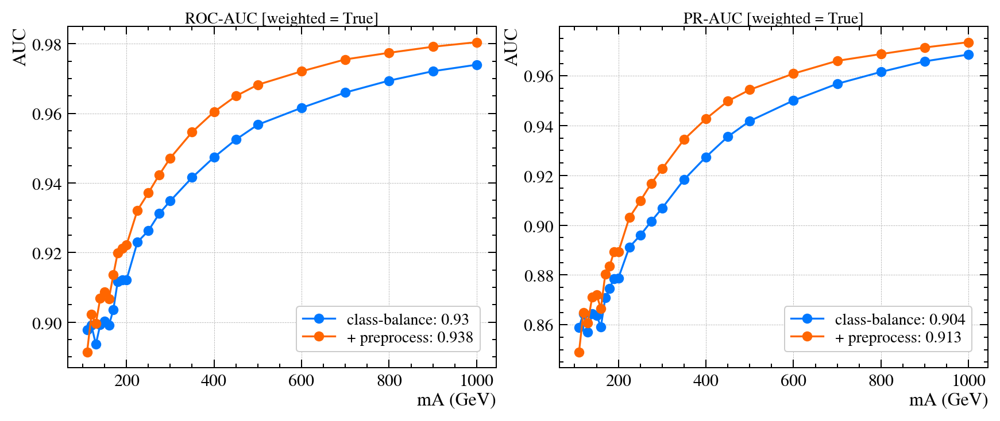

In [104]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

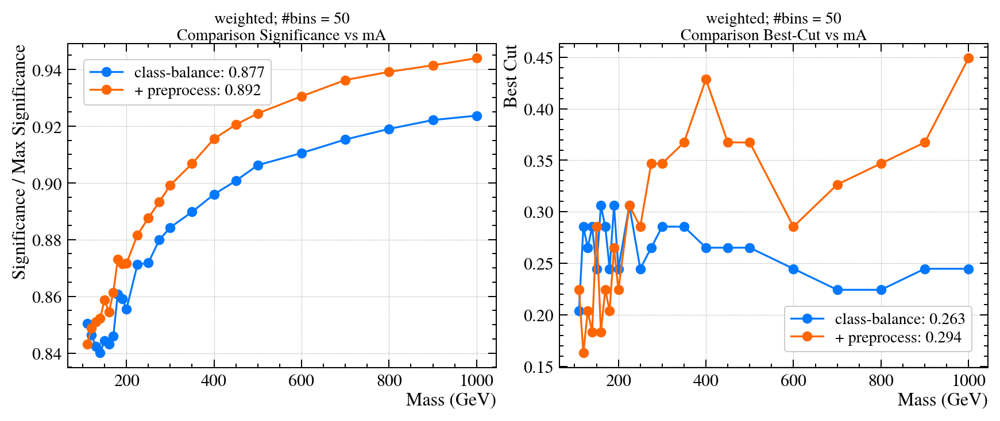

In [105]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

Sampled:

In [106]:
train, valid = cms.data.BalancedUniformSequence.get_data(data, balance_signal=False,
                                                         balance_bkg=False, sample_mass=True)

In [107]:
model, checkpoint = utils.get_compiled_pnn(data, dropout=0.25, preprocess=preproc,
                                           save='benchmark/uniform-sampled/pnn-class_balance-preproc', 
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [108]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
976/976 - 15s - loss: 0.2225 - binary_accuracy: 0.9071 - auc: 0.9655 - precision: 0.8754 - recall: 0.8951 - ams: 0.8859 - class-loss: 0.2598 - fool-loss: 0.0000e+00 - lr: 0.0010 - grad-norm: 0.2328 - weight-norm: 16.7861 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0281 - val_loss: 0.1115 - val_binary_accuracy: 0.9240 - val_auc: 0.9765 - val_precision: 0.8927 - val_recall: 0.9185 - val_ams: 0.9056
Epoch 2/50
976/976 - 12s - loss: 0.2167 - binary_accuracy: 0.9245 - auc: 0.9760 - precision: 0.8959 - recall: 0.9180 - ams: 0.9075 - class-loss: 0.2081 - fool-loss: 0.0000e+00 - lr: 0.0010 - grad-norm: 0.2896 - weight-norm: 13.2404 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0169 - val_loss: 0.1033 - val_binary_accuracy: 0.9245 - val_auc: 0.9771 - val_precision: 0.8951 - val_recall: 0.9167 - val_ams: 0.9062
Epoch 3/50
976/976 - 12s - loss: 0.1781 - binary_accuracy: 0.9276 - auc: 0.9776 - precision: 0.8996 - recall: 0.9219 - ams: 0.9111 - class-loss: 0.1976 - fool-loss: 0.0000e

In [109]:
utils.load_from_checkpoint(model, path='benchmark/uniform-sampled/pnn-class_balance-preproc')

Loaded from "weights\benchmark/uniform-sampled/pnn-class_balance-preproc\weights-32-0.982"


In [110]:
f = utils.get_compiled_pnn(test, dropout=0.25)
utils.load_from_checkpoint(f, path='benchmark/uniform-sampled/pnn-class_balance')

g = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(g, path='benchmark/uniform-sampled/pnn-class_balance-preproc')

models = {'class-balance (sampled)': f, '+ preprocess': g}

Loaded from "weights\benchmark/uniform-sampled/pnn-class_balance\weights-48-0.976"
Loaded from "weights\benchmark/uniform-sampled/pnn-class_balance-preproc\weights-32-0.982"


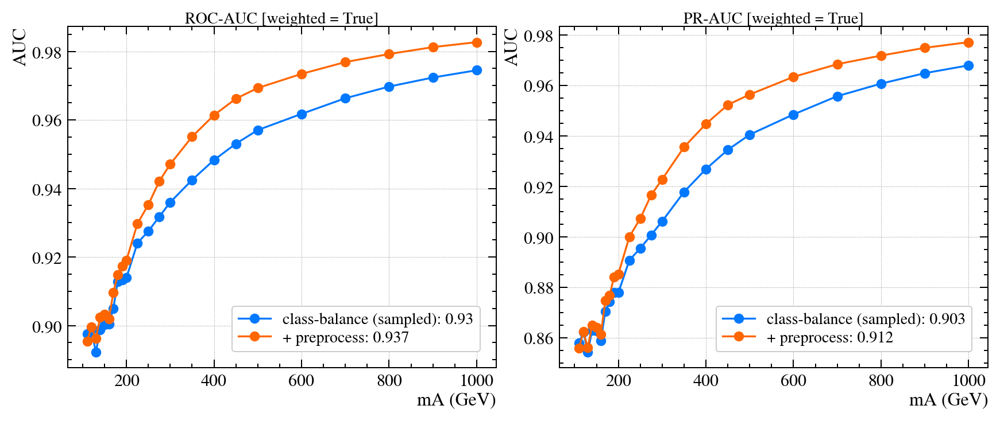

In [111]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

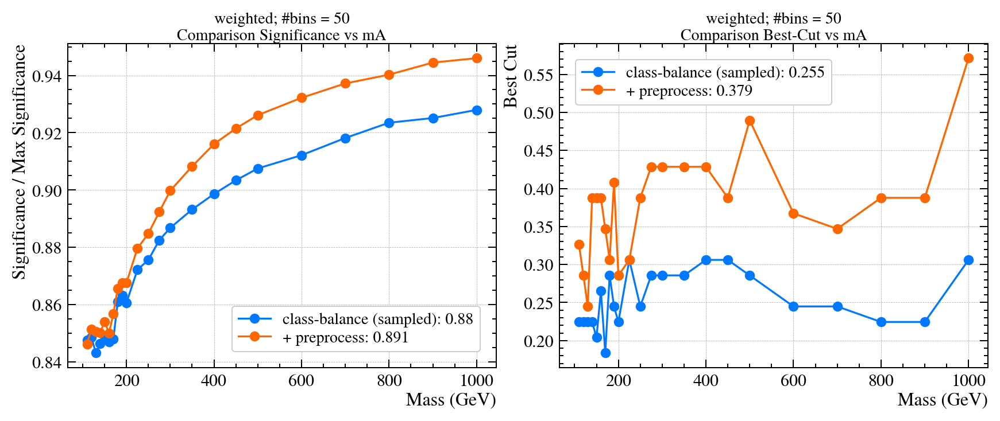

In [112]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

#### Signal balancing
Fixed:

In [ ]:
train, valid = cms.data.BalancedUniformSequence.get_data(data, balance_bkg=False)

In [114]:
model, checkpoint = utils.get_compiled_pnn(data, dropout=0.25, preprocess=preproc,
                                           save='benchmark/uniform-fixed/pnn-signal_balance-preproc', 
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [115]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
988/988 - 22s - loss: 0.1922 - binary_accuracy: 0.9141 - auc: 0.9683 - precision: 0.9132 - recall: 0.9390 - ams: 0.9265 - class-loss: 0.2467 - fool-loss: 0.0000e+00 - lr: 0.0010 - grad-norm: 0.2211 - weight-norm: 16.7370 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0279 - val_loss: 0.0858 - val_binary_accuracy: 0.8839 - val_auc: 0.9563 - val_precision: 0.7993 - val_recall: 0.9436 - val_ams: 0.8733
Epoch 2/50
988/988 - 18s - loss: 0.2173 - binary_accuracy: 0.9321 - auc: 0.9780 - precision: 0.9289 - recall: 0.9542 - ams: 0.9416 - class-loss: 0.1939 - fool-loss: 0.0000e+00 - lr: 0.0010 - grad-norm: 0.2730 - weight-norm: 12.8938 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0159 - val_loss: 0.0824 - val_binary_accuracy: 0.8855 - val_auc: 0.9572 - val_precision: 0.8030 - val_recall: 0.9417 - val_ams: 0.8731
Epoch 3/50
988/988 - 18s - loss: 0.1943 - binary_accuracy: 0.9342 - auc: 0.9791 - precision: 0.9304 - recall: 0.9564 - ams: 0.9435 - class-loss: 0.1853 - fool-loss: 0.0000e

In [116]:
utils.load_from_checkpoint(model, path='benchmark/uniform-fixed/pnn-signal_balance-preproc')

Loaded from "weights\benchmark/uniform-fixed/pnn-signal_balance-preproc\weights-28-0.965"


In [117]:
f = utils.get_compiled_pnn(test, dropout=0.25)
utils.load_from_checkpoint(f, path='benchmark/uniform-fixed/pnn-signal_balance')

g = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(g, path='benchmark/uniform-fixed/pnn-signal_balance-preproc')

models = {'signal-balance (fixed)': f, '+ preprocess': g}

Loaded from "weights\benchmark/uniform-fixed/pnn-signal_balance\weights-36-0.949"
Loaded from "weights\benchmark/uniform-fixed/pnn-signal_balance-preproc\weights-28-0.965"


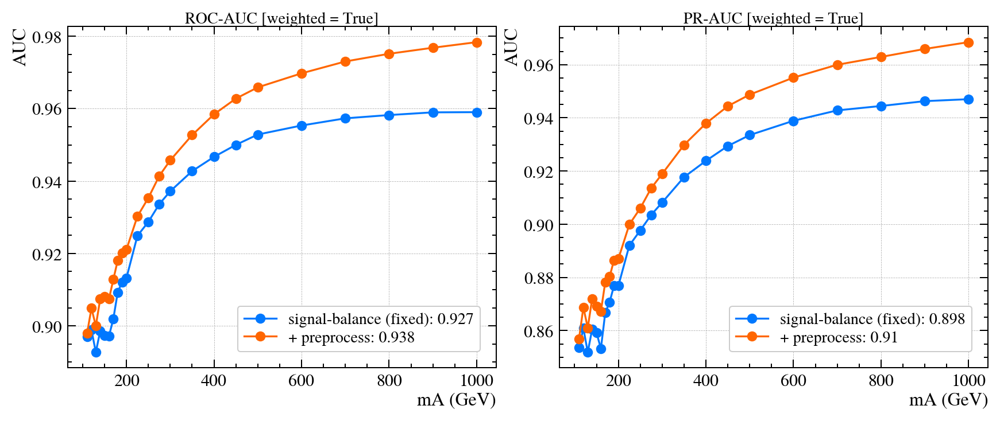

In [118]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

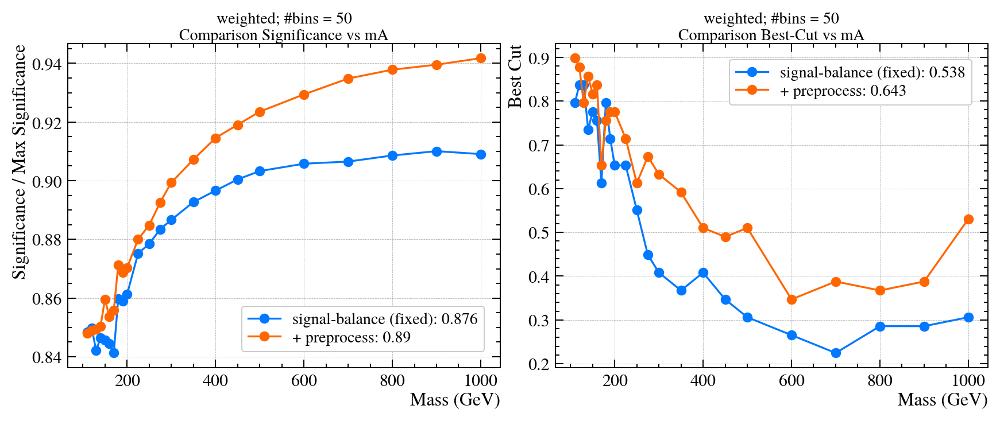

In [119]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

Sampled:

In [120]:
train, valid = cms.data.BalancedUniformSequence.get_data(data, balance_bkg=False,
                                                         sample_mass=True)

In [8]:
model, checkpoint = utils.get_compiled_pnn(data, dropout=0.25, preprocess=preproc,
                                           save='benchmark/uniform-sampled/pnn-signal_balance-preproc', 
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [ ]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
988/988 - 19s - loss: 0.2003 - binary_accuracy: 0.9149 - auc: 0.9690 - precision: 0.9132 - recall: 0.9405 - ams: 0.9270 - class-loss: 0.2436 - fool-loss: 0.0000e+00 - lr: 0.0010 - grad-norm: 0.2165 - weight-norm: 16.3827 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0269 - val_loss: 0.0783 - val_binary_accuracy: 0.8815 - val_auc: 0.9572 - val_precision: 0.7929 - val_recall: 0.9482 - val_ams: 0.8743
Epoch 2/50
988/988 - 16s - loss: 0.1831 - binary_accuracy: 0.9321 - auc: 0.9784 - precision: 0.9293 - recall: 0.9538 - ams: 0.9416 - class-loss: 0.1924 - fool-loss: 0.0000e+00 - lr: 0.0010 - grad-norm: 0.2728 - weight-norm: 12.6418 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0154 - val_loss: 0.0730 - val_binary_accuracy: 0.8749 - val_auc: 0.9536 - val_precision: 0.7817 - val_recall: 0.9489 - val_ams: 0.8677
Epoch 3/50
988/988 - 16s - loss: 0.1957 - binary_accuracy: 0.9347 - auc: 0.9795 - precision: 0.9316 - recall: 0.9560 - ams: 0.9439 - class-loss: 0.1834 - fool-loss: 0.0000e

In [9]:
utils.load_from_checkpoint(model, path='benchmark/uniform-sampled/pnn-signal_balance-preproc')

Loaded from "weights\benchmark/uniform-sampled/pnn-signal_balance-preproc\weights-35-0.967"


In [10]:
f = utils.get_compiled_pnn(test, dropout=0.25)
utils.load_from_checkpoint(f, path='benchmark/uniform-sampled/pnn-signal_balance')

g = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(g, path='benchmark/uniform-sampled/pnn-signal_balance-preproc')

models = {'signal-balance (sampled)': f, '+ preprocess': g}

Loaded from "weights\benchmark/uniform-sampled/pnn-signal_balance\weights-18-0.946"
Loaded from "weights\benchmark/uniform-sampled/pnn-signal_balance-preproc\weights-35-0.967"


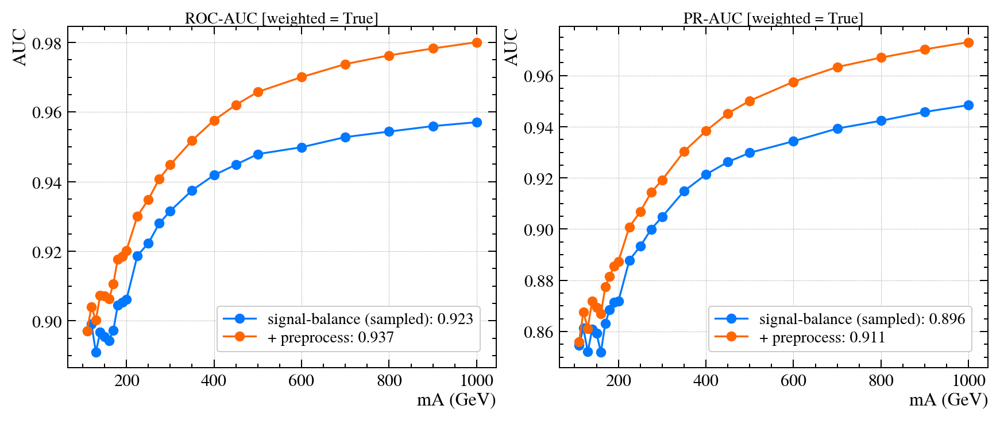

In [11]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

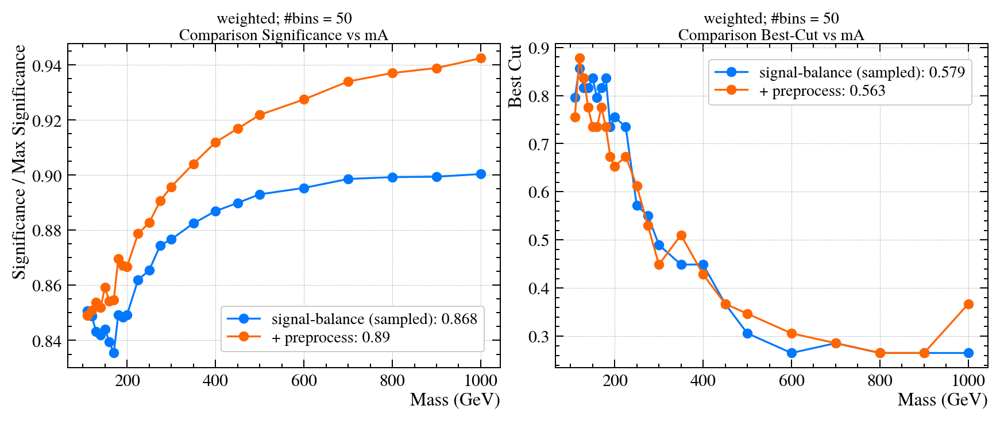

In [12]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

#### Bkg-only balancing
Fixed:

In [13]:
del model, checkpoint, models, f, g
free_mem()

train, valid = cms.data.BalancedUniformSequence.get_data(data, balance_signal=False)

In [14]:
model, checkpoint = utils.get_compiled_pnn(data, dropout=0.25, preprocess=preproc,
                                           save='benchmark/uniform-fixed/pnn-bkg_balance-preproc', 
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [15]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
976/976 - 14s - loss: 0.2925 - binary_accuracy: 0.8704 - auc: 0.9384 - precision: 0.8447 - recall: 0.9076 - ams: 0.8776 - class-loss: 0.3363 - fool-loss: 0.0000e+00 - lr: 0.0010 - grad-norm: 0.2980 - weight-norm: 17.3018 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0298 - val_loss: 0.1219 - val_binary_accuracy: 0.9237 - val_auc: 0.9768 - val_precision: 0.8929 - val_recall: 0.9173 - val_ams: 0.9053
Epoch 2/50
976/976 - 11s - loss: 0.2852 - binary_accuracy: 0.8935 - auc: 0.9539 - precision: 0.8680 - recall: 0.9281 - ams: 0.8989 - class-loss: 0.2801 - fool-loss: 0.0000e+00 - lr: 0.0010 - grad-norm: 0.3874 - weight-norm: 14.2675 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0197 - val_loss: 0.0969 - val_binary_accuracy: 0.9276 - val_auc: 0.9791 - val_precision: 0.8850 - val_recall: 0.9391 - val_ams: 0.9130
Epoch 3/50
976/976 - 11s - loss: 0.2549 - binary_accuracy: 0.8987 - auc: 0.9574 - precision: 0.8729 - recall: 0.9332 - ams: 0.9035 - class-loss: 0.2657 - fool-loss: 0.0000e

In [16]:
utils.load_from_checkpoint(model, path='benchmark/uniform-fixed/pnn-bkg_balance-preproc')

Loaded from "weights\benchmark/uniform-fixed/pnn-bkg_balance-preproc\weights-31-0.982"


In [17]:
f = utils.get_compiled_pnn(test, dropout=0.25)
utils.load_from_checkpoint(f, path='benchmark/uniform-fixed/pnn-bkg_balance')

g = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(g, path='benchmark/uniform-fixed/pnn-bkg_balance-preproc')

models = {'bkg-balance (fixed)': f, '+ preprocess': g}

Loaded from "weights\benchmark/uniform-fixed/pnn-bkg_balance\weights-35-0.971"
Loaded from "weights\benchmark/uniform-fixed/pnn-bkg_balance-preproc\weights-31-0.982"


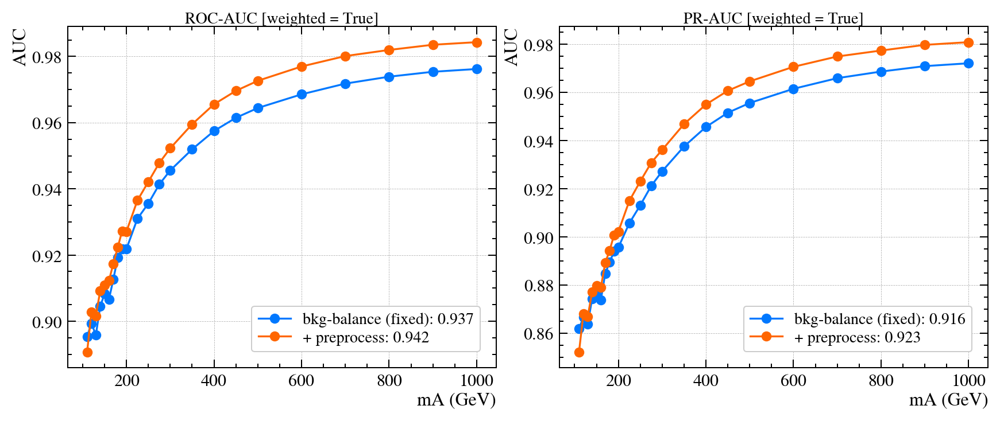

In [18]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

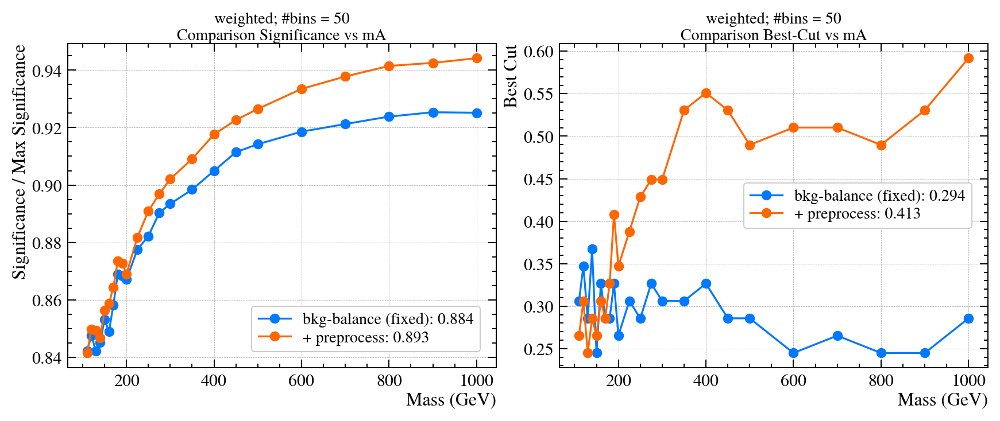

In [19]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

Sampled:

In [20]:
train, valid = cms.data.BalancedUniformSequence.get_data(data, balance_signal=False, 
                                                         sample_mass=True)

In [21]:
model, checkpoint = utils.get_compiled_pnn(data, dropout=0.25, preprocess=preproc,
                                           save='benchmark/uniform-sampled/pnn-bkg_balance-preproc', 
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [22]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
976/976 - 15s - loss: 0.3321 - binary_accuracy: 0.8696 - auc: 0.9382 - precision: 0.8446 - recall: 0.9060 - ams: 0.8768 - class-loss: 0.3371 - fool-loss: 0.0000e+00 - lr: 0.0010 - grad-norm: 0.3107 - weight-norm: 17.2463 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0296 - val_loss: 0.0993 - val_binary_accuracy: 0.9187 - val_auc: 0.9768 - val_precision: 0.8612 - val_recall: 0.9473 - val_ams: 0.9060
Epoch 2/50
976/976 - 12s - loss: 0.2995 - binary_accuracy: 0.8930 - auc: 0.9542 - precision: 0.8686 - recall: 0.9260 - ams: 0.8981 - class-loss: 0.2800 - fool-loss: 0.0000e+00 - lr: 0.0010 - grad-norm: 0.3987 - weight-norm: 14.1481 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0194 - val_loss: 0.0942 - val_binary_accuracy: 0.9252 - val_auc: 0.9791 - val_precision: 0.8773 - val_recall: 0.9429 - val_ams: 0.9107
Epoch 3/50
976/976 - 11s - loss: 0.2521 - binary_accuracy: 0.8971 - auc: 0.9570 - precision: 0.8721 - recall: 0.9308 - ams: 0.9024 - class-loss: 0.2672 - fool-loss: 0.0000e

In [23]:
utils.load_from_checkpoint(model, path='benchmark/uniform-sampled/pnn-bkg_balance-preproc')

Loaded from "weights\benchmark/uniform-sampled/pnn-bkg_balance-preproc\weights-36-0.983"


In [24]:
free_mem()

60

In [25]:
f = utils.get_compiled_pnn(test, dropout=0.25)
utils.load_from_checkpoint(f, path='benchmark/uniform-sampled/pnn-bkg_balance')

g = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(g, path='benchmark/uniform-sampled/pnn-bkg_balance-preproc')

models = {'bkg-balance (sampled)': f, '+ preprocess': g}

Loaded from "weights\benchmark/uniform-sampled/pnn-bkg_balance\weights-22-0.974"
Loaded from "weights\benchmark/uniform-sampled/pnn-bkg_balance-preproc\weights-36-0.983"


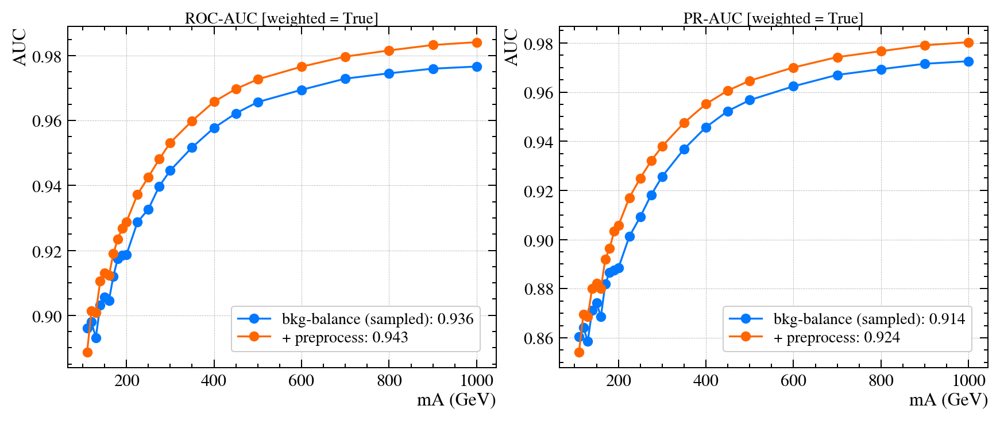

In [26]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

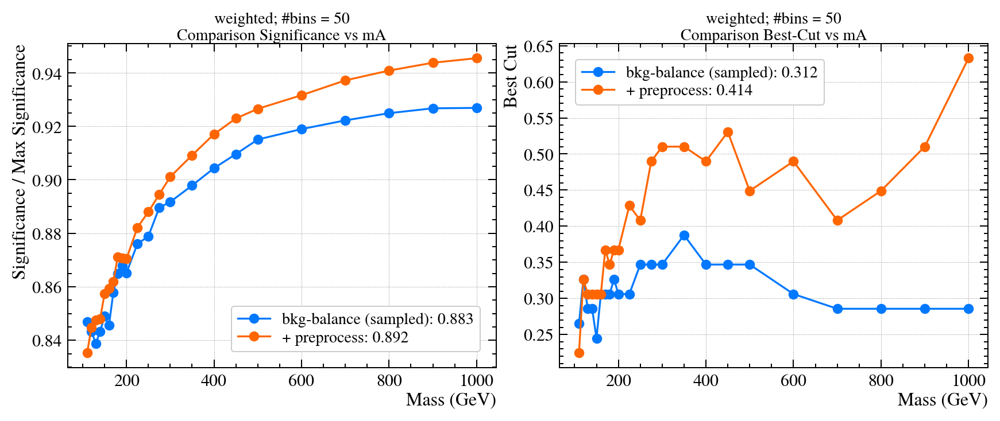

In [27]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

#### Full balancing
Fixed:

In [28]:
del train, valid, model, checkpoint, f, g, models
free_mem()

train, valid = cms.data.BalancedUniformSequence.get_data(data)

In [29]:
model, checkpoint = utils.get_compiled_pnn(data, dropout=0.25, preprocess=preproc,
                                           save='benchmark/uniform-fixed/pnn-full_balance-preproc', 
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [30]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
989/989 - 17s - loss: 0.2619 - binary_accuracy: 0.8930 - auc: 0.9388 - precision: 0.8936 - recall: 0.9533 - ams: 0.9236 - class-loss: 0.2991 - fool-loss: 0.0000e+00 - lr: 0.0010 - grad-norm: 0.2963 - weight-norm: 16.7904 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0281 - val_loss: 0.0763 - val_binary_accuracy: 0.8496 - val_auc: 0.9456 - val_precision: 0.7366 - val_recall: 0.9650 - val_ams: 0.8576
Epoch 2/50
989/989 - 14s - loss: 0.2357 - binary_accuracy: 0.9134 - auc: 0.9538 - precision: 0.9114 - recall: 0.9640 - ams: 0.9376 - class-loss: 0.2454 - fool-loss: 0.0000e+00 - lr: 0.0010 - grad-norm: 0.3581 - weight-norm: 13.3381 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0171 - val_loss: 0.0718 - val_binary_accuracy: 0.8659 - val_auc: 0.9545 - val_precision: 0.7607 - val_recall: 0.9647 - val_ams: 0.8723
Epoch 3/50
989/989 - 14s - loss: 0.2293 - binary_accuracy: 0.9165 - auc: 0.9558 - precision: 0.9138 - recall: 0.9660 - ams: 0.9398 - class-loss: 0.2354 - fool-loss: 0.0000e

In [31]:
utils.load_from_checkpoint(model, path='benchmark/uniform-fixed/pnn-full_balance-preproc')

Loaded from "weights\benchmark/uniform-fixed/pnn-full_balance-preproc\weights-44-0.962"


In [32]:
f = utils.get_compiled_pnn(test, dropout=0.25)
utils.load_from_checkpoint(f, path='benchmark/uniform-fixed/pnn-full_balance')

g = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(g, path='benchmark/uniform-fixed/pnn-full_balance-preproc')

models = {'full-balance (fixed)': f, '+ preprocess': g}

Loaded from "weights\benchmark/uniform-fixed/pnn-full_balance\weights-11-0.919"
Loaded from "weights\benchmark/uniform-fixed/pnn-full_balance-preproc\weights-44-0.962"


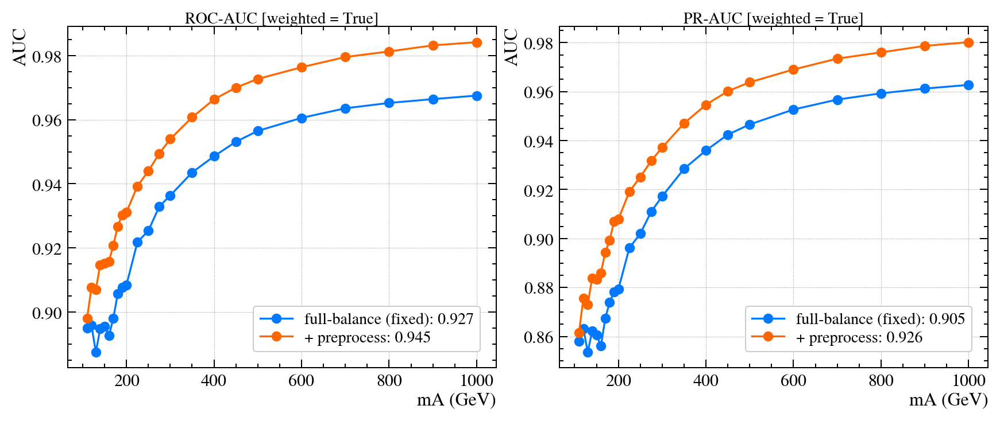

In [33]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

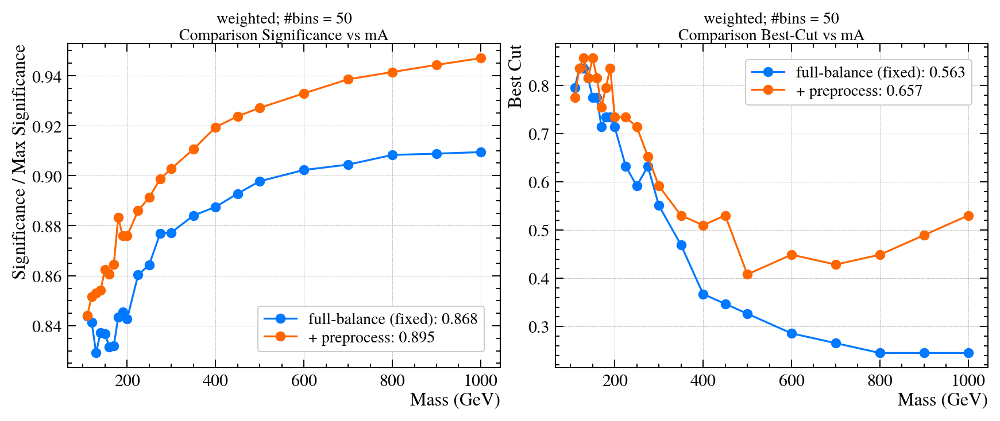

In [34]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

Sampled:

In [35]:
train, valid = cms.data.BalancedUniformSequence.get_data(data, sample_mass=True)

In [36]:
model, checkpoint = utils.get_compiled_pnn(data, dropout=0.25, preprocess=preproc,
                                           save='benchmark/uniform-sampled/pnn-full_balance-preproc', 
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [37]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
989/989 - 16s - loss: 0.2704 - binary_accuracy: 0.8932 - auc: 0.9381 - precision: 0.8924 - recall: 0.9551 - ams: 0.9237 - class-loss: 0.3007 - fool-loss: 0.0000e+00 - lr: 0.0010 - grad-norm: 0.2913 - weight-norm: 16.9699 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0287 - val_loss: 0.0879 - val_binary_accuracy: 0.8598 - val_auc: 0.9497 - val_precision: 0.7550 - val_recall: 0.9563 - val_ams: 0.8632
Epoch 2/50
989/989 - 14s - loss: 0.2317 - binary_accuracy: 0.9136 - auc: 0.9536 - precision: 0.9106 - recall: 0.9652 - ams: 0.9378 - class-loss: 0.2456 - fool-loss: 0.0000e+00 - lr: 0.0010 - grad-norm: 0.3468 - weight-norm: 13.4586 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0174 - val_loss: 0.0696 - val_binary_accuracy: 0.8589 - val_auc: 0.9512 - val_precision: 0.7501 - val_recall: 0.9651 - val_ams: 0.8670
Epoch 3/50
989/989 - 14s - loss: 0.1952 - binary_accuracy: 0.9154 - auc: 0.9549 - precision: 0.9124 - recall: 0.9661 - ams: 0.9392 - class-loss: 0.2379 - fool-loss: 0.0000e

In [38]:
utils.load_from_checkpoint(model, path='benchmark/uniform-sampled/pnn-full_balance-preproc')

Loaded from "weights\benchmark/uniform-sampled/pnn-full_balance-preproc\weights-06-0.962"


In [39]:
f = utils.get_compiled_pnn(test, dropout=0.25)
utils.load_from_checkpoint(f, path='benchmark/uniform-sampled/pnn-full_balance')

g = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(g, path='benchmark/uniform-sampled/pnn-full_balance-preproc')

models = {'full-balance (sampled)': f, '+ preprocess': g}

Loaded from "weights\benchmark/uniform-sampled/pnn-full_balance\weights-22-0.929"
Loaded from "weights\benchmark/uniform-sampled/pnn-full_balance-preproc\weights-06-0.962"


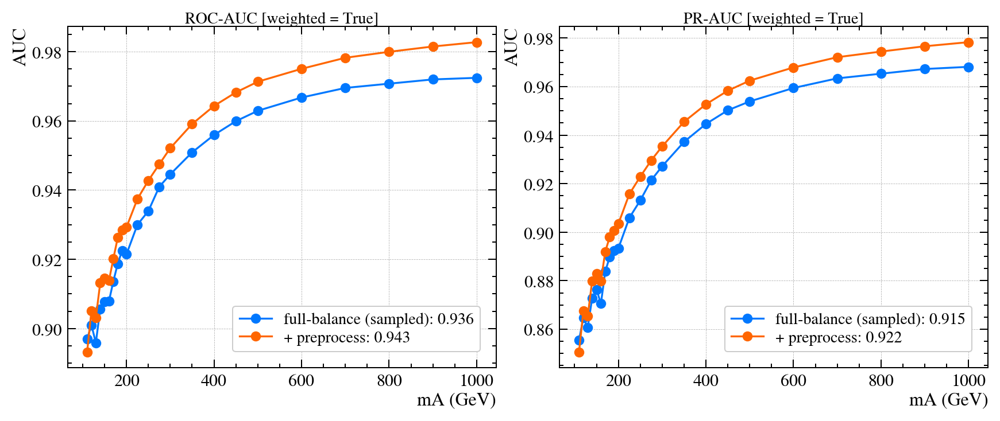

In [40]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

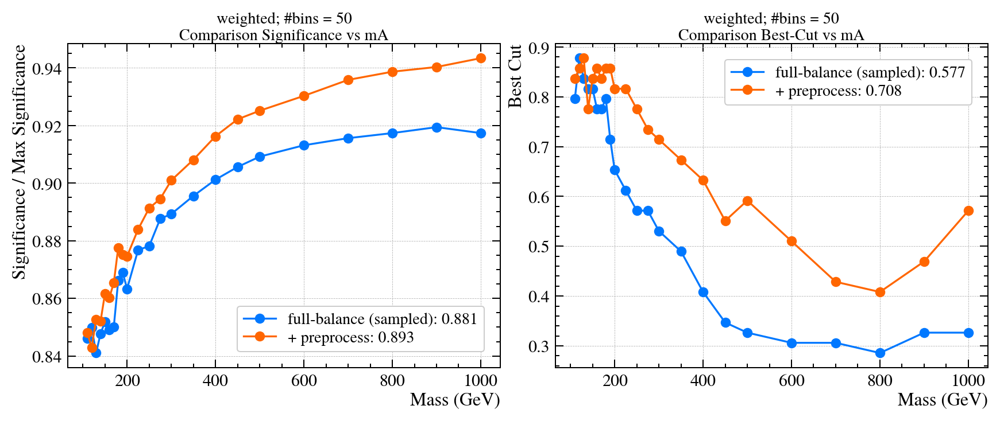

In [41]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

---
Comparison uniform:

In [42]:
del train, valid, model, models, checkpoint, f, g
free_mem()

models = {}

for b in ['class', 'signal', 'bkg', 'full']:
    for a in ['fixed', 'sampled']:
        pnn = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
        utils.load_from_checkpoint(pnn, path=f'benchmark/uniform-{a}/pnn-{b}_balance-preproc')
        
        models[f'uniform-{a} ({b}-balance)'] = pnn

Loaded from "weights\benchmark/uniform-fixed/pnn-class_balance-preproc\weights-23-0.982"
Loaded from "weights\benchmark/uniform-sampled/pnn-class_balance-preproc\weights-32-0.982"
Loaded from "weights\benchmark/uniform-fixed/pnn-signal_balance-preproc\weights-28-0.965"
Loaded from "weights\benchmark/uniform-sampled/pnn-signal_balance-preproc\weights-35-0.967"
Loaded from "weights\benchmark/uniform-fixed/pnn-bkg_balance-preproc\weights-31-0.982"
Loaded from "weights\benchmark/uniform-sampled/pnn-bkg_balance-preproc\weights-36-0.983"
Loaded from "weights\benchmark/uniform-fixed/pnn-full_balance-preproc\weights-44-0.962"
Loaded from "weights\benchmark/uniform-sampled/pnn-full_balance-preproc\weights-06-0.962"


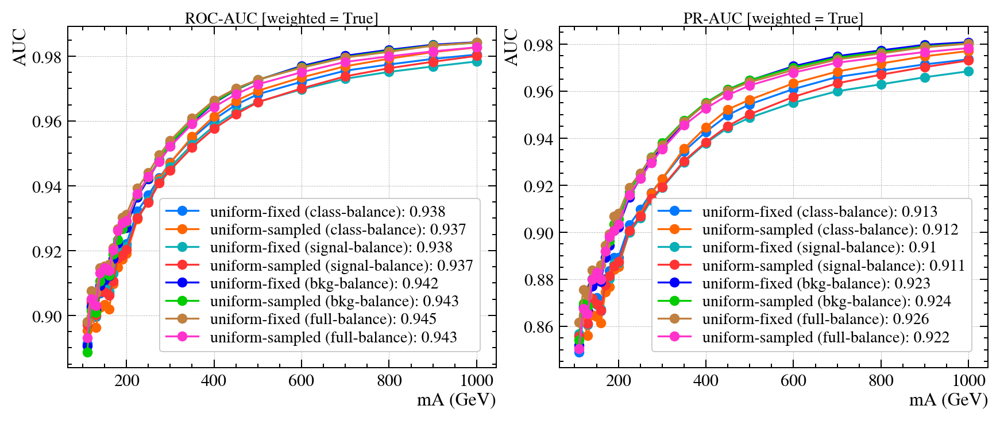

In [43]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

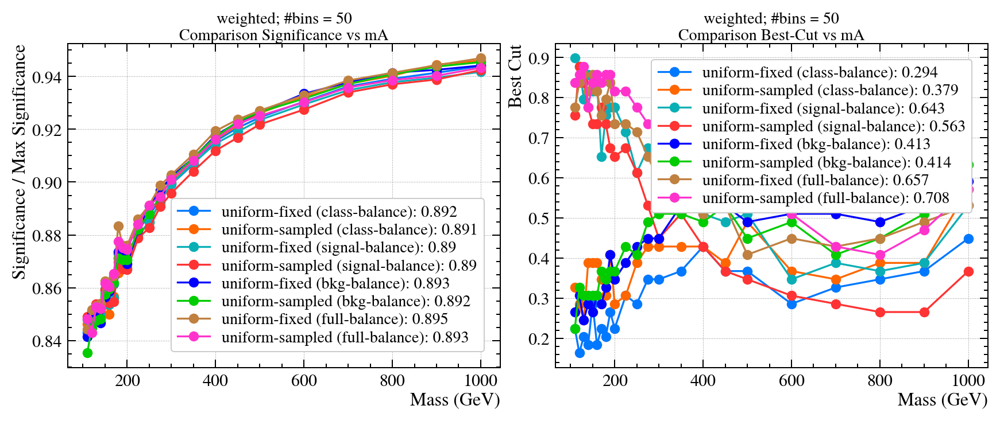

In [44]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

### Same

#### Full balancing
Fixed:

In [45]:
free_mem()

train, valid = cms.data.FullBalancedSequence.get_data(data, intervals=data.default_intervals, 
                                                      sample_mass=False)

In [46]:
model, checkpoint = utils.get_compiled_pnn(data, dropout=0.25, preprocess=preproc,
                                           save='benchmark/same-fixed/pnn-full_balance-preproc',
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [47]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
732/732 - 28s - loss: 0.3415 - binary_accuracy: 0.8390 - auc: 0.9100 - precision: 0.8218 - recall: 0.8845 - ams: 0.8561 - class-loss: 0.4004 - fool-loss: 0.0000e+00 - lr: 0.0010 - grad-norm: 0.2425 - weight-norm: 17.2541 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0296 - val_loss: 0.1073 - val_binary_accuracy: 0.9169 - val_auc: 0.9736 - val_precision: 0.8658 - val_recall: 0.9351 - val_ams: 0.9001
Epoch 2/50
732/732 - 25s - loss: 0.3514 - binary_accuracy: 0.8658 - auc: 0.9315 - precision: 0.8454 - recall: 0.9102 - ams: 0.8793 - class-loss: 0.3387 - fool-loss: 0.0000e+00 - lr: 0.0010 - grad-norm: 0.3446 - weight-norm: 14.0789 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0192 - val_loss: 0.0960 - val_binary_accuracy: 0.9222 - val_auc: 0.9762 - val_precision: 0.8695 - val_recall: 0.9454 - val_ams: 0.9074
Epoch 3/50
732/732 - 25s - loss: 0.3254 - binary_accuracy: 0.8703 - auc: 0.9349 - precision: 0.8487 - recall: 0.9157 - ams: 0.8834 - class-loss: 0.3260 - fool-loss: 0.0000e

In [48]:
utils.load_from_checkpoint(model, path='benchmark/same-fixed/pnn-full_balance-preproc')

Loaded from "weights\benchmark/same-fixed/pnn-full_balance-preproc\weights-17-0.980"


In [15]:
train, valid = cms.data.FullBalancedSequence.get_data(data, intervals=data.default_intervals, 
                                                      sample_mass=False)

In [16]:
model, checkpoint = utils.get_compiled_pnn(data, dropout=0.25, preprocess=preproc, lr=3e-4,
                                           save='benchmark/same-fixed/pnn-full_balance-preproc-2',
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-5),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-6))

In [17]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
732/732 - 49s - loss: 0.3754 - binary_accuracy: 0.8134 - auc: 0.8855 - precision: 0.7978 - recall: 0.8623 - ams: 0.8335 - class-loss: 0.4241 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.1879 - weight-norm: 20.5394 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0042 - val_loss: 0.1027 - val_binary_accuracy: 0.9041 - val_auc: 0.9663 - val_precision: 0.8476 - val_recall: 0.9238 - val_ams: 0.8850
Epoch 2/50
732/732 - 42s - loss: 0.3592 - binary_accuracy: 0.8483 - auc: 0.9177 - precision: 0.8305 - recall: 0.8927 - ams: 0.8642 - class-loss: 0.3576 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.2572 - weight-norm: 20.6664 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0042 - val_loss: 0.0915 - val_binary_accuracy: 0.9134 - val_auc: 0.9719 - val_precision: 0.8597 - val_recall: 0.9336 - val_ams: 0.8960
Epoch 3/50
732/732 - 41s - loss: 0.3510 - binary_accuracy: 0.8593 - auc: 0.9269 - precision: 0.8407 - recall: 0.9025 - ams: 0.8735 - class-loss: 0.3364 - fool-loss:

In [18]:
utils.load_from_checkpoint(model, path='benchmark/same-fixed/pnn-full_balance-preproc-2')

Loaded from "weights\benchmark/same-fixed/pnn-full_balance-preproc-2\weights-44-0.981"


In [26]:
f = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(f, path='benchmark/same-fixed/pnn-full_balance-preproc')

g = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(g, path='benchmark/same-fixed/pnn-full_balance-preproc-2')

models = {'full-balance (same)': f, 'v2': g}

Loaded from "weights\benchmark/same-fixed/pnn-full_balance-preproc\weights-17-0.980"
Loaded from "weights\benchmark/same-fixed/pnn-full_balance-preproc-2\weights-44-0.981"


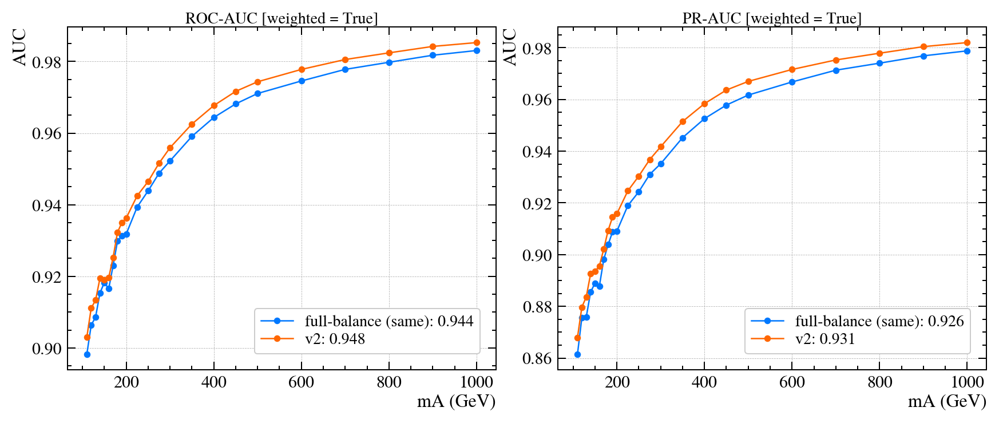

In [27]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

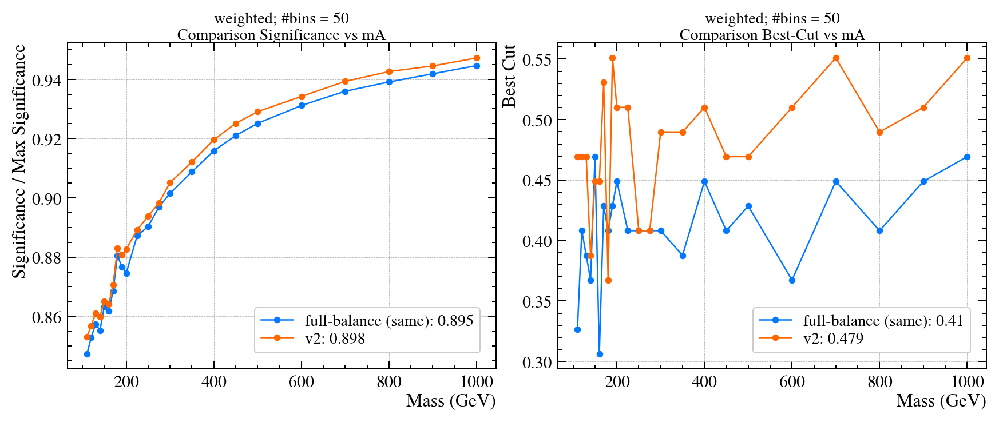

In [28]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

Sampled:

In [49]:
train, valid = cms.data.FullBalancedSequence.get_data(data, intervals=data.default_intervals, 
                                                      sample_mass=True)

In [50]:
model, checkpoint = utils.get_compiled_pnn(data, dropout=0.25, preprocess=preproc,
                                           save='benchmark/same-sampled/pnn-full_balance-preproc',
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [51]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
732/732 - 29s - loss: 0.3477 - binary_accuracy: 0.8390 - auc: 0.9092 - precision: 0.8219 - recall: 0.8842 - ams: 0.8556 - class-loss: 0.4016 - fool-loss: 0.0000e+00 - lr: 0.0010 - grad-norm: 0.2520 - weight-norm: 17.1431 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0292 - val_loss: 0.1015 - val_binary_accuracy: 0.9191 - val_auc: 0.9760 - val_precision: 0.8652 - val_recall: 0.9424 - val_ams: 0.9040
Epoch 2/50
732/732 - 26s - loss: 0.3386 - binary_accuracy: 0.8655 - auc: 0.9314 - precision: 0.8453 - recall: 0.9097 - ams: 0.8792 - class-loss: 0.3389 - fool-loss: 0.0000e+00 - lr: 0.0010 - grad-norm: 0.3681 - weight-norm: 14.0255 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0190 - val_loss: 0.0920 - val_binary_accuracy: 0.9219 - val_auc: 0.9780 - val_precision: 0.8650 - val_recall: 0.9511 - val_ams: 0.9103
Epoch 3/50
732/732 - 26s - loss: 0.2933 - binary_accuracy: 0.8712 - auc: 0.9348 - precision: 0.8490 - recall: 0.9172 - ams: 0.8842 - class-loss: 0.3256 - fool-loss: 0.0000e

In [52]:
utils.load_from_checkpoint(model, path='benchmark/same-sampled/pnn-full_balance-preproc')

Loaded from "weights\benchmark/same-sampled/pnn-full_balance-preproc\weights-31-0.982"


In [19]:
del train, valid, model, checkpoint
free_mem()

train, valid = cms.data.FullBalancedSequence.get_data(data, intervals=data.default_intervals, 
                                                      sample_mass=True)

In [20]:
model, checkpoint = utils.get_compiled_pnn(data, dropout=0.25, preprocess=preproc, lr=3e-4,
                                           save='benchmark/same-sampled/pnn-full_balance-preproc-2',
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-5),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-6))

In [21]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
732/732 - 28s - loss: 0.3824 - binary_accuracy: 0.8131 - auc: 0.8859 - precision: 0.7979 - recall: 0.8614 - ams: 0.8334 - class-loss: 0.4234 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.1872 - weight-norm: 20.5307 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0042 - val_loss: 0.1022 - val_binary_accuracy: 0.9100 - val_auc: 0.9699 - val_precision: 0.8593 - val_recall: 0.9238 - val_ams: 0.8914
Epoch 2/50
732/732 - 26s - loss: 0.3351 - binary_accuracy: 0.8488 - auc: 0.9180 - precision: 0.8296 - recall: 0.8951 - ams: 0.8646 - class-loss: 0.3569 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.2566 - weight-norm: 20.6555 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0042 - val_loss: 0.0895 - val_binary_accuracy: 0.9171 - val_auc: 0.9752 - val_precision: 0.8623 - val_recall: 0.9407 - val_ams: 0.9021
Epoch 3/50
732/732 - 26s - loss: 0.3369 - binary_accuracy: 0.8598 - auc: 0.9269 - precision: 0.8403 - recall: 0.9041 - ams: 0.8741 - class-loss: 0.3356 - fool-loss:

In [22]:
utils.load_from_checkpoint(model, path='benchmark/same-sampled/pnn-full_balance-preproc-2')

Loaded from "weights\benchmark/same-sampled/pnn-full_balance-preproc-2\weights-43-0.982"


In [53]:
f = utils.get_compiled_pnn(test, dropout=0.25)
utils.load_from_checkpoint(f, path='benchmark/same-sampled/pnn-full_balance')

g = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(g, path='benchmark/same-sampled/pnn-full_balance-preproc')

models = {'full-balance (same)': f, '+ preprocess': g}

Loaded from "weights\benchmark/same-sampled/pnn-full_balance\weights-22-0.970"
Loaded from "weights\benchmark/same-sampled/pnn-full_balance-preproc\weights-31-0.982"


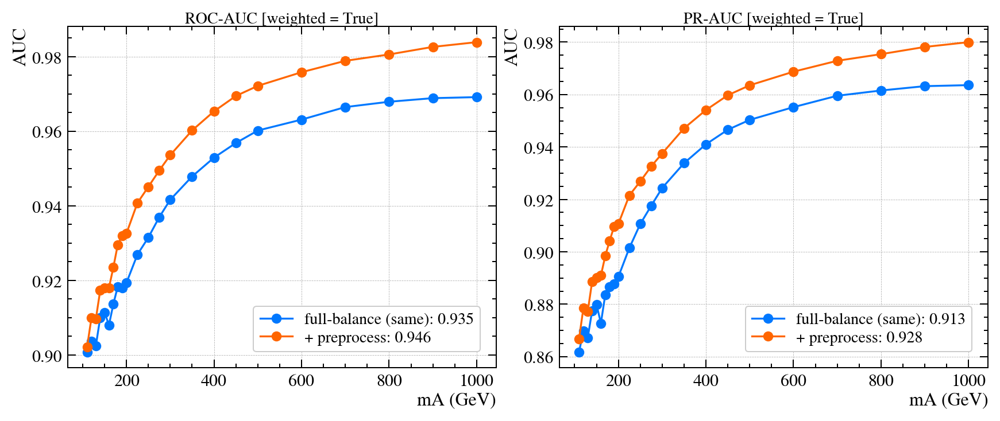

In [54]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

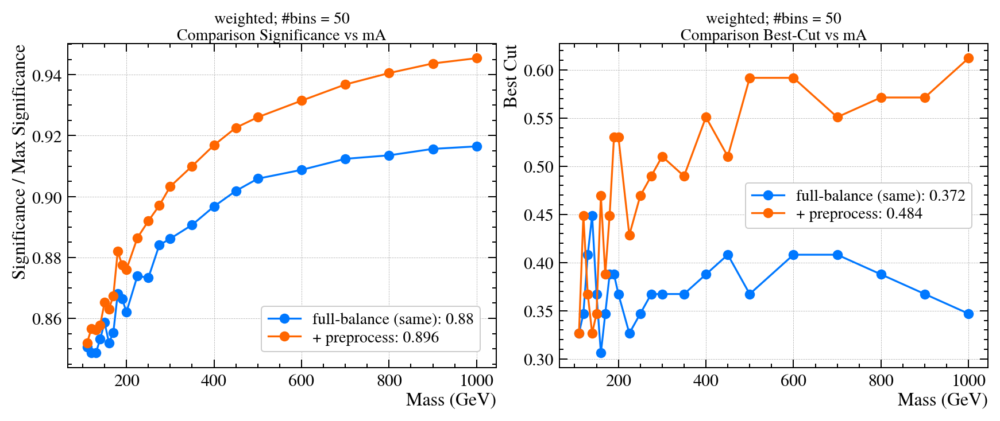

In [55]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

In [29]:
f = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(f, path='benchmark/same-sampled/pnn-full_balance-preproc')

g = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(g, path='benchmark/same-sampled/pnn-full_balance-preproc-2')

models = {'full-balance (same-sampled)': f, 'v2': g}

Loaded from "weights\benchmark/same-sampled/pnn-full_balance-preproc\weights-31-0.982"
Loaded from "weights\benchmark/same-sampled/pnn-full_balance-preproc-2\weights-43-0.982"


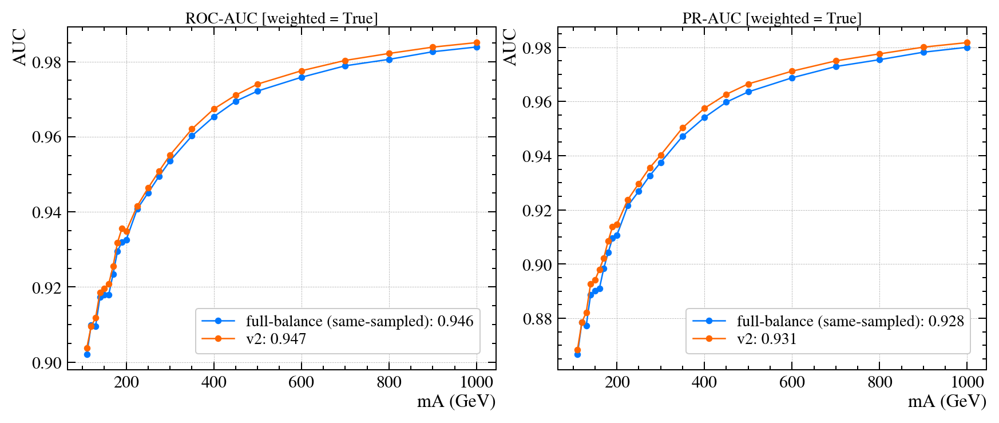

In [30]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

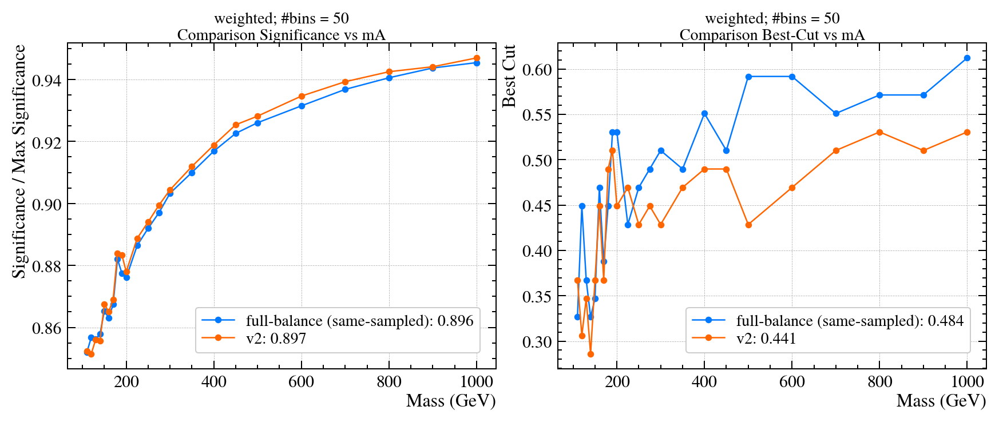

In [31]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

---
Comparison:

In [32]:
models = {}

for a in ['fixed', 'sampled']:
    for b in ['', '-full_balance']:
        pnn = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
        utils.load_from_checkpoint(pnn, path=f'benchmark/uniform-{a}/pnn{b}-preproc')
        
        if b == '':
            models[f'uniform ({a})'] = pnn
        else:
            models[f'uniform-{a} ({b[1:]})'] = pnn

Loaded from "weights\benchmark/uniform-fixed/pnn-preproc\weights-24-0.983"
Loaded from "weights\benchmark/uniform-fixed/pnn-full_balance-preproc\weights-44-0.962"
Loaded from "weights\benchmark/uniform-sampled/pnn-preproc\weights-45-0.983"
Loaded from "weights\benchmark/uniform-sampled/pnn-full_balance-preproc\weights-06-0.962"


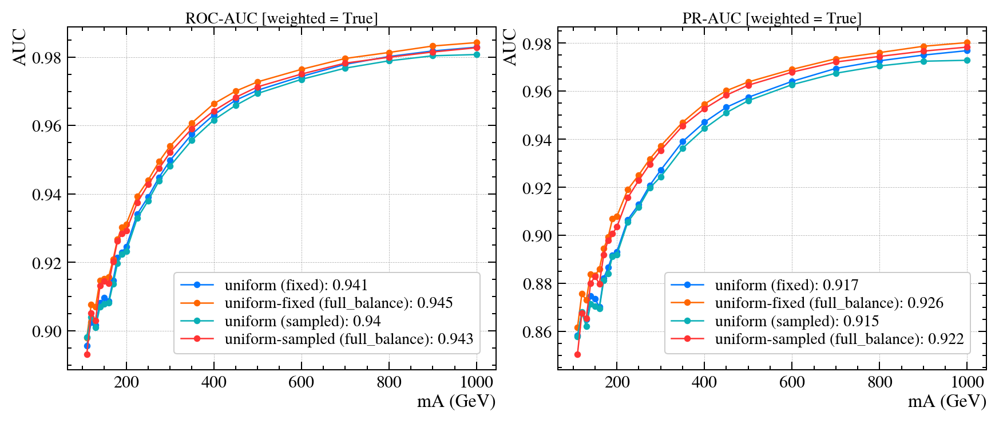

In [34]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

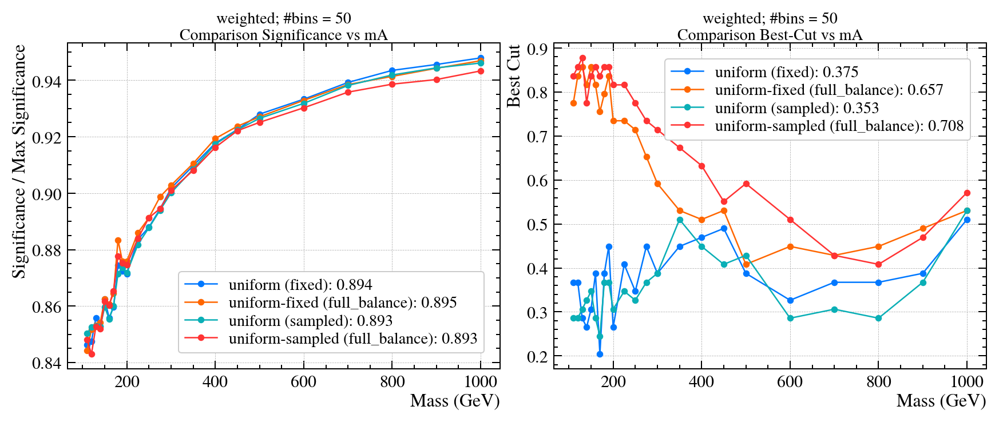

In [35]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

In [57]:
models = {}

for a in ['fixed', 'sampled']:
    for b in ['bkg', 'full']:
        pnn = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
        utils.load_from_checkpoint(pnn, path=f'benchmark/uniform-{a}/pnn-{b}_balance-preproc')
        
        models[f'uniform-{a} ({b}-balance)'] = pnn

g = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(g, path='benchmark/same-sampled/pnn-full_balance-preproc')

models['same-sampled (full-balance)'] = g

Loaded from "weights\benchmark/uniform-fixed/pnn-bkg_balance-preproc\weights-31-0.982"
Loaded from "weights\benchmark/uniform-fixed/pnn-full_balance-preproc\weights-44-0.962"
Loaded from "weights\benchmark/uniform-sampled/pnn-bkg_balance-preproc\weights-36-0.983"
Loaded from "weights\benchmark/uniform-sampled/pnn-full_balance-preproc\weights-06-0.962"
Loaded from "weights\benchmark/same-sampled/pnn-full_balance-preproc\weights-31-0.982"


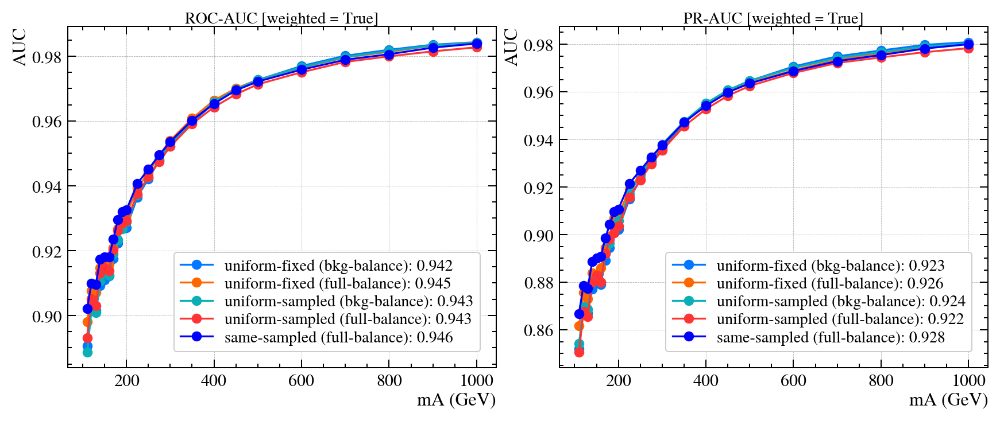

In [58]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

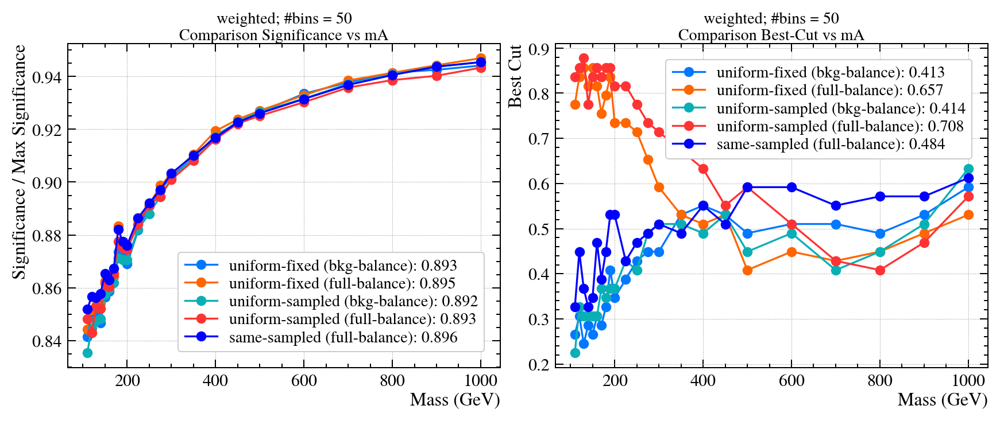

In [59]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

### SingleNN
One NN that fits all the mA, but without the mA as input.

No-balance + preprocessing:

In [8]:
train, valid = cms.data.train_valid_split(data)

train = cms.data.SimpleEvalSequence(signal=train[0], background=train[1], batch_size=1024,
                                    features=data.columns['feature'], sample_mass=False,
                                    weight_column=None)

valid = cms.data.SimpleEvalSequence(signal=valid[0], background=valid[1], batch_size=1024,
                                    features=data.columns['feature'])

In [9]:
model, checkpoint = utils.get_compiled_non_parametric(data, 
                                                      save='benchmark/single-preproc', 
                                                      lr=3e-4, dropout=0.25, preprocess=preproc,
                                                      kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                                      bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [10]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
732/732 - 21s - loss: 0.2810 - binary_accuracy: 0.8805 - auc: 0.9467 - precision: 0.8464 - recall: 0.8531 - ams: 0.8514 - class-loss: 0.3256 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.1719 - weight-norm: 19.0397 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0360 - val_loss: 0.1534 - val_binary_accuracy: 0.9005 - val_auc: 0.9621 - val_precision: 0.8712 - val_recall: 0.8785 - val_ams: 0.8764
Epoch 2/50
732/732 - 16s - loss: 0.2717 - binary_accuracy: 0.8994 - auc: 0.9604 - precision: 0.8697 - recall: 0.8772 - ams: 0.8752 - class-loss: 0.2765 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.1635 - weight-norm: 16.7557 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0278 - val_loss: 0.1432 - val_binary_accuracy: 0.9043 - val_auc: 0.9649 - val_precision: 0.8788 - val_recall: 0.8795 - val_ams: 0.8813
Epoch 3/50
732/732 - 17s - loss: 0.3028 - binary_accuracy: 0.9028 - auc: 0.9629 - precision: 0.8743 - recall: 0.8812 - ams: 0.8793 - class-loss: 0.2629 - fool-loss:

In [11]:
utils.load_from_checkpoint(model, path=model.save_path)

Loaded from "weights\benchmark/uniform-fixed/single-preproc\weights-40-0.970"


Full-balance + preprocessing:

In [8]:
train, valid = cms.data.BalancedUniformSequence.get_data(data)

In [9]:
model, checkpoint = utils.get_compiled_non_parametric(data, dropout=0.25, preprocess=preproc, 
                                                      lr=3e-4,
                                                      save='benchmark/single-full_balance-preproc', 
                                                      kernel_regularizer=tf.keras.regularizers.l2(1e-4),
                                                      bias_regularizer=tf.keras.regularizers.l2(1e-5))

In [10]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
989/989 - 23s - loss: 0.3889 - binary_accuracy: 0.8242 - auc: 0.8713 - precision: 0.8339 - recall: 0.9198 - ams: 0.8780 - class-loss: 0.4409 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.1663 - weight-norm: 18.5222 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0342 - val_loss: 0.1096 - val_binary_accuracy: 0.8679 - val_auc: 0.9560 - val_precision: 0.7736 - val_recall: 0.9418 - val_ams: 0.8618
Epoch 2/50
989/989 - 18s - loss: 0.3786 - binary_accuracy: 0.8391 - auc: 0.8867 - precision: 0.8487 - recall: 0.9237 - ams: 0.8872 - class-loss: 0.4053 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.1716 - weight-norm: 15.6872 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0244 - val_loss: 0.0988 - val_binary_accuracy: 0.8704 - val_auc: 0.9584 - val_precision: 0.7764 - val_recall: 0.9449 - val_ams: 0.8670
Epoch 3/50
989/989 - 17s - loss: 0.3861 - binary_accuracy: 0.8430 - auc: 0.8907 - precision: 0.8521 - recall: 0.9254 - ams: 0.8897 - class-loss: 0.3919 - fool-loss:

In [11]:
utils.load_from_checkpoint(model, path=model.save_path)

Loaded from "weights\benchmark/single-full_balance-preproc\weights-29-0.965"


Comparison:

In [12]:
models = {}

for name in ['single', 'single-full_balance', 
             'uniform-fixed/pnn-full_balance', 'same-sampled/pnn-full_balance']:
    if 'single' in name:
        model_fn = utils.get_compiled_non_parametric
    else:
        model_fn = utils.get_compiled_pnn
    
    model = model_fn(test, dropout=0.25, preprocess=preproc)
    utils.load_from_checkpoint(model, path=f'benchmark/{name}-preproc')
    
    models[name] = model

Loaded from "weights\benchmark/single-preproc\weights-40-0.970"
Loaded from "weights\benchmark/single-full_balance-preproc\weights-29-0.965"
Loaded from "weights\benchmark/uniform-fixed/pnn-full_balance-preproc\weights-44-0.962"
Loaded from "weights\benchmark/same-sampled/pnn-full_balance-preproc\weights-31-0.982"


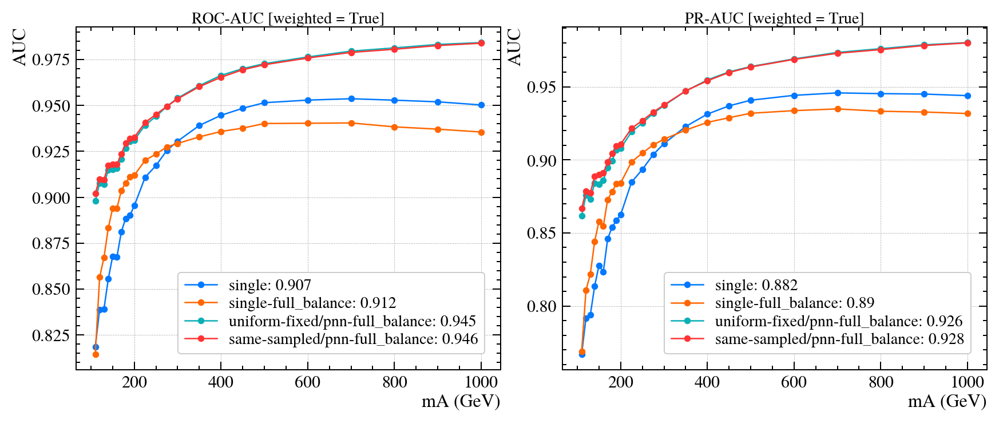

In [13]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

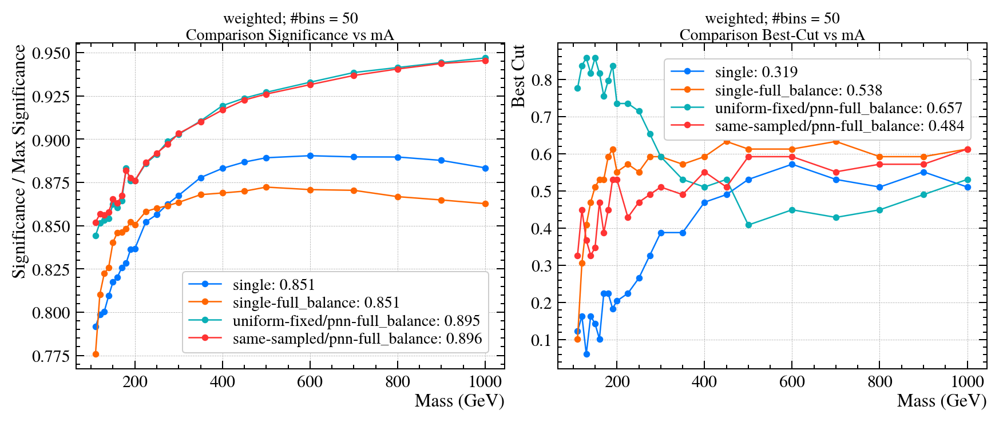

In [14]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

---

## Affine Architecture
### Uniform (fixed)

Full-balance + preprocessing:

In [ ]:
train, valid = cms.data.BalancedUniformSequence.get_data(data)

In [30]:
model, checkpoint = utils.get_compiled_affine(data, dropout=0.25, preprocess=preproc, lr=3e-4,
                                              save='benchmark/uniform-fixed/affine-full_balance-preproc', 
                                              kernel_regularizer=tf.keras.regularizers.l2(1e-5),
                                              bias_regularizer=tf.keras.regularizers.l2(1e-6))

In [31]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
989/989 - 25s - loss: 0.2774 - binary_accuracy: 0.8159 - auc: 0.8658 - precision: 0.8167 - recall: 0.9339 - ams: 0.8787 - fool-loss: 0.0000e+00 - class-loss: 0.4112 - lr: 3.0000e-04 - grad-norm: 0.1334 - weight-norm: 21.4576 - reg-losses: 0.0042 - adversarial-loss: 0.0000e+00 - val_loss: 0.0916 - val_binary_accuracy: 0.8011 - val_auc: 0.9072 - val_precision: 0.6832 - val_recall: 0.9274 - val_ams: 0.8028
Epoch 2/50
989/989 - 21s - loss: 0.2408 - binary_accuracy: 0.8980 - auc: 0.9406 - precision: 0.8983 - recall: 0.9555 - ams: 0.9269 - fool-loss: 0.0000e+00 - class-loss: 0.2688 - lr: 3.0000e-04 - grad-norm: 0.1684 - weight-norm: 25.0005 - reg-losses: 0.0055 - adversarial-loss: 0.0000e+00 - val_loss: 0.0839 - val_binary_accuracy: 0.8430 - val_auc: 0.9312 - val_precision: 0.7384 - val_recall: 0.9343 - val_ams: 0.8342
Epoch 3/50
989/989 - 21s - loss: 0.2395 - binary_accuracy: 0.9062 - auc: 0.9471 - precision: 0.9047 - recall: 0.9607 - ams: 0.9326 - fool-loss: 0.0000e+00 - class-l

In [32]:
utils.load_from_checkpoint(model, path=model.save_path)

Loaded from "weights\benchmark/uniform-fixed/affine-full_balance-preproc\weights-39-0.964"


In [33]:
f = utils.get_compiled_affine(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(f, path='benchmark/uniform-fixed/affine-full_balance-preproc')

g = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(g, path='benchmark/uniform-fixed/pnn-full_balance-preproc')

models = {'affine (uniform-fixed + full)': f, 'pNN (uniform-fixed + full)': g}

Loaded from "weights\benchmark/uniform-fixed/affine-full_balance-preproc\weights-39-0.964"
Loaded from "weights\benchmark/uniform-fixed/pnn-full_balance-preproc\weights-44-0.962"


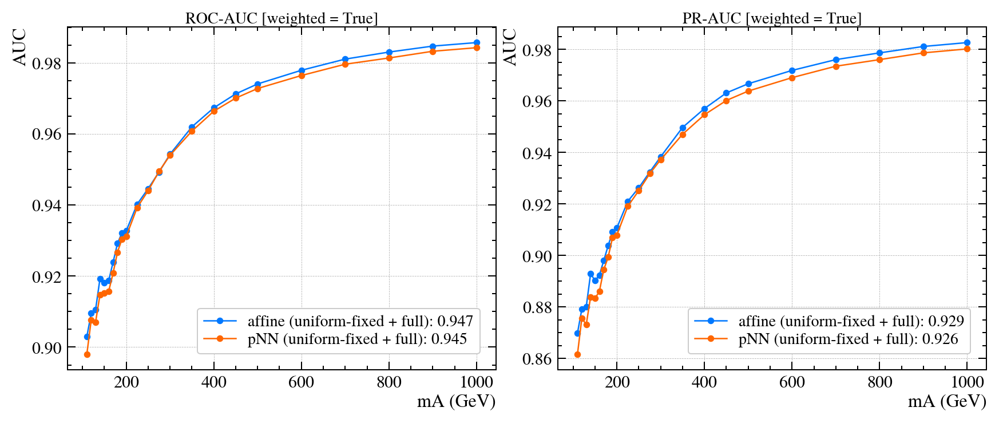

In [34]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

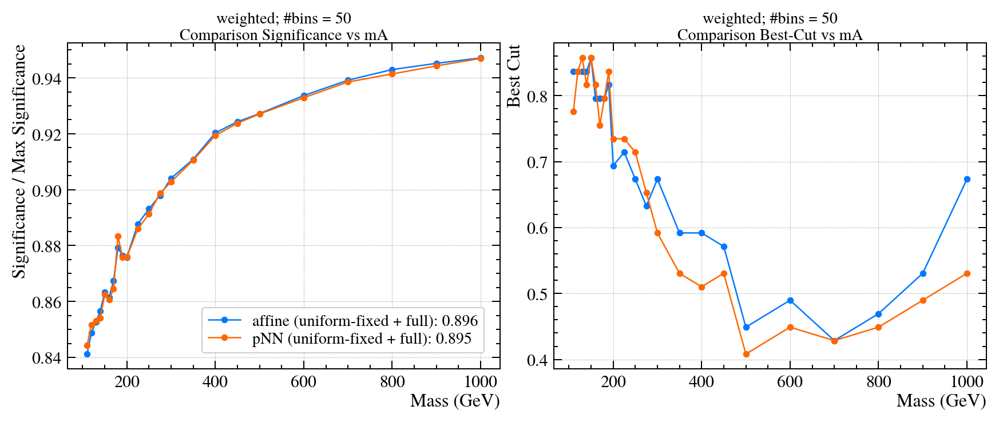

In [35]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

### Uniform (sampled)
Full-balance + preprocessing:

In [36]:
train, valid = cms.data.BalancedUniformSequence.get_data(data, sample_mass=True)

In [37]:
model, checkpoint = utils.get_compiled_affine(data, dropout=0.25, preprocess=preproc, lr=3e-4,
                                           save='benchmark/uniform-sampled/affine-full_balance-preproc', 
                                           kernel_regularizer=tf.keras.regularizers.l2(1e-5),
                                           bias_regularizer=tf.keras.regularizers.l2(1e-6))

In [38]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
989/989 - 18s - loss: 0.3055 - binary_accuracy: 0.8209 - auc: 0.8683 - precision: 0.8155 - recall: 0.9457 - ams: 0.8803 - fool-loss: 0.0000e+00 - class-loss: 0.4056 - lr: 3.0000e-04 - grad-norm: 0.1265 - weight-norm: 21.2273 - reg-losses: 0.0041 - adversarial-loss: 0.0000e+00 - val_loss: 0.0858 - val_binary_accuracy: 0.7994 - val_auc: 0.9071 - val_precision: 0.6791 - val_recall: 0.9352 - val_ams: 0.8031
Epoch 2/50
989/989 - 15s - loss: 0.2720 - binary_accuracy: 0.8980 - auc: 0.9405 - precision: 0.8978 - recall: 0.9561 - ams: 0.9271 - fool-loss: 0.0000e+00 - class-loss: 0.2681 - lr: 3.0000e-04 - grad-norm: 0.1592 - weight-norm: 24.7352 - reg-losses: 0.0054 - adversarial-loss: 0.0000e+00 - val_loss: 0.0710 - val_binary_accuracy: 0.8319 - val_auc: 0.9303 - val_precision: 0.7147 - val_recall: 0.9579 - val_ams: 0.8367
Epoch 3/50
989/989 - 16s - loss: 0.2392 - binary_accuracy: 0.9069 - auc: 0.9483 - precision: 0.9046 - recall: 0.9619 - ams: 0.9331 - fool-loss: 0.0000e+00 - class-l

In [39]:
utils.load_from_checkpoint(model, path=model.save_path)

Loaded from "weights\benchmark/uniform-sampled/affine-full_balance-preproc\weights-38-0.966"


In [41]:
f = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(f, path='benchmark/uniform-sampled/pnn-full_balance-preproc')

g = utils.get_compiled_affine(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(g, path='benchmark/uniform-sampled/affine-full_balance-preproc')

models = {'pNN (uniform-sampled + full)': f, 'affine (uniform-sampled + full)': g}

Loaded from "weights\benchmark/uniform-sampled/pnn-full_balance-preproc\weights-06-0.962"
Loaded from "weights\benchmark/uniform-sampled/affine-full_balance-preproc\weights-38-0.966"


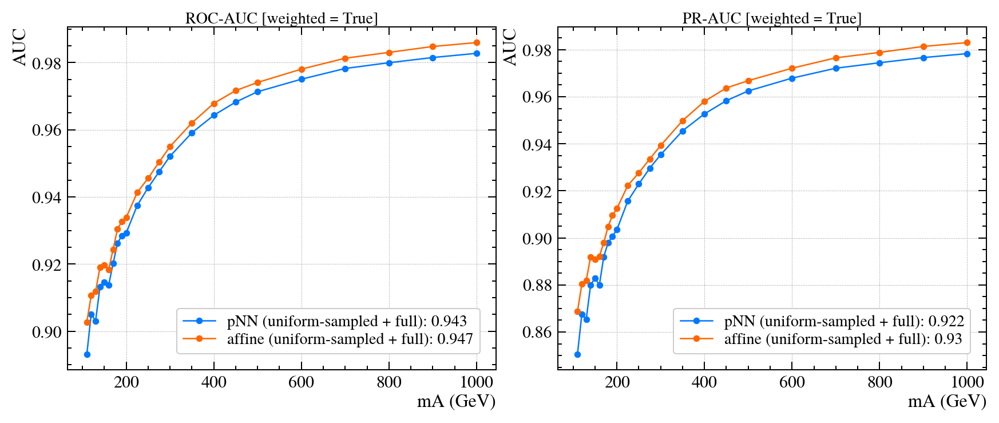

In [42]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

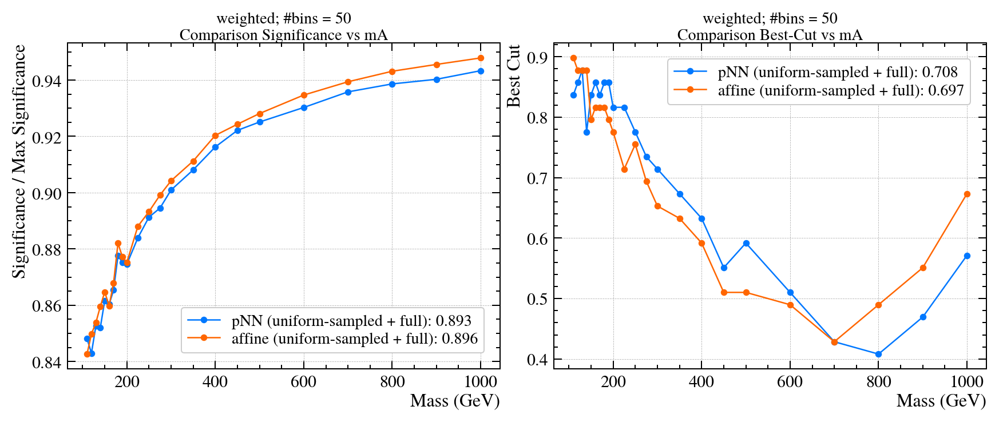

In [43]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

### Same (fixed)
Full-balance + preprocessing:

In [44]:
del train, valid, model, checkpoint
free_mem()

train, valid = cms.data.FullBalancedSequence.get_data(data, intervals=data.default_intervals, 
                                                      sample_mass=False)

In [45]:
model, checkpoint = utils.get_compiled_affine(data, dropout=0.25, preprocess=preproc, lr=3e-4,
                                              save='benchmark/same-fixed/affine-full_balance-preproc',
                                              kernel_regularizer=tf.keras.regularizers.l2(1e-5),
                                              bias_regularizer=tf.keras.regularizers.l2(1e-6))

In [46]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
732/732 - 30s - loss: 0.4565 - binary_accuracy: 0.6268 - auc: 0.6956 - precision: 0.5974 - recall: 0.8817 - ams: 0.7474 - fool-loss: 0.0000e+00 - class-loss: 0.6137 - lr: 3.0000e-04 - grad-norm: 0.0477 - weight-norm: 14.9284 - reg-losses: 0.0020 - adversarial-loss: 0.0000e+00 - val_loss: 0.1338 - val_binary_accuracy: 0.8734 - val_auc: 0.9459 - val_precision: 0.8169 - val_recall: 0.8766 - val_ams: 0.8466
Epoch 2/50
732/732 - 27s - loss: 0.3695 - binary_accuracy: 0.8329 - auc: 0.9041 - precision: 0.8151 - recall: 0.8808 - ams: 0.8510 - fool-loss: 0.0000e+00 - class-loss: 0.3855 - lr: 3.0000e-04 - grad-norm: 0.1335 - weight-norm: 21.2761 - reg-losses: 0.0037 - adversarial-loss: 0.0000e+00 - val_loss: 0.0967 - val_binary_accuracy: 0.9030 - val_auc: 0.9665 - val_precision: 0.8461 - val_recall: 0.9227 - val_ams: 0.8839
Epoch 3/50
732/732 - 27s - loss: 0.3389 - binary_accuracy: 0.8505 - auc: 0.9199 - precision: 0.8316 - recall: 0.8960 - ams: 0.8666 - fool-loss: 0.0000e+00 - class-l

In [47]:
utils.load_from_checkpoint(model, path=model.save_path)

Loaded from "weights\benchmark/same-fixed/affine-full_balance-preproc\weights-50-0.982"


In [48]:
f = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(f, path='benchmark/same-fixed/pnn-full_balance-preproc-2')

g = utils.get_compiled_affine(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(g, path='benchmark/same-fixed/affine-full_balance-preproc')

models = {'pNN (same-fixed + full)': f, 'affine (same-fixed + full)': g}

Loaded from "weights\benchmark/same-fixed/pnn-full_balance-preproc-2\weights-44-0.981"
Loaded from "weights\benchmark/same-fixed/affine-full_balance-preproc\weights-50-0.982"


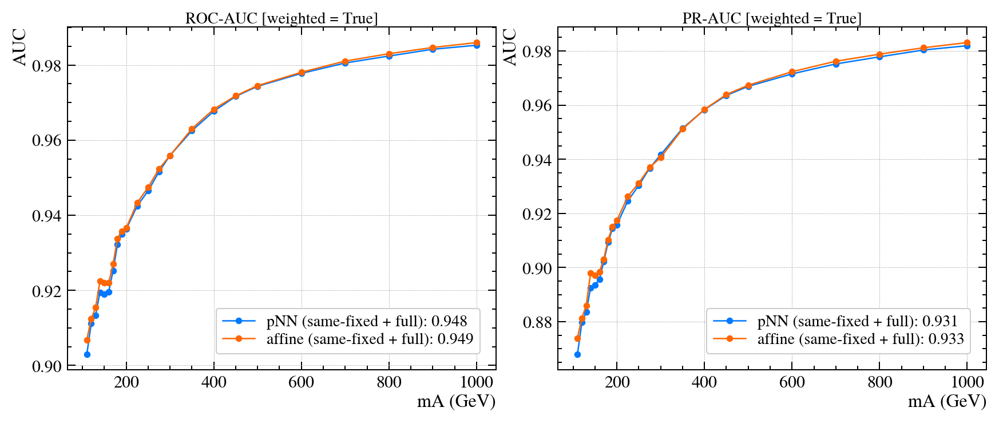

In [49]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

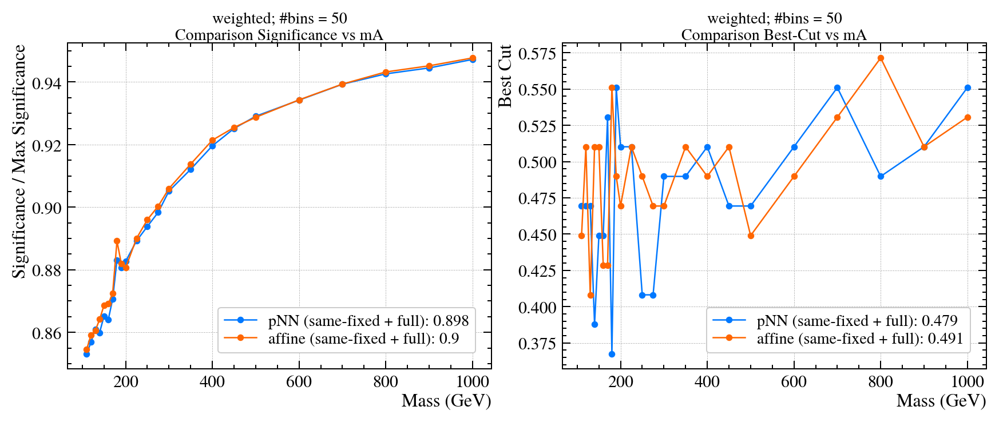

In [50]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

### Same (sampled)
Full-balance + preprocessing:

In [51]:
train, valid = cms.data.FullBalancedSequence.get_data(data, intervals=data.default_intervals, 
                                                      sample_mass=True)

In [52]:
model, checkpoint = utils.get_compiled_affine(data, dropout=0.25, preprocess=preproc, lr=3e-4,
                                              save='benchmark/same-sampled/affine-full_balance-preproc',
                                              kernel_regularizer=tf.keras.regularizers.l2(1e-5),
                                              bias_regularizer=tf.keras.regularizers.l2(1e-6))

In [53]:
model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])

Epoch 1/50
732/732 - 30s - loss: 0.4727 - binary_accuracy: 0.6111 - auc: 0.6712 - precision: 0.5855 - recall: 0.8818 - ams: 0.7430 - fool-loss: 0.0000e+00 - class-loss: 0.6275 - lr: 3.0000e-04 - grad-norm: 0.0453 - weight-norm: 14.7133 - reg-losses: 0.0019 - adversarial-loss: 0.0000e+00 - val_loss: 0.1252 - val_binary_accuracy: 0.8554 - val_auc: 0.9398 - val_precision: 0.7823 - val_recall: 0.8795 - val_ams: 0.8300
Epoch 2/50
732/732 - 27s - loss: 0.3528 - binary_accuracy: 0.8316 - auc: 0.9021 - precision: 0.8119 - recall: 0.8831 - ams: 0.8506 - fool-loss: 0.0000e+00 - class-loss: 0.3884 - lr: 3.0000e-04 - grad-norm: 0.1236 - weight-norm: 21.7468 - reg-losses: 0.0039 - adversarial-loss: 0.0000e+00 - val_loss: 0.0950 - val_binary_accuracy: 0.9010 - val_auc: 0.9682 - val_precision: 0.8408 - val_recall: 0.9251 - val_ams: 0.8826
Epoch 3/50
732/732 - 27s - loss: 0.3403 - binary_accuracy: 0.8509 - auc: 0.9202 - precision: 0.8311 - recall: 0.8978 - ams: 0.8670 - fool-loss: 0.0000e+00 - class-l

In [54]:
utils.load_from_checkpoint(model, path=model.save_path)

Loaded from "weights\benchmark/same-sampled/affine-full_balance-preproc\weights-49-0.982"


In [55]:
f = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(f, path='benchmark/same-sampled/pnn-full_balance-preproc-2')

g = utils.get_compiled_affine(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(g, path='benchmark/same-sampled/affine-full_balance-preproc')

models = {'pNN (same-sampled + full)': f, 'affine (same-sampled + full)': g}

Loaded from "weights\benchmark/same-sampled/pnn-full_balance-preproc-2\weights-43-0.982"
Loaded from "weights\benchmark/same-sampled/affine-full_balance-preproc\weights-49-0.982"


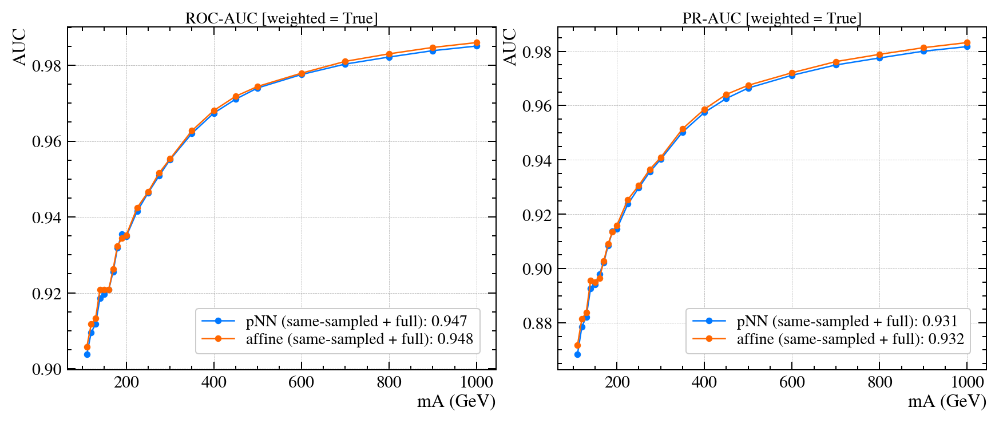

In [56]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

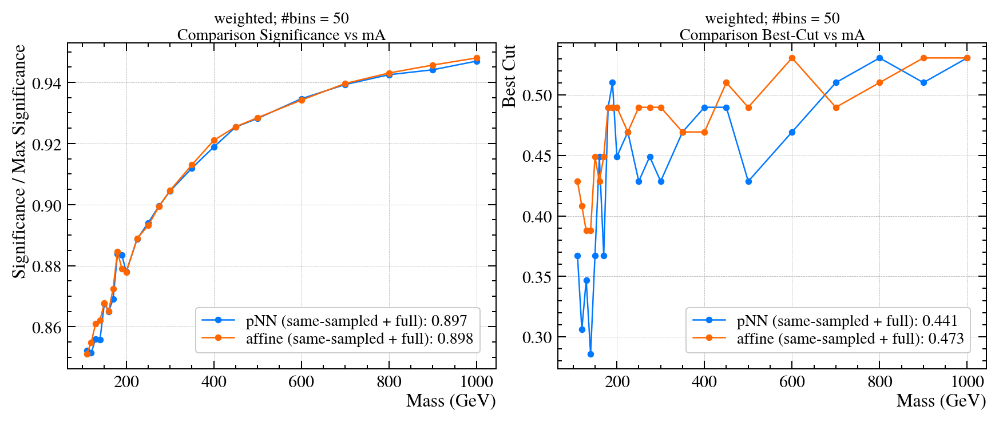

In [57]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

### Individual NNs
One NN for a specific mA, $|m_A|$ networks in total.
* All the background is used to fit each mA.

No-balance + preprocessing:

In [11]:
for mass in data.unique_signal_mass:
    print(f'==== {int(mass)}mA ====')
    
    # select signal
    s = data.signal[data.signal['mA'] == mass].copy()
    
    # make dataset
    data_m = Benchmark()
    data_m.load(signal=s, bkg=data.background)
    
    # split, and create sequences
    train, valid = cms.data.train_valid_split(data_m)
    
    train = cms.data.SimpleEvalSequence(signal=train[0], background=train[1], batch_size=1024,
                                        features=data.columns['feature'], sample_mass=False,
                                        weight_column=None)

    valid = cms.data.SimpleEvalSequence(signal=valid[0], background=valid[1], batch_size=1024,
                                        features=data.columns['feature'], sample_mass=False)
    # create model
    model, checkpoint = utils.get_compiled_non_parametric(
            data_m, save=f'benchmark/individual/nn-{int(mass)}-preproc', 
            lr=3e-4, dropout=0.25, preprocess=preproc,
            kernel_regularizer=tf.keras.regularizers.l2(1e-4),
            bias_regularizer=tf.keras.regularizers.l2(1e-5))
    
    # train & load
    model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])
    utils.load_from_checkpoint(model, path=model.save_path)
    
    # clear variables
    del s, train, valid, model, checkpoint
    del data_m.signal, data_m.background, data_m.ds, data_m
    
    free_mem()
    

==== 110mA ====
[signal] loading...
[background] loading...
dataset loaded.
Epoch 1/50
444/444 - 10s - loss: 0.0463 - binary_accuracy: 0.9935 - auc: 0.7675 - precision: 0.0021 - recall: 0.0020 - ams: 0.0817 - class-loss: 0.0783 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.0846 - weight-norm: 19.3371 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0372 - val_loss: 0.0461 - val_binary_accuracy: 0.9967 - val_auc: 0.8440 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_ams: 0.1802
Epoch 2/50
444/444 - 7s - loss: 0.0433 - binary_accuracy: 0.9967 - auc: 0.8688 - precision: 0.0000e+00 - recall: 0.0000e+00 - ams: 0.1756 - class-loss: 0.0438 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.0301 - weight-norm: 16.4641 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0269 - val_loss: 0.0356 - val_binary_accuracy: 0.9967 - val_auc: 0.8695 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_ams: 0.2191
Epoch 3/50
444/444 - 8s - loss: 0.0299 - binary_accuracy: 0.9967 

Full-balance + preprocessing:

In [12]:
for mass in data.unique_signal_mass:
    print(f'==== {int(mass)}mA ====')
    
    # select signal
    s = data.signal[data.signal['mA'] == mass].copy()
    
    # make dataset
    data_m = Benchmark()
    data_m.load(signal=s, bkg=data.background)
    
    # split, and create sequences
    train, valid = cms.data.BalancedUniformSequence.get_data(data_m)
    
    # create model
    model, checkpoint = utils.get_compiled_non_parametric(
            data_m, save=f'benchmark/individual-full/nn-{int(mass)}-preproc', 
            lr=3e-4, dropout=0.25, preprocess=preproc,
            kernel_regularizer=tf.keras.regularizers.l2(1e-4),
            bias_regularizer=tf.keras.regularizers.l2(1e-5))
    
    # train & load
    model.fit(x=train, epochs=50, validation_data=valid, verbose=2, callbacks=[checkpoint])
    utils.load_from_checkpoint(model, path=model.save_path)
    
    # clear variables
    del s, train, valid, model, checkpoint
    del data_m.signal, data_m.background, data_m.ds, data_m
    
    free_mem()
    

==== 110mA ====
[signal] loading...
[background] loading...
dataset loaded.
Epoch 1/50
591/591 - 12s - loss: 0.3565 - binary_accuracy: 0.8476 - auc: 0.8814 - precision: 0.8457 - recall: 0.9434 - ams: 0.8943 - class-loss: 0.4129 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.1787 - weight-norm: 19.2983 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0370 - val_loss: 0.0343 - val_binary_accuracy: 0.8787 - val_auc: 0.9605 - val_precision: 0.0245 - val_recall: 0.9202 - val_ams: 0.2314
Epoch 2/50
591/591 - 9s - loss: 0.3349 - binary_accuracy: 0.8745 - auc: 0.9009 - precision: 0.8644 - recall: 0.9627 - ams: 0.9136 - class-loss: 0.3533 - fool-loss: 0.0000e+00 - lr: 3.0000e-04 - grad-norm: 0.2299 - weight-norm: 17.7621 - adversarial-loss: 0.0000e+00 - reg-losses: 0.0312 - val_loss: 0.0309 - val_binary_accuracy: 0.8893 - val_auc: 0.9583 - val_precision: 0.0265 - val_recall: 0.9082 - val_ams: 0.2376
Epoch 3/50
591/591 - 9s - loss: 0.3082 - binary_accuracy: 0.8923 - auc: 0.9101 - precisio

Comparison:

In [13]:
individual = cms.IndividualNNs.load(test, path_format='benchmark/individual/nn-{}-preproc',
                                    dropout=0.25, preprocess=preproc)

individual_full = cms.IndividualNNs.load(test, dropout=0.25, preprocess=preproc,
                                         path_format='benchmark/individual-full/nn-{}-preproc')

model = utils.get_compiled_pnn(test, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(model, path='benchmark/same-sampled/pnn-full_balance-preproc')

models = {'same-sampled (full)': model, 'individual': individual,
          'individual (full)': individual_full}

Loaded from "weights\benchmark/individual/nn-110-preproc\weights-24-0.942"
Loaded from "weights\benchmark/individual/nn-120-preproc\weights-30-0.960"
Loaded from "weights\benchmark/individual/nn-130-preproc\weights-14-0.939"
Loaded from "weights\benchmark/individual/nn-140-preproc\weights-42-0.952"
Loaded from "weights\benchmark/individual/nn-150-preproc\weights-29-0.946"
Loaded from "weights\benchmark/individual/nn-160-preproc\weights-39-0.935"
Loaded from "weights\benchmark/individual/nn-170-preproc\weights-29-0.938"
Loaded from "weights\benchmark/individual/nn-180-preproc\weights-49-0.946"
Loaded from "weights\benchmark/individual/nn-190-preproc\weights-13-0.946"
Loaded from "weights\benchmark/individual/nn-200-preproc\weights-41-0.959"
Loaded from "weights\benchmark/individual/nn-225-preproc\weights-28-0.963"
Loaded from "weights\benchmark/individual/nn-250-preproc\weights-34-0.958"
Loaded from "weights\benchmark/individual/nn-275-preproc\weights-39-0.968"
Loaded from "weights\benc

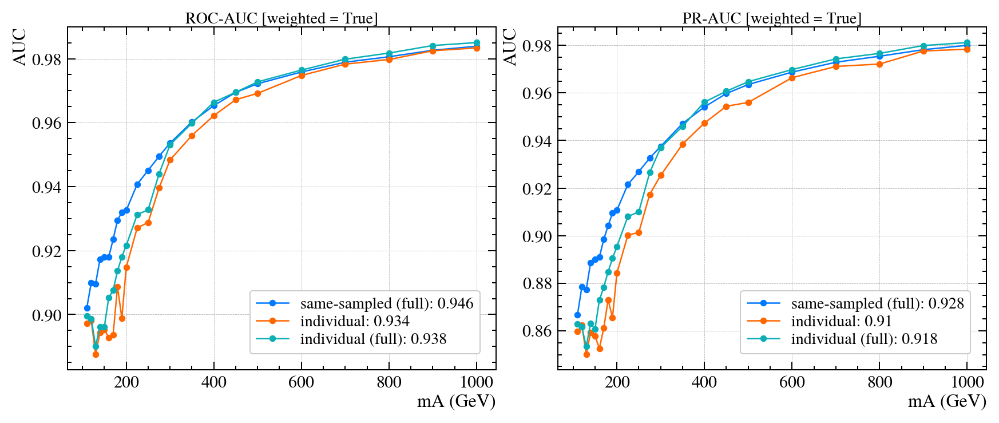

In [14]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()

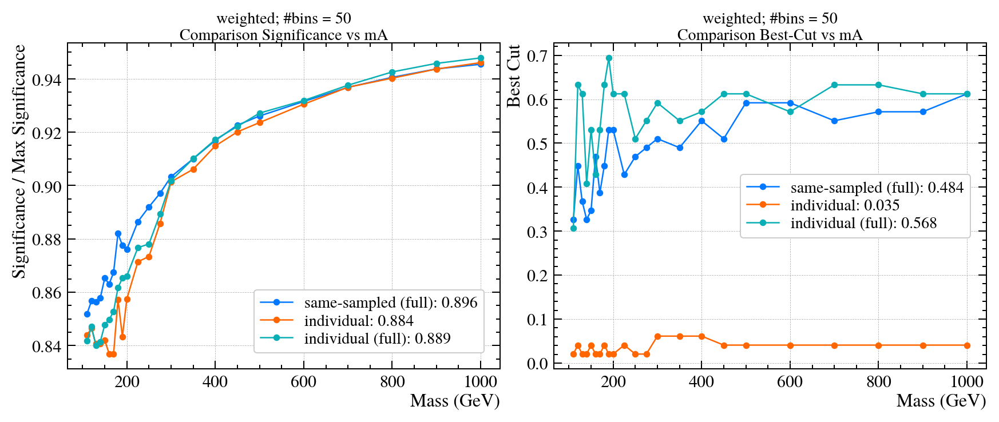

In [15]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

---
## Feature Importance & Mass Reliance
i.e. the degree (amount) of parametrization.

In [8]:
def mask_dense_pnn(model, feature_index=-1):
    # find dense layer
    for i, layer in enumerate(model.layers):
        if isinstance(layer, tf.keras.layers.Concatenate):
            break

    dense = model.layers[i + 1]
    
    # then set weights corresponding to mA to zero
    w, b = dense.get_weights()
    w[feature_index, :] = 0
    
    dense.set_weights([w, b])

In [95]:
model = utils.get_compiled_pnn(data, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(model, path='benchmark/pnn-same-sampled-full_balance-preproc')

mask_dense_pnn(model)

original = utils.get_compiled_pnn(data, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(original, path='benchmark/pnn-same-sampled-full_balance-preproc')

models = {'pNN (zeroed)': model, 'pNN (original)': original}

Loaded from "weights\benchmark/pnn-same-sampled-full_balance-preproc\weights-84-0.986"
Loaded from "weights\benchmark/pnn-same-sampled-full_balance-preproc\weights-84-0.986"


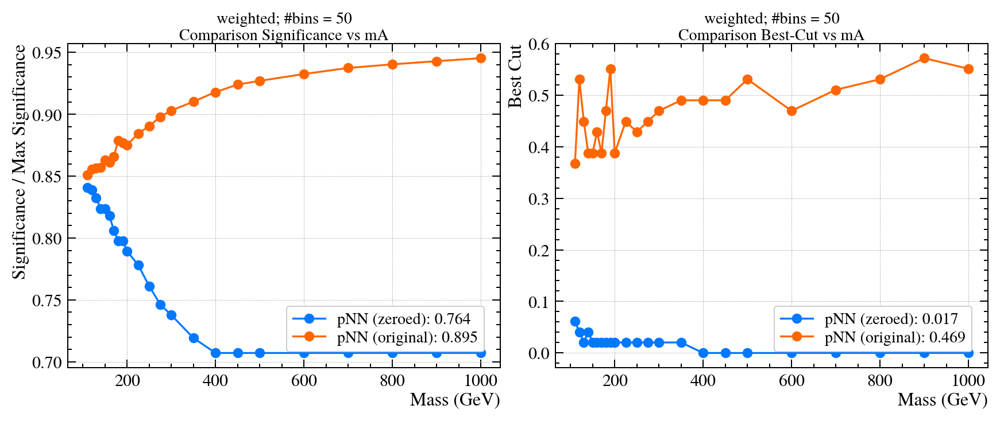

In [86]:
cms.plot.significance_ratio_vs_mass(test, models, bins=50, title='weighted')

Loaded from "weights\benchmark/pnn-same-sampled-full_balance-preproc\weights-84-0.986"
Loaded from "weights\benchmark/pnn-same-sampled-full_balance-preproc\weights-84-0.986"


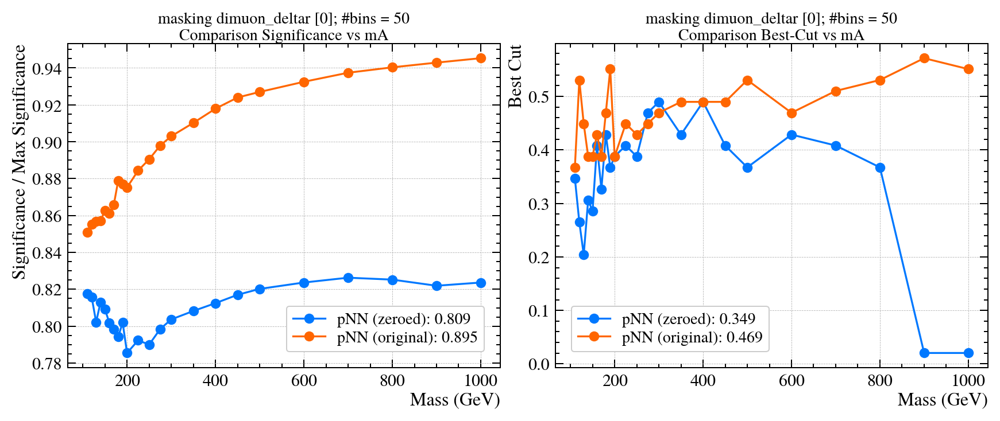

Loaded from "weights\benchmark/pnn-same-sampled-full_balance-preproc\weights-84-0.986"


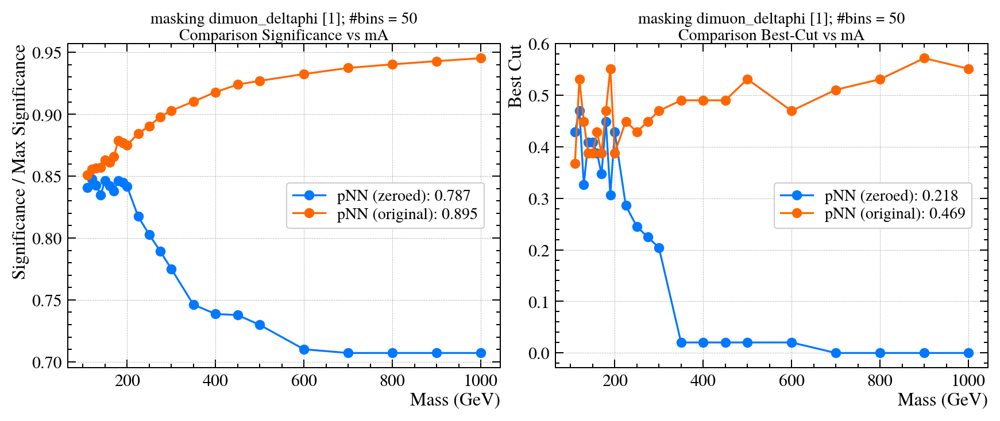

Loaded from "weights\benchmark/pnn-same-sampled-full_balance-preproc\weights-84-0.986"


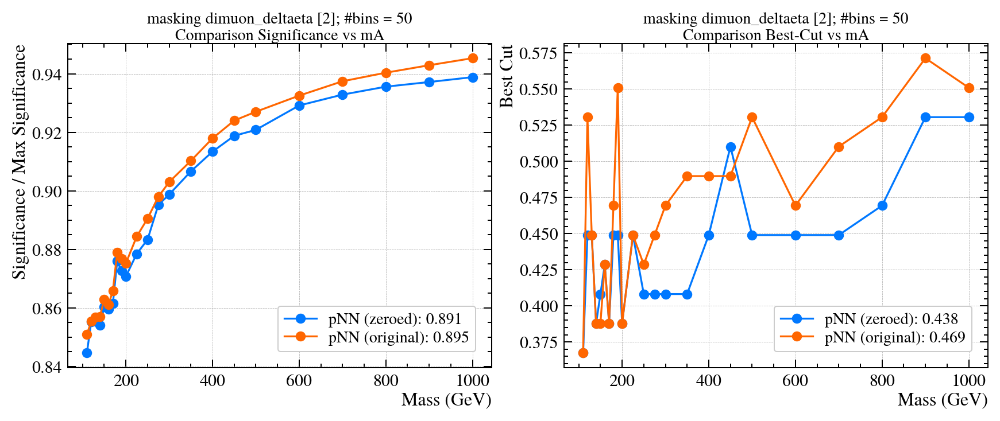

Loaded from "weights\benchmark/pnn-same-sampled-full_balance-preproc\weights-84-0.986"


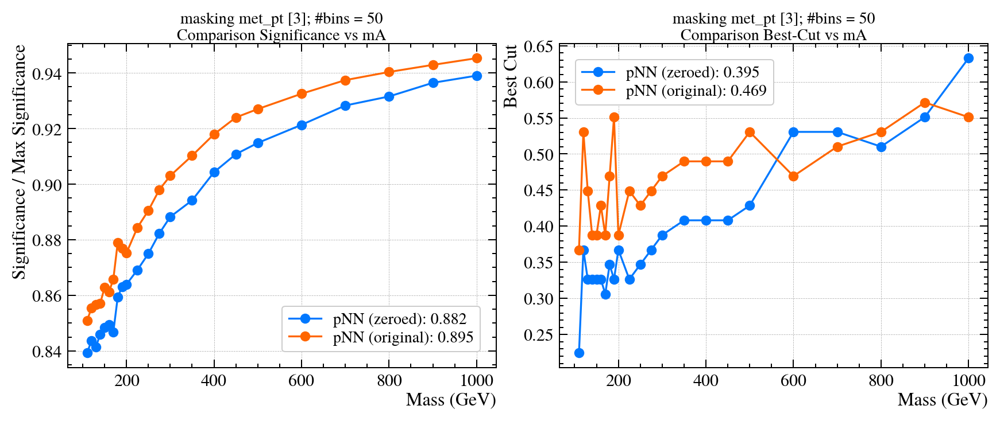

Loaded from "weights\benchmark/pnn-same-sampled-full_balance-preproc\weights-84-0.986"


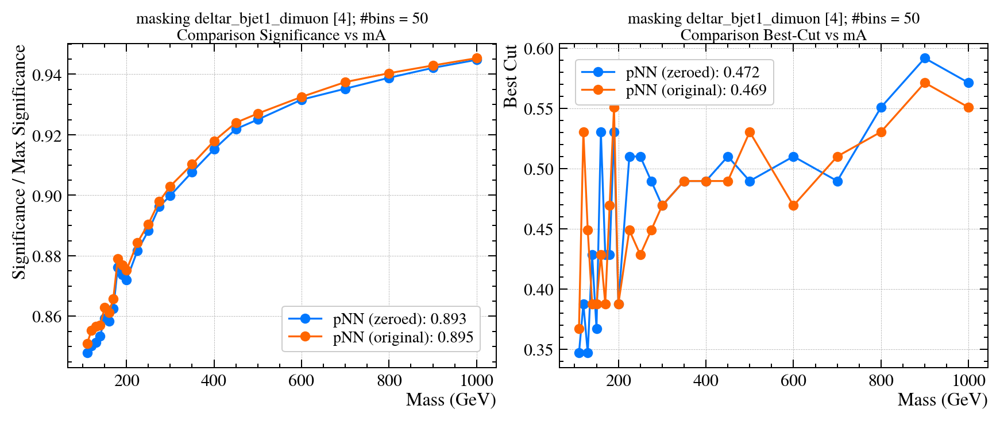

Loaded from "weights\benchmark/pnn-same-sampled-full_balance-preproc\weights-84-0.986"


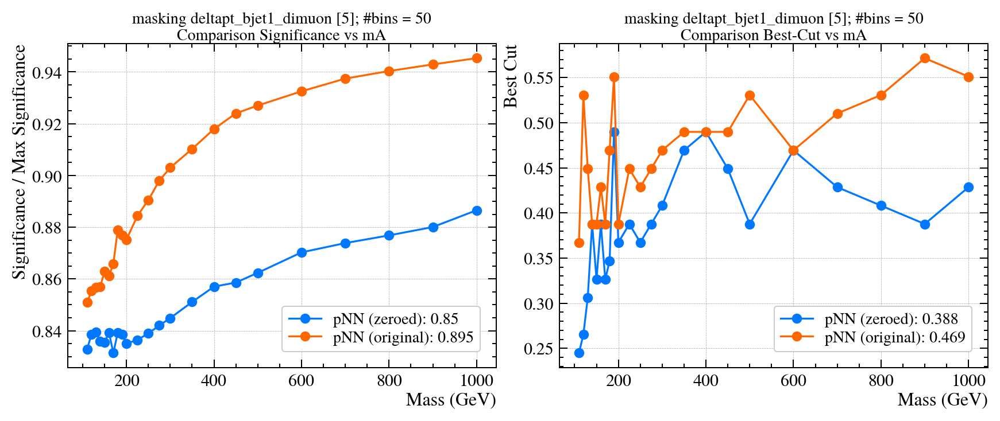

Loaded from "weights\benchmark/pnn-same-sampled-full_balance-preproc\weights-84-0.986"


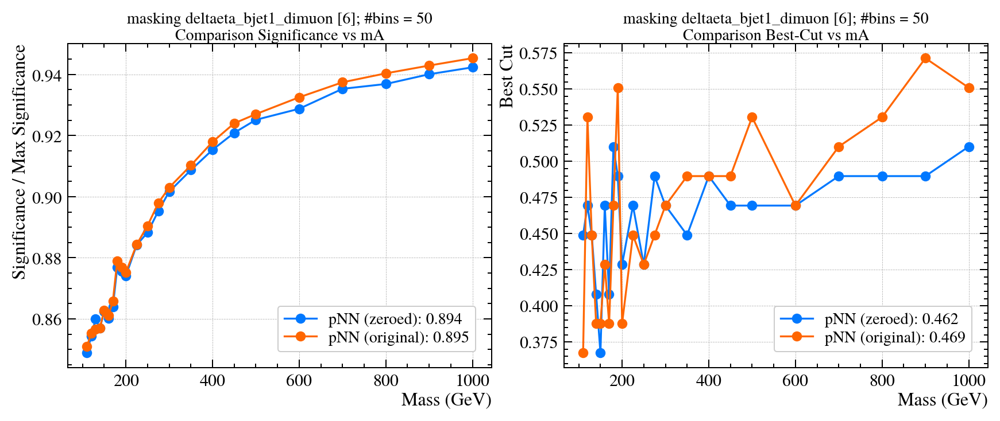

Loaded from "weights\benchmark/pnn-same-sampled-full_balance-preproc\weights-84-0.986"


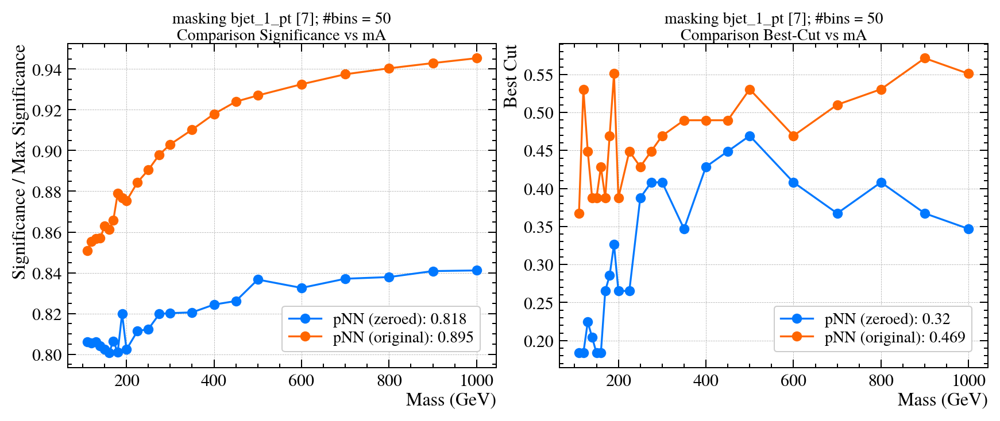

Loaded from "weights\benchmark/pnn-same-sampled-full_balance-preproc\weights-84-0.986"


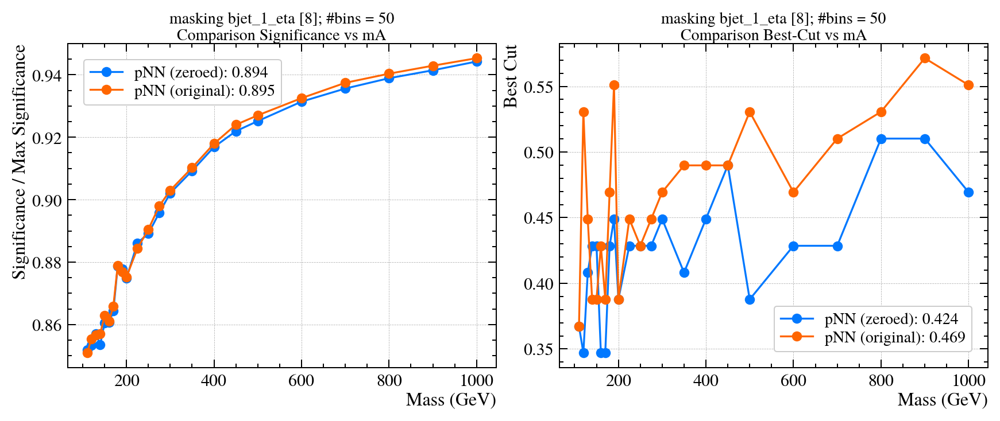

Loaded from "weights\benchmark/pnn-same-sampled-full_balance-preproc\weights-84-0.986"


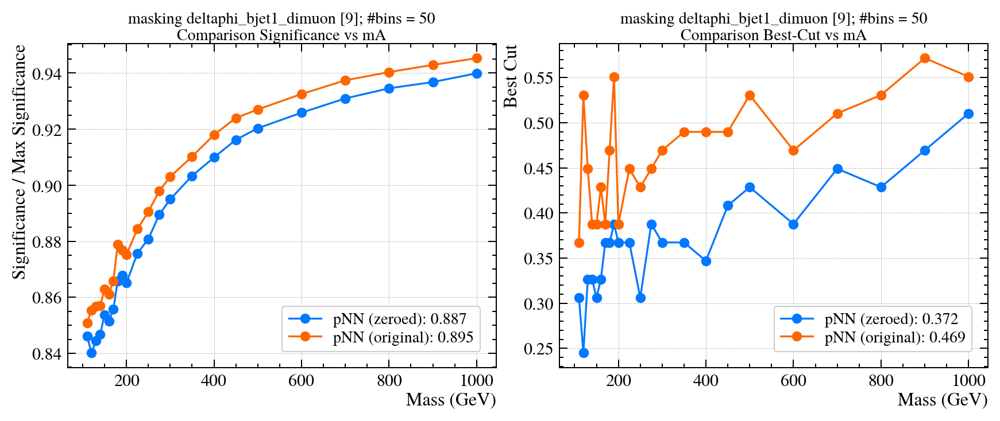

Loaded from "weights\benchmark/pnn-same-sampled-full_balance-preproc\weights-84-0.986"


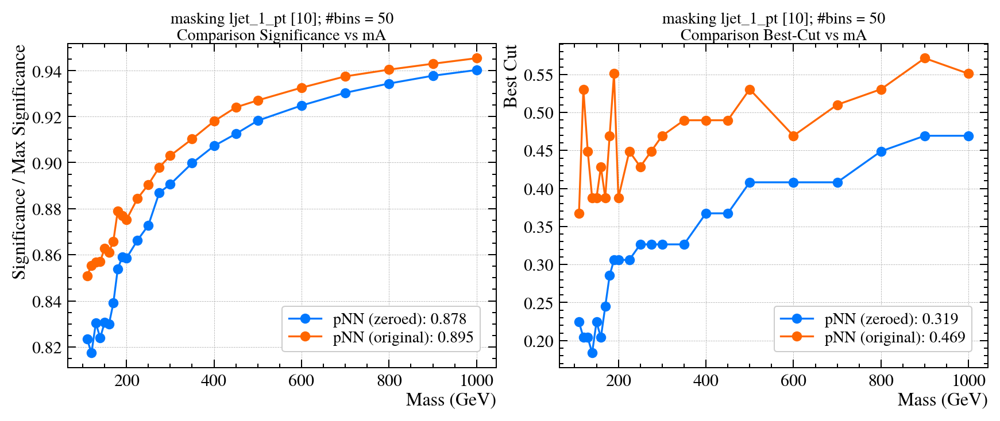

Loaded from "weights\benchmark/pnn-same-sampled-full_balance-preproc\weights-84-0.986"


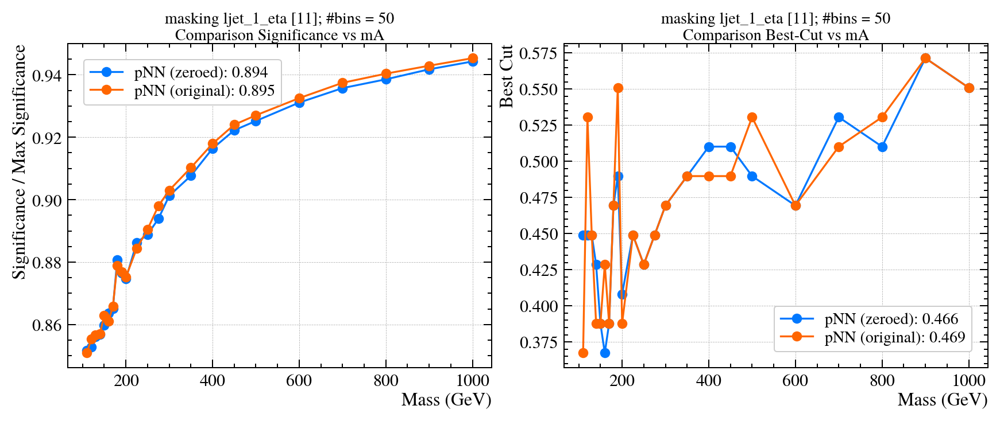

Loaded from "weights\benchmark/pnn-same-sampled-full_balance-preproc\weights-84-0.986"


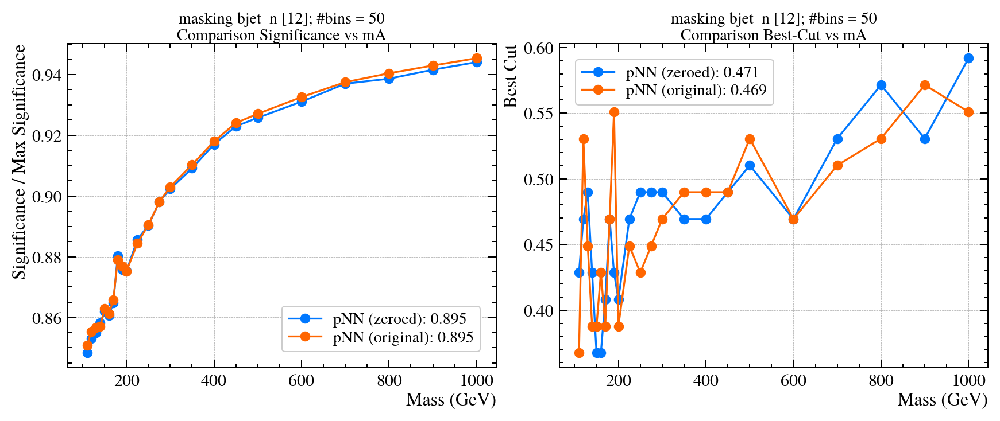

Loaded from "weights\benchmark/pnn-same-sampled-full_balance-preproc\weights-84-0.986"


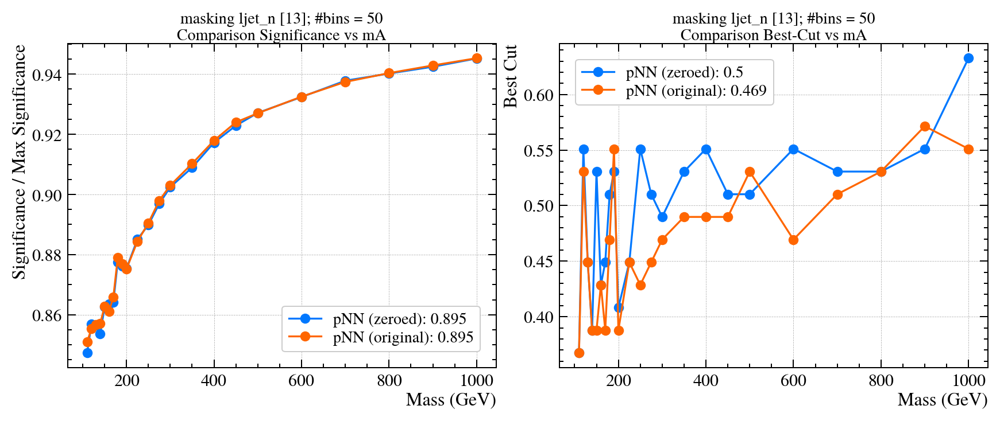

Loaded from "weights\benchmark/pnn-same-sampled-full_balance-preproc\weights-84-0.986"


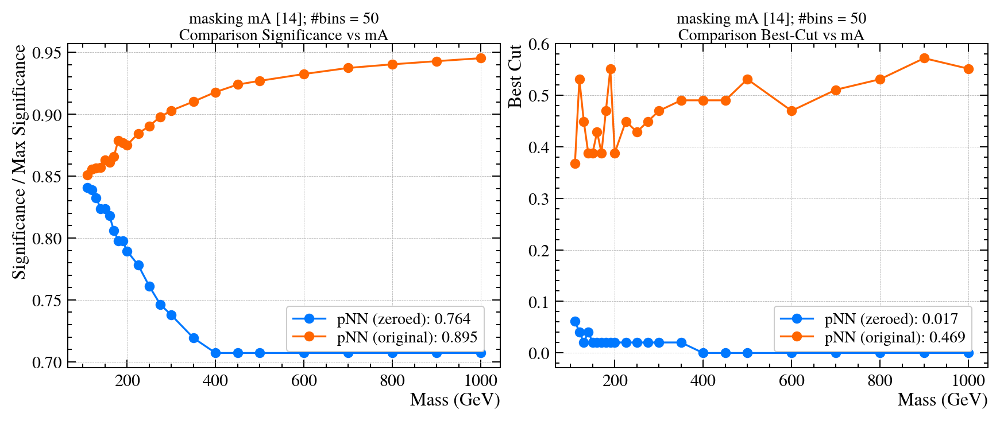

In [100]:
original = utils.get_compiled_pnn(data, dropout=0.25, preprocess=preproc)
utils.load_from_checkpoint(original, path='benchmark/pnn-same-sampled-full_balance-preproc')

for i, var in enumerate(data.columns['feature'] + ['mA']):
    model = utils.get_compiled_pnn(data, dropout=0.25, preprocess=preproc)
    utils.load_from_checkpoint(model, path='benchmark/pnn-same-sampled-full_balance-preproc')

    mask_dense_pnn(model, feature_index=i)

    models = {'pNN (zeroed)': model, 'pNN (original)': original}
    cms.plot.significance_ratio_vs_mass(test, models, bins=50, title=f'masking {var} [{i}]')

* Features that are even weakly (linearly) correlated with mA (e.g. correlation > 0.1-0.2) worsen the performance of the pNN.
* Indeed, dropping mA results in the worst classification.
* This, tells us that to quantify *mass reliance* one has to take into account *direct correlations* (i.e. of `mA`), and *indirect correlations* of other variables with mA.

Loaded from "weights\benchmark/interp/pnn-uniform-fixed-naive\weights-97-0.995"
Loaded from "weights\benchmark/interp/pnn-uniform-fixed-naive\weights-97-0.995"


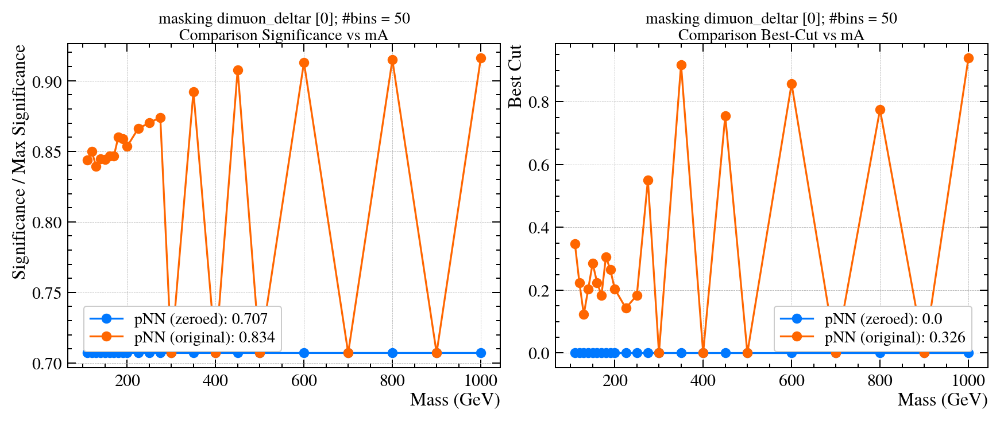

Loaded from "weights\benchmark/interp/pnn-uniform-fixed-naive\weights-97-0.995"


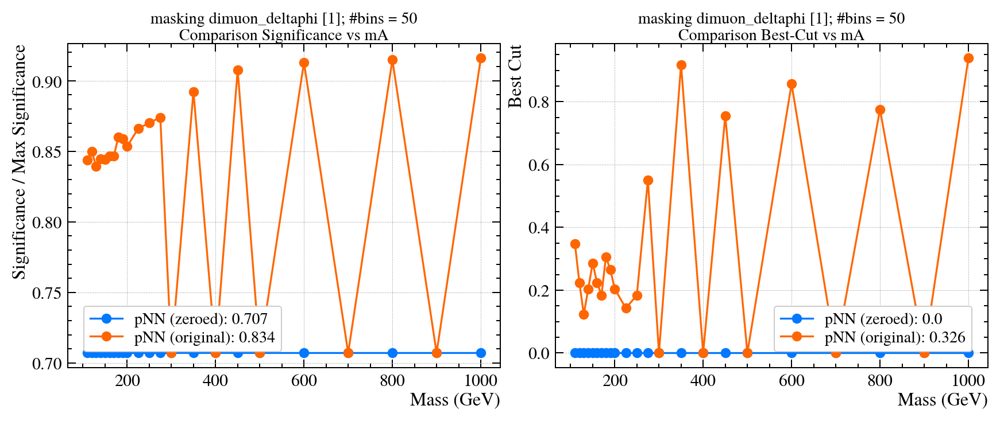

Loaded from "weights\benchmark/interp/pnn-uniform-fixed-naive\weights-97-0.995"


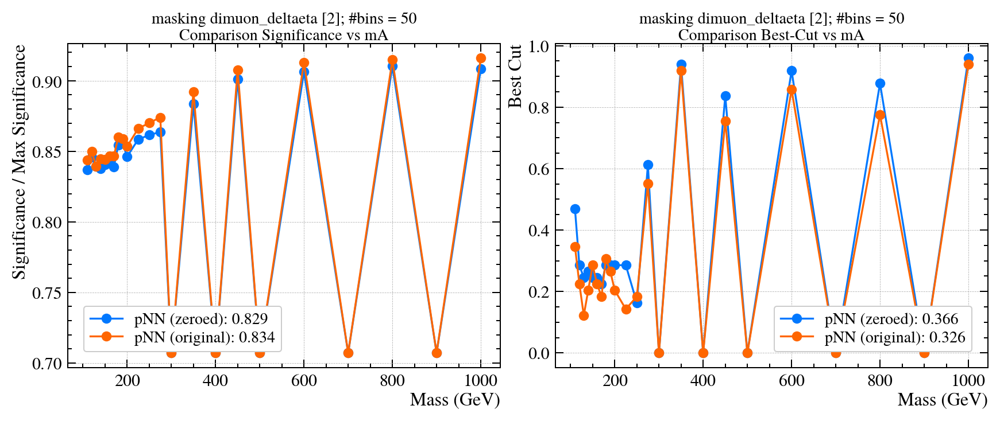

Loaded from "weights\benchmark/interp/pnn-uniform-fixed-naive\weights-97-0.995"


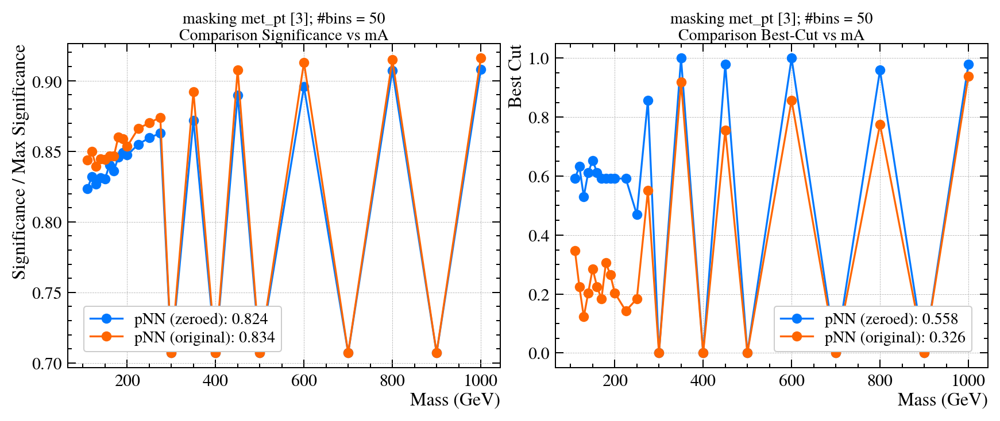

Loaded from "weights\benchmark/interp/pnn-uniform-fixed-naive\weights-97-0.995"


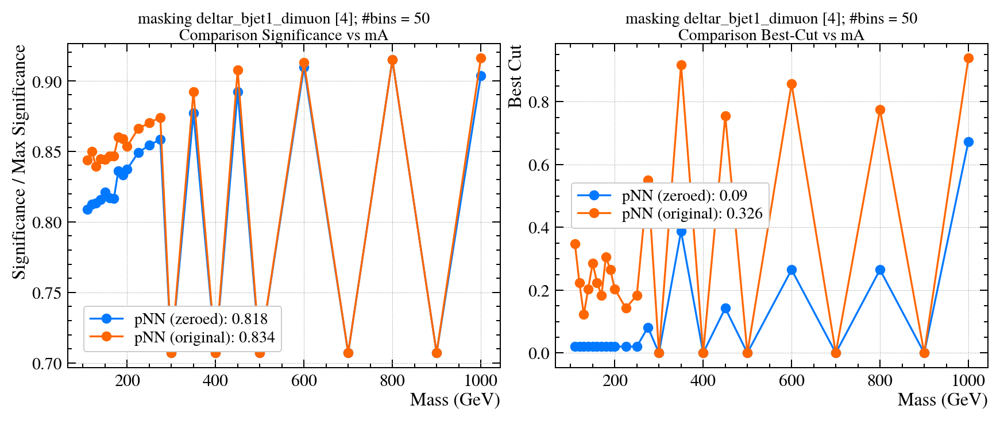

Loaded from "weights\benchmark/interp/pnn-uniform-fixed-naive\weights-97-0.995"


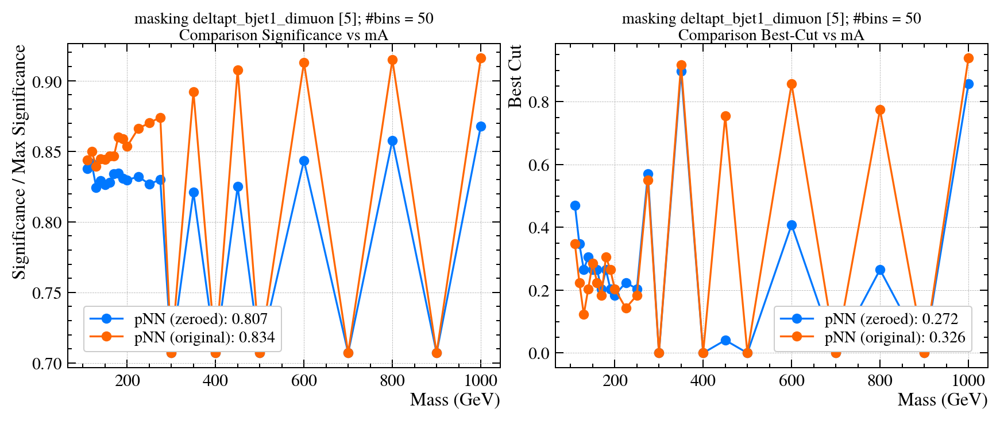

Loaded from "weights\benchmark/interp/pnn-uniform-fixed-naive\weights-97-0.995"


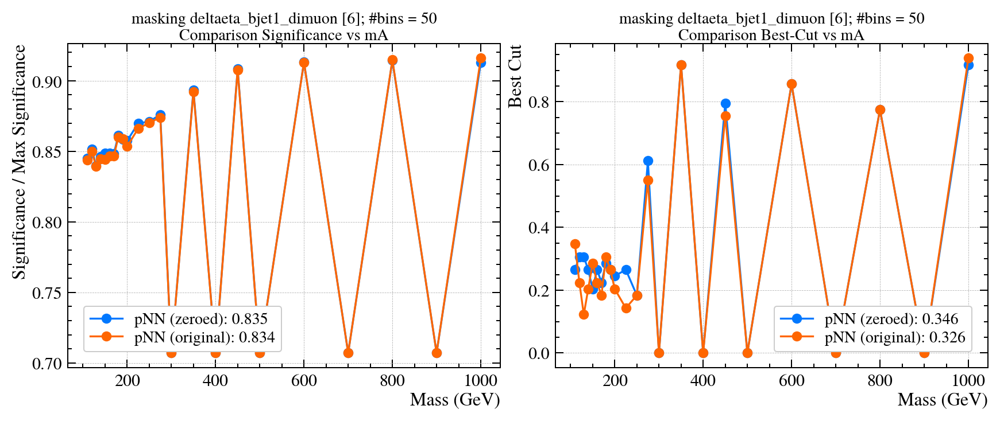

Loaded from "weights\benchmark/interp/pnn-uniform-fixed-naive\weights-97-0.995"


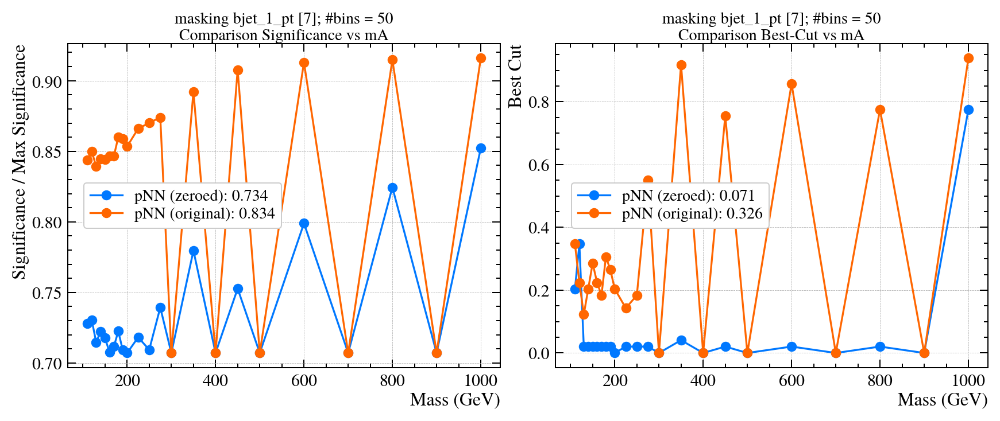

Loaded from "weights\benchmark/interp/pnn-uniform-fixed-naive\weights-97-0.995"


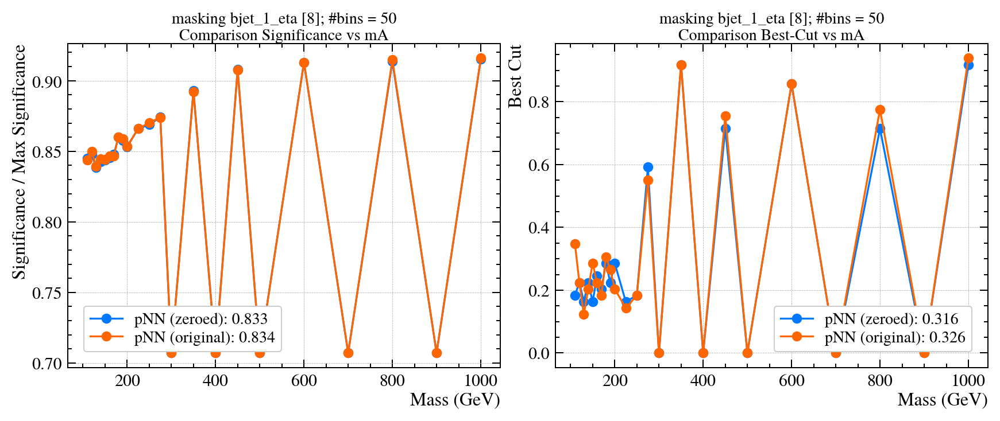

Loaded from "weights\benchmark/interp/pnn-uniform-fixed-naive\weights-97-0.995"


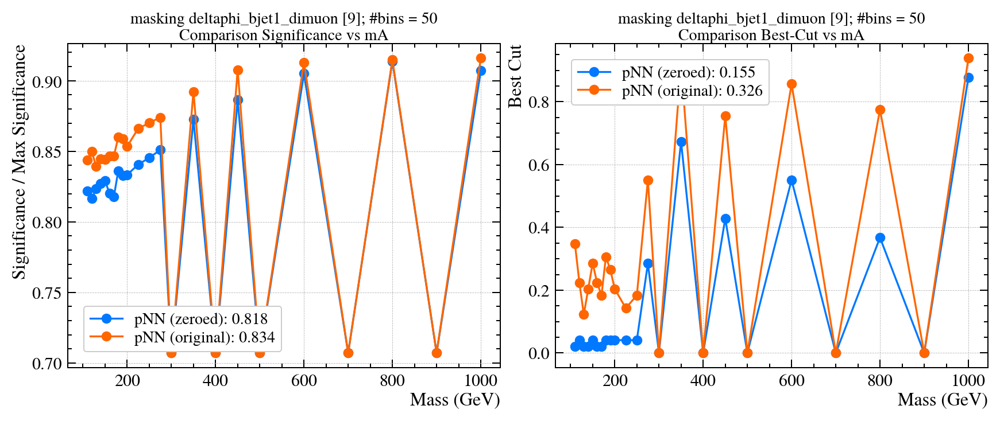

Loaded from "weights\benchmark/interp/pnn-uniform-fixed-naive\weights-97-0.995"


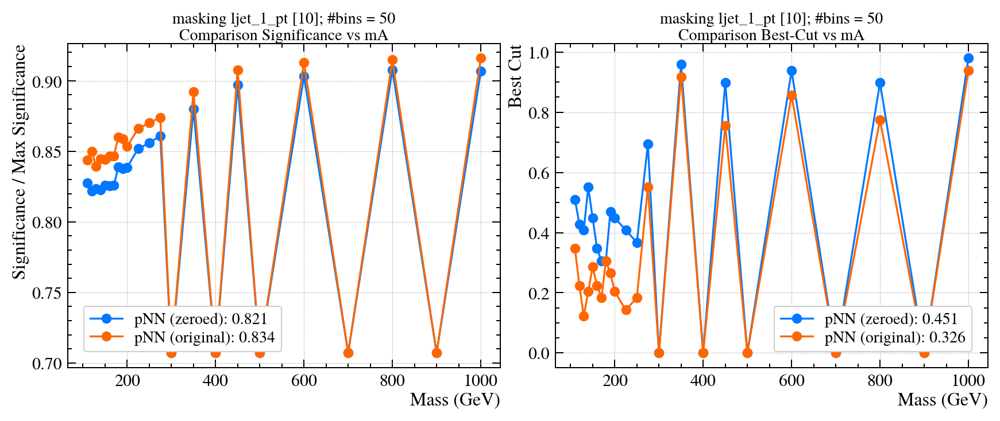

Loaded from "weights\benchmark/interp/pnn-uniform-fixed-naive\weights-97-0.995"


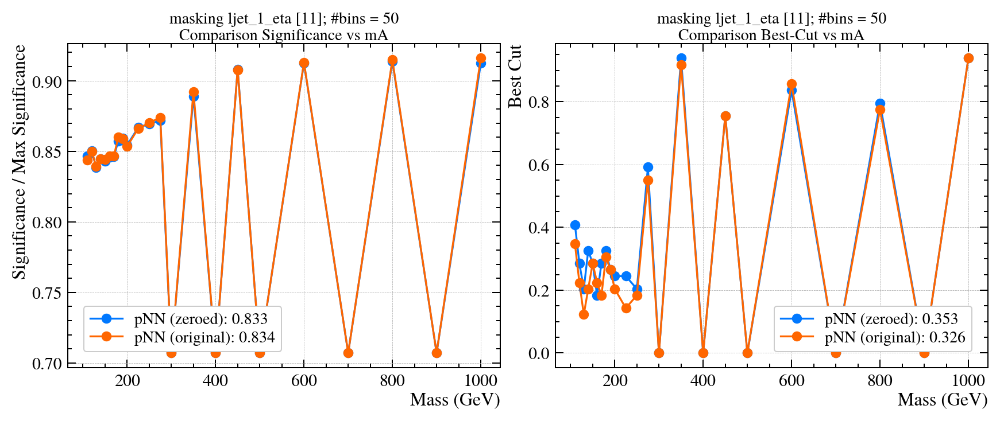

Loaded from "weights\benchmark/interp/pnn-uniform-fixed-naive\weights-97-0.995"


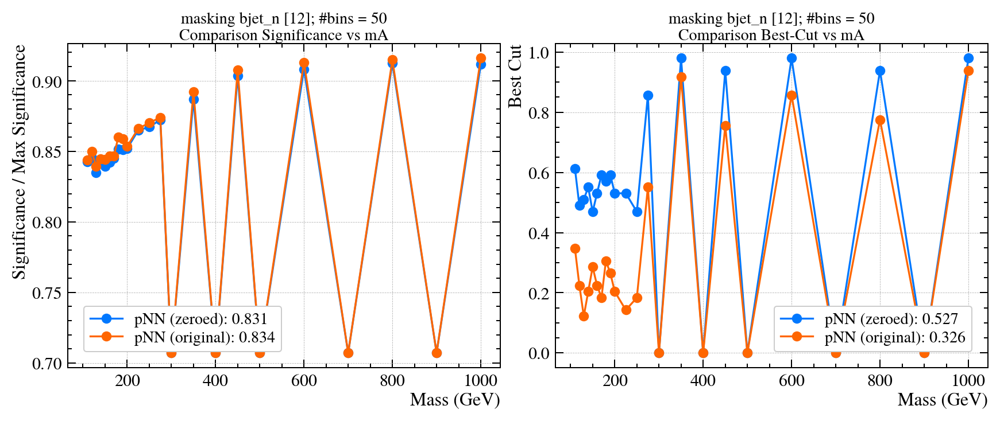

Loaded from "weights\benchmark/interp/pnn-uniform-fixed-naive\weights-97-0.995"


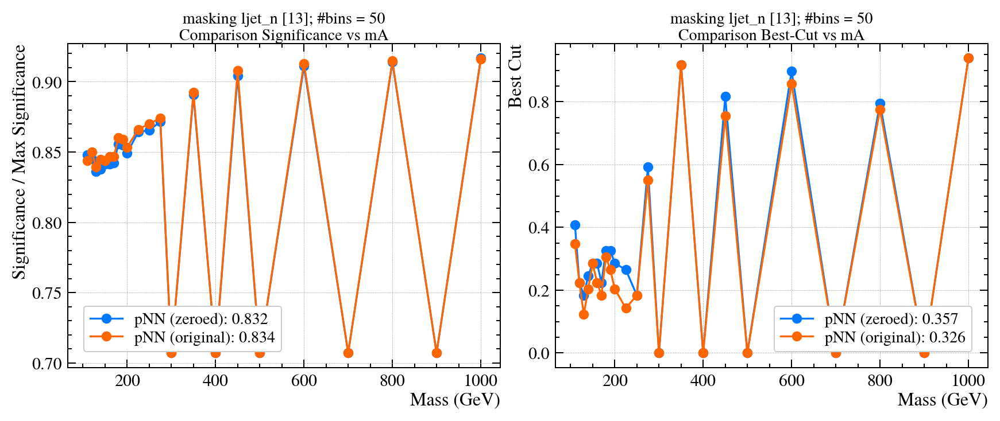

Loaded from "weights\benchmark/interp/pnn-uniform-fixed-naive\weights-97-0.995"


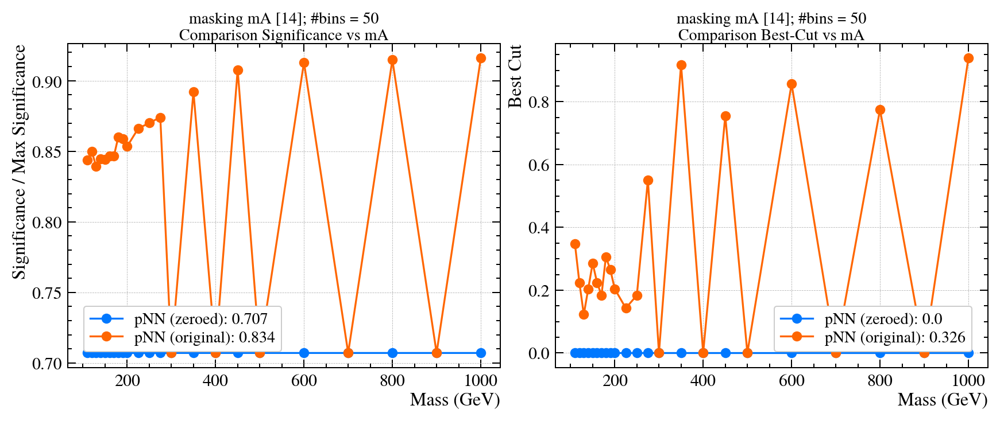

In [9]:
original = utils.get_compiled_pnn(data)
utils.load_from_checkpoint(original, path='benchmark/interp/pnn-uniform-fixed-naive')

for i, var in enumerate(data.columns['feature'] + ['mA']):
    model = utils.get_compiled_pnn(data)
    utils.load_from_checkpoint(model, path='benchmark/interp/pnn-uniform-fixed-naive')

    mask_dense_pnn(model, feature_index=i)

    models = {'pNN (zeroed)': model, 'pNN (original)': original}
    cms.plot.significance_ratio_vs_mass(test, models, bins=50, title=f'masking {var} [{i}]')

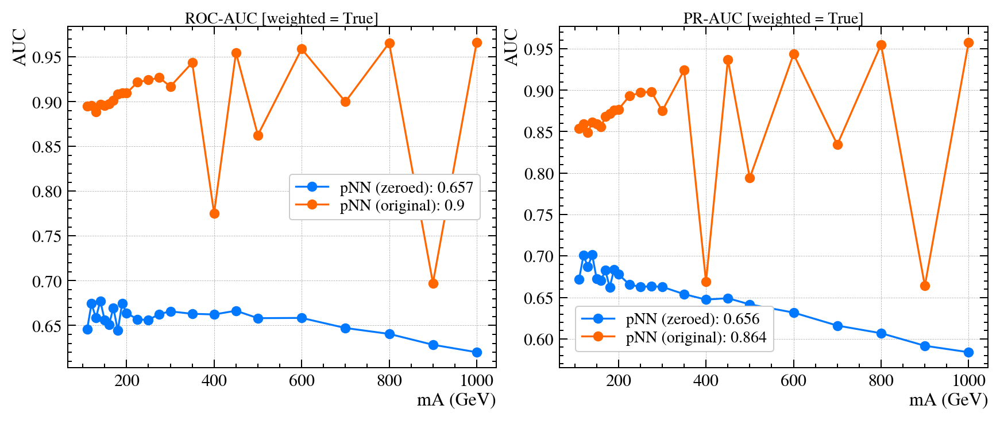

In [94]:
ax1, ax2 = utils.get_plot_axes(rows=1, cols=2)

cms.plot.auc_vs_mass(test, models, ax=ax1, which='ROC')
cms.plot.auc_vs_mass(test, models, ax=ax2, which='PR')

plt.tight_layout()
plt.show()